In [15]:
# train a generative adversarial network on a one-dimensional function
from numpy import hstack
from numpy import zeros
from numpy import ones
from numpy.random import rand
from numpy.random import randn
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Dropout
from matplotlib import pyplot
import requests
import json
import random
import os
import sys
import importlib
import numpy as np
import matplotlib.pyplot as plt


from bs4 import BeautifulSoup


In [2]:
#deck to vector conversion updated for the new json dictionnary
#New: Testing

file = open("data.json", "r")

cards = json.load(file)

#removes hero classes from json
def remove_impurities(cards):
    i = 0
    j = 0
    fixed = 0
    to_del = []
    for card in cards:
        if 'cost' in card:
            i+=1
        else:
            to_del.append(card)
            print('Removed:', card['name'])
            j +=1
        if card['playerClass'] == 'Neutral' and 'classes' in card:
            card['playerClass'] = card['classes'][0]
            fixed += 1
            print('Fixed playerClass of ', card['name'], ' from Neutral to ', card['classes'][0])
    for elem in to_del:
        cards.remove(elem)
    print('Number of impurities removed: ', j, '/', i+j)
    print('Number of card impurities fixed: ', fixed)
    return cards

def sortby_alphabetical_cost(cards):
    sorted_list = sorted(cards, key=lambda i: (i['cost'],i['name']))
    return reset_index(sorted_list)

def reset_index(cards):
    i=0
    for card in cards:
        card['id'] = i
        i+=1
    return cards

cards = remove_impurities(cards)
cards = sortby_alphabetical_cost(cards)

deck_vector = [32,64,98,1000,1250,1,2,4,5,70,97,12,67,98,33,33,43,54,76,27,65,43,78,32,78,96,12,10,32,6]
deck_vector_2 = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15]

def deck_to_vector(deck_cards):
    vect = []
    for elem in deck_cards:
        #print(elem['id'])
        vect.append(elem['id'])
        #print(elem)
        #print(elem in cards)
        #vect.append(cards[elem['id']]['id'])
    return vect
    
def vector_to_deck(deck_vector,cards=cards):
    deck = []
    for elem in deck_vector:
        deck.append(cards[elem-1])
    return deck


deck = vector_to_deck(deck_vector)
deck_vector = deck_to_vector(deck)

print(deck[0])
#print(deck_vector)
#res = vector_to_deck(deck_vector_2)
#print(res)
#print(deck_to_vector(res))



Fixed playerClass of  Guidance  from Neutral to  Druid
Fixed playerClass of  Nitroboost Poison  from Neutral to  Rogue
Fixed playerClass of  Resizing Pouch  from Neutral to  Druid
Fixed playerClass of  Felfire Deadeye  from Neutral to  Hunter
Fixed playerClass of  Imprisoned Phoenix  from Neutral to  Mage
Fixed playerClass of  Hysteria  from Neutral to  Priest
Fixed playerClass of  Luckysoul Hoarder  from Neutral to  Warlock
Fixed playerClass of  Barricade  from Neutral to  Paladin
Fixed playerClass of  Rally!  from Neutral to  Paladin
Fixed playerClass of  Keywarden Ivory  from Neutral to  Mage
Removed: Anduin Wrynn
Removed: Garrosh Hellscream
Removed: Gul'dan
Removed: Illidan Stormrage
Removed: Jaina Proudmoore
Removed: Malfurion Stormrage
Removed: Rexxar
Removed: Thrall
Removed: Uther Lightbringer
Removed: Valeera Sanguinar
Number of impurities removed:  10 / 1299
Number of card impurities fixed:  10
{'cardId': 'DRG_106', 'dbfId': '54906', 'name': 'Arcane Breath', 'cardSet': 'Descen

In [3]:
import numpy as np
import pandas as pd

def concatenate_deck_class(decks, classes):
    concatenated_result = []
    for i in range(len(decks)):
        concatenated_result.append([decks[i],classes[i]])
    return concatenated_result

def read_vector_decks(file):
    df = pd.read_csv(file)
    cards_from_csv = df['cards']
    converted_decks = []
    for cards in cards_from_csv:
        if len(deck) == 30: #len(cards)
            deck_to_convert = []
            cards = cards.strip("[]")
            cards = cards.split(", ")
            for card in cards:
                if card == '':
                    continue
                deck_to_convert.append(int(card)-1)
            converted_decks.append(vector_to_deck(deck_to_convert)) #np.asarray
            class_from_csv = df['class']
            final = concatenate_deck_class(converted_decks, class_from_csv)
    return final
            

deck_list = read_vector_decks("collected_decks_vectored_Warrior.csv")

def read_json_decks(file):
    file = open(file, "r")
    deck_list = json.load(file)
    cleaned_deck_list = []
    for deck in deck_list:
        if len(deck) == 30:
            cleaned_deck_list.append(deck)
    return cleaned_deck_list

deck_list = read_json_decks('data_Warrior.json')


deck_list[0]

[{'cardId': 'BT_121',
  'dbfId': '56508',
  'name': "Imprisoned Gan'arg",
  'cardSet': 'Ashes of Outland',
  'type': 'Minion',
  'rarity': 'Common',
  'cost': 1,
  'attack': 2,
  'health': 2,
  'text': '<b>Dormant</b> for 2 turns.\\nWhen this awakens,\\nequip a 3/2 Axe.',
  'flavor': 'Factory Direct Fiery War Axe. Please allow two turns for delivery.',
  'artist': 'Ivan Fomin',
  'collectible': True,
  'race': 'Demon',
  'playerClass': 'Warrior',
  'img': 'https://d15f34w2p8l1cc.cloudfront.net/hearthstone/b5d2910686d797f3e762ccb4159599e227d594a9d7e5dad864fee508fb259bb9.png',
  'locale': 'enUS',
  'id': 332},
 {'cardId': 'BT_121',
  'dbfId': '56508',
  'name': "Imprisoned Gan'arg",
  'cardSet': 'Ashes of Outland',
  'type': 'Minion',
  'rarity': 'Common',
  'cost': 1,
  'attack': 2,
  'health': 2,
  'text': '<b>Dormant</b> for 2 turns.\\nWhen this awakens,\\nequip a 3/2 Axe.',
  'flavor': 'Factory Direct Fiery War Axe. Please allow two turns for delivery.',
  'artist': 'Ivan Fomin',
  '

In [4]:
#try to get the weights from the generator and use those in random.choices()
#New: testing
import random

def sort_by_class(cl, cards):
    class_cards = []
    for card in cards:
        #check for multiclass cards
        if 'classes' in card and cl in card['classes']:
            #print(card['name'])
            for class_ in card['classes']:
                class_cards.append(card)
        else: 
            if card['playerClass'] == cl: #or card['playerClass'] == 'Neutral' if I want to add Neutrals
                class_cards.append(card)
    return class_cards

#I use 2 separate decks to increase the chances that a class card is picked otherwise there would be an imbalanced dataset
def generate_fake_deck(class_cards, neutral_cards):
    deck = []
    for i in range(30):
        x = random.randint(1,2)
        #print(x)
        if(x % 2 == 0):
            deck.append(random.choice(class_cards))
        else:
            deck.append(random.choice(neutral_cards))
    return deck_to_vector(deck)

class_cards = sort_by_class('Hunter', cards)
neutral_cards = sort_by_class('Neutral', cards)

fake_deck = generate_fake_deck(class_cards,neutral_cards) 

#print([x['name'] for x in fake_deck])
vec = [x for x in fake_deck]
print(vec)
d_vec = vector_to_deck(vec)
print([x['name'] for x in d_vec])
#print(deck_to_vector(fake_deck))

[1265, 440, 303, 921, 890, 40, 421, 317, 545, 1017, 180, 881, 846, 646, 1206, 318, 527, 149, 969, 1206, 27, 310, 749, 946, 55, 963, 92, 465, 214, 197]
['Ysiel Windsinger', 'Swindle', 'Freezing Trap', 'Chaos Nova', 'Wretched Tutor', 'Beaming Sidekick', 'Snake Trap', 'Holy Ripple', 'Eye Beam', 'Sunreaver Warmage', 'Southsea Deckhand', 'Vilefiend Trainer', 'Scion of Ruin', 'Raid Leader', 'Gruul', 'Horrendous Growth', 'Desert Spear', 'Rain of Fire', 'Keywarden Ivory', 'Gruul', 'Activate the Obelisk', 'Grandmummy', "Dr. Boom's Scheme", 'Envoy Rustwix', 'Claw', 'Harrison Jones', 'Goldshire Footman', 'Zephrys the Great', 'Wicked Whispers', 'Toxfin']


In [5]:
deck_list[0]

[{'cardId': 'BT_121',
  'dbfId': '56508',
  'name': "Imprisoned Gan'arg",
  'cardSet': 'Ashes of Outland',
  'type': 'Minion',
  'rarity': 'Common',
  'cost': 1,
  'attack': 2,
  'health': 2,
  'text': '<b>Dormant</b> for 2 turns.\\nWhen this awakens,\\nequip a 3/2 Axe.',
  'flavor': 'Factory Direct Fiery War Axe. Please allow two turns for delivery.',
  'artist': 'Ivan Fomin',
  'collectible': True,
  'race': 'Demon',
  'playerClass': 'Warrior',
  'img': 'https://d15f34w2p8l1cc.cloudfront.net/hearthstone/b5d2910686d797f3e762ccb4159599e227d594a9d7e5dad864fee508fb259bb9.png',
  'locale': 'enUS',
  'id': 332},
 {'cardId': 'BT_121',
  'dbfId': '56508',
  'name': "Imprisoned Gan'arg",
  'cardSet': 'Ashes of Outland',
  'type': 'Minion',
  'rarity': 'Common',
  'cost': 1,
  'attack': 2,
  'health': 2,
  'text': '<b>Dormant</b> for 2 turns.\\nWhen this awakens,\\nequip a 3/2 Axe.',
  'flavor': 'Factory Direct Fiery War Axe. Please allow two turns for delivery.',
  'artist': 'Ivan Fomin',
  '

In [7]:
import copy


def groupby_cost(cards):
    sorted_list = sorted(cards, key=lambda i: i['cost'])
    return sorted_list    

def groupby_class(classes, cards):
    sorted_deck = []
    for class_ in classes:
        class_deck = sort_by_class(class_, cards)
        class_deck = groupby_cost(class_deck)
        sorted_deck.extend(class_deck)
       # print(sorted_deck)
    return sorted_deck

#reID's everything after card limitation
def limit_card_range(cards, new_deck_list, classes):
    new_cards = groupby_class(classes, cards)
   # print(new_cards[0]['id'])
    i=0
    for card in new_cards:
        card['id'] = i
        i+=1
    #new_deck_list = deck_list.copy()
    #print(new_cards[0]['id'])
    for deck in new_deck_list:
        print([x['name'] for x in deck])
        for card in deck:
            print(card['name'], card['id'])
            temp = next((new_card for new_card in new_cards if new_card['name'] == card['name']), None)
            if(temp != None):
                print(temp['name'], temp['id'])
                card['id'] = temp['id']
            
    return new_cards, new_deck_list

new_deck_list = copy.deepcopy(deck_list)
new_cards = copy.deepcopy(cards)

new_cards, new_deck_list = limit_card_range(new_cards, new_deck_list, ['Warrior', 'Neutral'])

print('Card id: ', cards[0]['id'], new_cards[0]['id'])

#print([x['id'] for x in new_deck_list[0]])
print('Deck list: \n', [x['name'] for x in deck_list[0]],'\n', [x['name'] for x in new_deck_list[0]])
print('Deck id: \n', [x['id'] for x in deck_list[0]],'\n',[x['id'] for x in new_deck_list[0]] )
print(len(cards), len(new_cards))
print(cards[10]['name'], new_cards[10]['name'])

["Imprisoned Gan'arg", "Imprisoned Gan'arg", 'Nitroboost Poison', 'Nitroboost Poison', 'Sky Raider', 'Sky Raider', 'Upgrade!', 'Upgrade!', 'Ancharrr', 'Frothing Berserker', 'Frothing Berserker', 'Skybarge', 'Skybarge', "Kor'kron Elite", "Kor'kron Elite", 'Sword Eater', 'Sword Eater', 'Cutting Class', 'Cutting Class', 'Doctor Krastinov', 'Ringmaster Whatley', 'Tent Trasher', 'Tent Trasher', 'Southsea Deckhand', 'Southsea Deckhand', 'Parachute Brigand', 'Parachute Brigand', 'Dread Corsair', 'Dread Corsair', 'Captain Greenskin']
Imprisoned Gan'arg 332
Imprisoned Gan'arg 5
Imprisoned Gan'arg 332
Imprisoned Gan'arg 5
Nitroboost Poison 6
Nitroboost Poison 9
Nitroboost Poison 6
Nitroboost Poison 9
Sky Raider 513
Sky Raider 14
Sky Raider 513
Sky Raider 14
Upgrade! 942
Upgrade! 18
Upgrade! 942
Upgrade! 18
Ancharrr 536
Ancharrr 40
Frothing Berserker 1013
Frothing Berserker 55
Frothing Berserker 1013
Frothing Berserker 55
Skybarge 558
Skybarge 63
Skybarge 558
Skybarge 63
Kor'kron Elite 1256
Kor'k

Armor Vendor 113
Armor Vendor 0
Armor Vendor 113
Circus Amalgam 102
Circus Amalgam 302
Circus Amalgam 102
Circus Amalgam 302
Moonfang 133
Moonfang 381
Claw Machine 140
Claw Machine 410
Claw Machine 140
Claw Machine 410
Runaway Blackwing 164
Runaway Blackwing 479
Runaway Blackwing 164
Runaway Blackwing 479
C'Thun, the Shattered 165
C'Thun, the Shattered 483
N'Zoth, God of the Deep 167
N'Zoth, God of the Deep 489
["Imprisoned Gan'arg", "Imprisoned Gan'arg", 'Nitroboost Poison', 'Nitroboost Poison', 'Spiked Wheel', 'Spiked Wheel', 'Upgrade!', 'Upgrade!', 'Corsair Cache', 'Heroic Strike', 'Heroic Strike', 'Sword Eater', 'Sword Eater', 'Cutting Class', 'Cutting Class', 'Doctor Krastinov', 'Galakrond, the Unbreakable', 'Southsea Deckhand', 'Southsea Deckhand', 'Bloodsail Raider', 'Bloodsail Raider', 'Devoted Maniac', 'Devoted Maniac', 'Dread Corsair', 'Dread Corsair', 'Hoard Pillager', 'Hoard Pillager', 'Shield of Galakrond', 'Shield of Galakrond', 'Kronx Dragonhoof']
Imprisoned Gan'arg 332


Shield Slam 938
Shield Slam 11
Shield Slam 938
Shield Slam 11
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Ritual Chopper 530
Ritual Chopper 35
Ritual Chopper 530
Ritual Chopper 35
Ancharrr 536
Ancharrr 40
Awaken! 537
Awaken! 41
Awaken! 537
Awaken! 41
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bomb Wrangler 475
Bomb Wrangler 44
Bomb Wrangler 475
Bomb Wrangler 44
Lord Barov 229
Lord Barov 59
Shield Block 1239
Shield Block 62
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Scion of Ruin 575
Scion of Ruin 77
Scion of Ruin 575
Scion of Ruin 77
Sword Eater 117
Sword Eater 80
Sword Eater 117
Sword Eater 80
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Devoted Maniac 562
Devoted Maniac 309
Devoted Maniac 562
Devoted Maniac 309
Shield of Galakrond 598
Shield of Galakrond 390
Shield of Galakrond 598
Shield of Galakrond 390
Kronx Dragonhoof 612
Kronx Drago

Rattlegore 104
Ironbeak Owl 1019
Ironbeak Owl 262
Sky Gen'ral Kragg 483
Sky Gen'ral Kragg 341
Kobold Stickyfinger 593
Kobold Stickyfinger 378
Archivist Elysiana 897
Archivist Elysiana 472
N'Zoth, God of the Deep 167
N'Zoth, God of the Deep 489
['Risky Skipper', 'Sky Raider', 'Stage Dive', 'Sword and Board', 'Armorsmith', 'Corsair Cache', 'Frightened Flunky', 'Minefield', 'Ancharrr', 'Bladestorm', 'Bulwark of Azzinoth', 'Coerce', 'EVIL Quartermaster', 'Livewire Lance', 'Lord Barov', 'Shield Block', 'Kargath Bladefist', "Reaper's Scythe", 'Sword Eater', 'Brawl', 'Cutting Class', 'Ringmaster Whatley', 'Deathwing, Mad Aspect', 'Acidic Swamp Ooze', 'Zephrys the Great', 'Kobold Stickyfinger', 'Claw Machine', 'Silas Darkmoon', 'Dragonqueen Alexstrasza', "C'Thun, the Shattered"]
Risky Skipper 463
Risky Skipper 10
Sky Raider 513
Sky Raider 14
Stage Dive 13
Stage Dive 16
Sword and Board 342
Sword and Board 17
Armorsmith 950
Armorsmith 20
Corsair Cache 350
Corsair Cache 25
Frightened Flunky 666
F

Stage Dive 16
Upgrade! 942
Upgrade! 18
Upgrade! 942
Upgrade! 18
Bumper Car 17
Bumper Car 22
Bumper Car 17
Bumper Car 22
E.T.C., God of Metal 27
E.T.C., God of Metal 27
Heroic Strike 1203
Heroic Strike 30
Heroic Strike 1203
Heroic Strike 30
Ringmaster's Baton 44
Ringmaster's Baton 34
Ringmaster's Baton 44
Ringmaster's Baton 34
Ancharrr 536
Ancharrr 40
Skybarge 558
Skybarge 63
Skybarge 558
Skybarge 63
Mortal Strike 1065
Mortal Strike 73
Mortal Strike 1065
Mortal Strike 73
Sword Eater 117
Sword Eater 80
Ringmaster Whatley 135
Ringmaster Whatley 89
Animated Broomstick 175
Animated Broomstick 111
Animated Broomstick 175
Animated Broomstick 111
Southsea Deckhand 940
Southsea Deckhand 141
Southsea Deckhand 940
Southsea Deckhand 141
Faerie Dragon 965
Faerie Dragon 171
Faerie Dragon 965
Faerie Dragon 171
Parachute Brigand 528
Parachute Brigand 197
Parachute Brigand 528
Parachute Brigand 197
Southsea Captain 1036
Southsea Captain 284
Southsea Captain 1036
Southsea Captain 284
['Risky Skipper', '

Sword Eater 117
Sword Eater 80
Sword Eater 117
Sword Eater 80
Cutting Class 265
Cutting Class 85
Cutting Class 265
Cutting Class 85
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Rattlegore 303
Rattlegore 104
Animated Broomstick 175
Animated Broomstick 111
Animated Broomstick 175
Animated Broomstick 111
['Risky Skipper', 'Risky Skipper', 'Shield Slam', 'Shield Slam', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Minefield', 'Minefield', 'Bladestorm', 'Bladestorm', 'Bulwark of Azzinoth', 'Coerce', 'EVIL Quartermaster', 'EVIL Quartermaster', 'Lord Barov', 'Shield Block', 'Shield Block', 'Kargath Bladefist', 'Sword Eater', 'Sword Eater', 'Wrenchcalibur', 'Brawl', 'Brawl', 'Deathwing, Mad Aspect', 'Rattlegore', "C'Thun, the Shattered", 'Yogg-Saron, Master of Fate']
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Shield Slam 938
Shield Slam 11
Shield Slam 938
Shield Slam 11
Armorsmith 950
Armorsmith 20
Armors

Sword Eater 80
Sword Eater 117
Sword Eater 80
Scrap Golem 429
Scrap Golem 90
Scrap Golem 429
Scrap Golem 90
Armagedillo 741
Armagedillo 92
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Tomb Warden 761
Tomb Warden 102
Tomb Warden 761
Tomb Warden 102
Injured Tol'vir 669
Injured Tol'vir 178
Circus Amalgam 102
Circus Amalgam 302
Circus Amalgam 102
Circus Amalgam 302
N'Zoth, God of the Deep 167
N'Zoth, God of the Deep 489
['Risky Skipper', 'Risky Skipper', 'Shield Slam', 'Shield Slam', 'Sword and Board', 'Sword and Board', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Minefield', 'Minefield', 'Ancharrr', 'Bladestorm', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'Bulwark of Azzinoth', 'EVIL Quartermaster', 'EVIL Quartermaster', 'Lord Barov', 'Shield Block', 'Shield Block', 'Kargath Bladefist', 'Sword Eater', 'Sword Eater', 'Brawl', 'Brawl', 'Deathwing, Mad Aspect', 'Rattlegore']
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Shie

Athletic Studies 176
Athletic Studies 1
Sky Raider 513
Sky Raider 14
Stage Dive 13
Stage Dive 16
Corsair Cache 350
Corsair Cache 25
Ringmaster's Baton 44
Ringmaster's Baton 34
Bladestorm 379
Bladestorm 42
Coerce 221
Coerce 51
EVIL Quartermaster 547
EVIL Quartermaster 52
Shield Block 1239
Shield Block 62
Kargath Bladefist 407
Kargath Bladefist 70
Sword Eater 117
Sword Eater 80
Wrenchcalibur 853
Wrenchcalibur 81
Brawl 1079
Brawl 83
Doctor Krastinov 266
Doctor Krastinov 87
Ringmaster Whatley 135
Ringmaster Whatley 89
Scrap Golem 429
Scrap Golem 90
Tent Trasher 136
Tent Trasher 91
Armagedillo 741
Armagedillo 92
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Tomb Warden 761
Tomb Warden 102
Troublemaker 300
Troublemaker 103
Zephrys the Great 686
Zephrys the Great 224
Circus Amalgam 102
Circus Amalgam 302
Fishy Flyer 248
Fishy Flyer 319
Hoard Pillager 571
Hoard Pillager 327
Claw Machine 140
Claw Machine 410
Siamat 754
Siamat 450
Strongman 153
Strongman 453
Dragonqueen Alexstrasza 632
Dra

Into the Fray 643
Into the Fray 7
Frightened Flunky 666
Frightened Flunky 29
Frightened Flunky 666
Frightened Flunky 29
In Formation! 208
In Formation! 31
In Formation! 208
In Formation! 31
Ritual Chopper 530
Ritual Chopper 35
Ritual Chopper 530
Ritual Chopper 35
Awaken! 537
Awaken! 41
Awaken! 537
Awaken! 41
Coerce 221
Coerce 51
Coerce 221
Coerce 51
Sword Eater 117
Sword Eater 80
Sword Eater 117
Sword Eater 80
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Scrap Golem 429
Scrap Golem 90
Scrap Golem 429
Scrap Golem 90
Armagedillo 741
Armagedillo 92
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
The Boom Reaver 905
The Boom Reaver 106
Shield of Galakrond 598
Shield of Galakrond 390
Shield of Galakrond 598
Shield of Galakrond 390
Khartut Defender 745
Khartut Defender 418
Khartut Defender 745
Khartut Defender 418
Kronx Dragonhoof 612
Kronx Dragonhoof 419
Carnival Clown 162
Carnival Clown 474
Carnival Clown 162
Carnival Clown 474
Scrapyard Colossus 459
Scrapyard Colossus 490
Scrapyar

Hoard Pillager 327
Shield of Galakrond 598
Shield of Galakrond 390
Evasive Wyrm 609
Evasive Wyrm 413
Gyrocopter 611
Gyrocopter 416
Kronx Dragonhoof 612
Kronx Dragonhoof 419
Siamat 754
Siamat 450
Carnival Clown 162
Carnival Clown 474
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 475
N'Zoth, God of the Deep 167
N'Zoth, God of the Deep 489
Scrapyard Colossus 459
Scrapyard Colossus 490
['Into the Fray', 'Into the Fray', 'Upgrade!', 'Upgrade!', 'Corsair Cache', 'Corsair Cache', 'Frightened Flunky', 'Frightened Flunky', 'In Formation!', 'In Formation!', "Ringmaster's Baton", "Ringmaster's Baton", 'Doctor Krastinov', 'Ringmaster Whatley', 'Scrap Golem', 'Tent Trasher', 'Tent Trasher', 'Armagedillo', 'Tomb Warden', 'Tomb Warden', 'Infested Goblin', 'Infested Goblin', 'Circus Amalgam', 'Circus Amalgam', 'Dread Corsair', 'Dread Corsair', 'Hoard Pillager', 'Captain Greenskin', "N'Zoth, God of the Deep", 'Scrapyard Colossus']
Into the Fray 643
Into the Fray 7
Into the Fray 643
Into the Fray 

Rattlegore 303
Rattlegore 104
C'Thun, the Shattered 165
C'Thun, the Shattered 483
Yogg-Saron, Master of Fate 169
Yogg-Saron, Master of Fate 493
['Into the Fray', 'Into the Fray', 'Frightened Flunky', 'Frightened Flunky', 'In Formation!', 'In Formation!', 'Minefield', 'Minefield', 'Coerce', 'Coerce', 'Kargath Bladefist', 'Sword Eater', 'Sword Eater', 'Brawl', 'Brawl', 'Ringmaster Whatley', 'Scrap Golem', 'Scrap Golem', 'Armagedillo', 'Deathwing, Mad Aspect', 'Bonechewer Brawler', 'Bonechewer Brawler', 'Circus Amalgam', 'Strongman', 'Strongman', 'Carnival Clown', 'Carnival Clown', "N'Zoth, God of the Deep", 'Scrapyard Colossus', 'Scrapyard Colossus']
Into the Fray 643
Into the Fray 7
Into the Fray 643
Into the Fray 7
Frightened Flunky 666
Frightened Flunky 29
Frightened Flunky 666
Frightened Flunky 29
In Formation! 208
In Formation! 31
In Formation! 208
In Formation! 31
Minefield 38
Minefield 32
Minefield 38
Minefield 32
Coerce 221
Coerce 51
Coerce 221
Coerce 51
Kargath Bladefist 407
Kar

Circus Amalgam 302
['Athletic Studies', 'Athletic Studies', 'Risky Skipper', 'Risky Skipper', 'Shield Slam', 'Shield Slam', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'E.T.C., God of Metal', 'Ancharrr', 'Bladestorm', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'EVIL Quartermaster', 'EVIL Quartermaster', 'Shield Block', 'Shield Block', 'Sword Eater', 'Sword Eater', 'Brawl', 'Brawl', 'Cutting Class', 'Galakrond, the Unbreakable', 'Troublemaker', 'Troublemaker', 'Animated Broomstick', 'Animated Broomstick', 'Pen Flinger']
Athletic Studies 176
Athletic Studies 1
Athletic Studies 176
Athletic Studies 1
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Shield Slam 938
Shield Slam 11
Shield Slam 938
Shield Slam 11
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Battle Rage 951
Battle Rage 21
E.T.C., God of Metal 27
E.T.C., God of Metal 27
Ancharrr 536
Ancharrr 40
Bladestorm 379
Bladestorm 42
Bloodsworn Mercenary 6

Mortal Strike 1065
Mortal Strike 73
Sword Eater 117
Sword Eater 80
Sword Eater 117
Sword Eater 80
Southsea Deckhand 940
Southsea Deckhand 141
Southsea Deckhand 940
Southsea Deckhand 141
Bloodsail Raider 954
Bloodsail Raider 156
Bloodsail Raider 954
Bloodsail Raider 156
Parachute Brigand 528
Parachute Brigand 197
Parachute Brigand 528
Parachute Brigand 197
Voracious Reader 241
Voracious Reader 291
Voracious Reader 241
Voracious Reader 291
Dread Corsair 1055
Dread Corsair 314
Dread Corsair 1055
Dread Corsair 314
Knife Vendor 110
Knife Vendor 328
Captain Greenskin 1080
Captain Greenskin 361
['Inner Rage', 'Shield Slam', 'Shield Slam', 'Stage Dive', 'Corsair Cache', 'Corsair Cache', 'E.T.C., God of Metal', "Ringmaster's Baton", 'Bladestorm', 'Bladestorm', 'Bloodsworn Mercenary', 'Clockwork Goblin', 'Clockwork Goblin', 'Shield Block', 'Shield Block', 'Sword Eater', 'Sword Eater', 'Wrenchcalibur', 'Wrenchcalibur', 'Brawl', 'Brawl', 'Cutting Class', 'Cutting Class', 'Doctor Krastinov', 'Ringm

Shield of Galakrond 390
Shield of Galakrond 598
Shield of Galakrond 390
Evasive Wyrm 609
Evasive Wyrm 413
Evasive Wyrm 609
Evasive Wyrm 413
N'Zoth, God of the Deep 167
N'Zoth, God of the Deep 489
['Shield Slam', 'Shield Slam', 'Frightened Flunky', 'Frightened Flunky', 'Minefield', 'Minefield', "Ringmaster's Baton", "Ringmaster's Baton", 'Bladestorm', 'Coerce', 'Coerce', 'Ramming Speed', 'Ramming Speed', 'Shield Block', 'Shield Block', 'Sword Eater', 'Sword Eater', 'Brawl', 'Ringmaster Whatley', 'Scrap Golem', 'Scrap Golem', 'Tent Trasher', 'Tent Trasher', 'Armagedillo', 'Deathwing, Mad Aspect', 'Circus Amalgam', 'Circus Amalgam', "N'Zoth, God of the Deep", 'Scrapyard Colossus', 'Scrapyard Colossus']
Shield Slam 938
Shield Slam 11
Shield Slam 938
Shield Slam 11
Frightened Flunky 666
Frightened Flunky 29
Frightened Flunky 666
Frightened Flunky 29
Minefield 38
Minefield 32
Minefield 38
Minefield 32
Ringmaster's Baton 44
Ringmaster's Baton 34
Ringmaster's Baton 44
Ringmaster's Baton 34
Bla

Sky Raider 14
Sky Raider 513
Sky Raider 14
Stage Dive 13
Stage Dive 16
Upgrade! 942
Upgrade! 18
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Bumper Car 17
Bumper Car 22
Bumper Car 17
Bumper Car 22
Corsair Cache 350
Corsair Cache 25
Ringmaster's Baton 44
Ringmaster's Baton 34
Ringmaster's Baton 44
Ringmaster's Baton 34
Stage Hand 51
Stage Hand 37
Stage Hand 51
Stage Hand 37
Ancharrr 536
Ancharrr 40
Livewire Lance 701
Livewire Lance 57
Lord Barov 229
Lord Barov 59
Skybarge 558
Skybarge 63
Skybarge 558
Skybarge 63
Kargath Bladefist 407
Kargath Bladefist 70
Sword Eater 117
Sword Eater 80
Sword Eater 117
Sword Eater 80
Ringmaster Whatley 135
Ringmaster Whatley 89
Tent Trasher 136
Tent Trasher 91
Tent Trasher 136
Tent Trasher 91
Crimson Hothead 245
Crimson Hothead 305
Captain Greenskin 1080
Captain Greenskin 361
['Athletic Studies', 'Boom Squad', 'Sword and Board', 'Execute', 'Slam', 'Bladestorm', 'Bonechewer Raider', 'Coerce', 'EVIL Quartermaster', 'Livewire Lance', 'Lord Barov

Ancharrr 536
Ancharrr 40
Skybarge 558
Skybarge 63
Skybarge 558
Skybarge 63
Sword Eater 117
Sword Eater 80
Sword Eater 117
Sword Eater 80
Doctor Krastinov 266
Doctor Krastinov 87
Ringmaster Whatley 135
Ringmaster Whatley 89
Tent Trasher 136
Tent Trasher 91
Tent Trasher 136
Tent Trasher 91
Animated Broomstick 175
Animated Broomstick 111
Southsea Deckhand 940
Southsea Deckhand 141
Southsea Deckhand 940
Southsea Deckhand 141
Southsea Captain 1036
Southsea Captain 284
Southsea Captain 1036
Southsea Captain 284
Circus Amalgam 102
Circus Amalgam 302
Circus Amalgam 102
Circus Amalgam 302
Captain Greenskin 1080
Captain Greenskin 361
Derailed Coaster 122
Derailed Coaster 366
Derailed Coaster 122
Derailed Coaster 366
['Stage Dive', 'Stage Dive', 'Armorsmith', 'Armorsmith', 'Frightened Flunky', 'Frightened Flunky', "Ringmaster's Baton", "Ringmaster's Baton", 'Ritual Chopper', 'Ritual Chopper', 'Awaken!', 'Awaken!', 'Scion of Ruin', 'Scion of Ruin', 'Sword Eater', 'Sword Eater', 'Doctor Krastinov',

Brawl 1079
Brawl 83
Ringmaster Whatley 135
Ringmaster Whatley 89
Tent Trasher 136
Tent Trasher 91
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Animated Broomstick 175
Animated Broomstick 111
Tasty Flyfish 533
Tasty Flyfish 213
Zephrys the Great 686
Zephrys the Great 224
Circus Amalgam 102
Circus Amalgam 302
Escaped Manasaber 480
Escaped Manasaber 315
Fishy Flyer 248
Fishy Flyer 319
Hoard Pillager 571
Hoard Pillager 327
Fleethoof Pearltusk 125
Fleethoof Pearltusk 372
Claw Machine 140
Claw Machine 410
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 475
N'Zoth, God of the Deep 167
N'Zoth, God of the Deep 489
Scrapyard Colossus 459
Scrapyard Colossus 490
['Sky Raider', 'Sky Raider', 'Stage Dive', 'Stage Dive', 'Bumper Car', 'Bumper Car', 'E.T.C., God of Metal', 'Minefield', 'Minefield', "Ringmaster's Baton", "Ringmaster's Baton", 'Stage Hand', 'Stage Hand', 'Coerce', 'Coerce', 'Kargath Bladefist', 'Restless Mummy', 'Restless Mummy', 'Ringmaster Whatley', 'Tent Trasher', 'Tent Tr

Devoted Maniac 562
Devoted Maniac 309
Devoted Maniac 562
Devoted Maniac 309
Shield of Galakrond 598
Shield of Galakrond 390
Shield of Galakrond 598
Shield of Galakrond 390
Kronx Dragonhoof 612
Kronx Dragonhoof 419
['Risky Skipper', 'Risky Skipper', 'Shield Slam', 'Shield Slam', 'Sword and Board', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Ancharrr', 'Bladestorm', 'Bladestorm', 'Bloodsworn Mercenary', 'Coerce', 'EVIL Quartermaster', 'EVIL Quartermaster', 'Lord Barov', 'Shield Block', 'Shield Block', 'Kargath Bladefist', 'Brawl', 'Brawl', 'Bloodboil Brute', 'Bloodboil Brute', 'Deathwing, Mad Aspect', 'Soulbound Ashtongue', 'Doomsayer', 'Zephrys the Great', 'Kobold Stickyfinger', 'Silas Darkmoon']
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Shield Slam 938
Shield Slam 11
Shield Slam 938
Shield Slam 11
Sword and Board 342
Sword and Board 17
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Battle Rage 951
Batt

Inner Rage 907
Inner Rage 0
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Shield of Honor 195
Shield of Honor 13
Shield of Honor 195
Shield of Honor 13
Sky Raider 513
Sky Raider 14
Sky Raider 513
Sky Raider 14
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Battle Rage 951
Battle Rage 21
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Rampage 985
Rampage 33
Ancharrr 536
Ancharrr 40
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bomb Wrangler 475
Bomb Wrangler 44
Bomb Wrangler 475
Bomb Wrangler 44
Livewire Lance 701
Livewire Lance 57
Livewire Lance 701
Livewire Lance 57
Lord Barov 229
Lord Barov 59
Warmaul Challenger 400
Warmaul Challenger 64
Warmaul Challenger 400
Warmaul Challenger 64
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Grommash Hell

Cutting Class 265
Cutting Class 85
Doctor Krastinov 266
Doctor Krastinov 87
Plague of Wrath 738
Plague of Wrath 88
Plague of Wrath 738
Plague of Wrath 88
Faceless Manipulator 1085
Faceless Manipulator 370
Faceless Manipulator 1085
Faceless Manipulator 370
Headmaster Kel'Thuzad 267
Headmaster Kel'Thuzad 377
Keymaster Alabaster 293
Keymaster Alabaster 447
Sathrovarr 633
Sathrovarr 480
['Athletic Studies', 'Risky Skipper', 'Shield Slam', 'Sword and Board', 'Armorsmith', 'Corsair Cache', 'Frightened Flunky', 'Ritual Chopper', 'Awaken!', 'Bladestorm', 'Bomb Wrangler', 'Bulwark of Azzinoth', 'Coerce', 'EVIL Quartermaster', 'Livewire Lance', 'Lord Barov', 'Ramming Speed', 'Shield Block', 'Kargath Bladefist', "Reaper's Scythe", 'Restless Mummy', 'Brawl', 'Galakrond, the Unbreakable', 'Deathwing, Mad Aspect', 'Troublemaker', 'Zephrys the Great', 'Devoted Maniac', 'Shield of Galakrond', 'Kronx Dragonhoof', 'Dragonqueen Alexstrasza']
Athletic Studies 176
Athletic Studies 1
Risky Skipper 463
Risky

Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Ancharrr 536
Ancharrr 40
Bladestorm 379
Bladestorm 42
Bladestorm 379
Bladestorm 42
EVIL Quartermaster 547
EVIL Quartermaster 52
EVIL Quartermaster 547
EVIL Quartermaster 52
Kargath Bladefist 407
Kargath Bladefist 70
Wrenchcalibur 853
Wrenchcalibur 81
Wrenchcalibur 853
Wrenchcalibur 81
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Cutting Class 265
Cutting Class 85
Cutting Class 265
Cutting Class 85
Doctor Krastinov 266
Doctor Krastinov 87
Armored Goon 742
Armored Goon 93
Armored Goon 742
Armored Goon 93
Blastmaster Boom 879
Blastmaster Boom 94
Hoard Pillager 571
Hoard Pillager 327
Hoard Pillager 571
Hoard Pillager 327
Sky Gen'ral Kragg 483
Sky Gen'ral Kragg 341
Captain Greenskin 1080
Captain Greenskin 361
["Imprisoned Gan'arg", "Imprisoned Gan'arg", 'Sky Raider', 'Sky Raider', 'Upgrade!', 'Upgrade!', 'Corsair Cache', 'Corsair Cache', 'Skybarge', 'Skybarge', "Kor'kron Elite", "Kor'kron Elite", "Reaper's Scythe", "Reaper's S

Ritual Chopper 530
Ritual Chopper 35
Ancharrr 536
Ancharrr 40
Awaken! 537
Awaken! 41
Awaken! 537
Awaken! 41
Lord Barov 229
Lord Barov 59
Skybarge 558
Skybarge 63
Skybarge 558
Skybarge 63
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Southsea Deckhand 940
Southsea Deckhand 141
Southsea Deckhand 940
Southsea Deckhand 141
Parachute Brigand 528
Parachute Brigand 197
Parachute Brigand 528
Parachute Brigand 197
Southsea Captain 1036
Southsea Captain 284
Southsea Captain 1036
Southsea Captain 284
Devoted Maniac 562
Devoted Maniac 309
Devoted Maniac 562
Devoted Maniac 309
Dread Corsair 1055
Dread Corsair 314
Dread Corsair 1055
Dread Corsair 314
Hoard Pillager 571
Hoard Pillager 327
Hoard Pillager 571
Hoard Pillager 327
Shield of Galakrond 598
Shield of Galakrond 390
Shield of Galakrond 598
Shield of Galakrond 390
Kronx Dragonhoof 612
Kronx Dragonhoof 419
['Athletic Studies', 'Athletic Studies', 'Upgrade!

Pen Flinger 192
Pen Flinger 134
Pen Flinger 192
Pen Flinger 134
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Ironbeak Owl 1019
Ironbeak Owl 262
Headmaster Kel'Thuzad 267
Headmaster Kel'Thuzad 377
['Hack the System', 'Sword and Board', 'Sword and Board', 'Upgrade!', 'Upgrade!', 'Corsair Cache', 'Corsair Cache', 'Ancharrr', 'Bladestorm', 'Bladestorm', 'Coerce', 'Livewire Lance', 'Livewire Lance', 'Shield Block', 'Shield Block', 'Kargath Bladefist', "Reaper's Scythe", 'Brawl', 'Brawl', 'Cutting Class', 'Cutting Class', 'Doctor Krastinov', 'Acidic Swamp Ooze', 'Questing Explorer', 'Questing Explorer', 'Dread Corsair', 'Dread Corsair', 'Hoard Pillager', "Sky Gen'ral Kragg", 'Captain Greenskin']
Hack the System 642
Hack the System 4
Sword and Board 342
Sword and Board 17
Sword and Board 342
Sword and Board 17
Upgrade! 942
Upgrade! 18
Upgrade! 942
Upgrade! 18
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Ancharrr 536
Ancharr

Brawl 1079
Brawl 83
Cutting Class 265
Cutting Class 85
Cutting Class 265
Cutting Class 85
Doctor Krastinov 266
Doctor Krastinov 87
Blastmaster Boom 879
Blastmaster Boom 94
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Hoard Pillager 571
Hoard Pillager 327
Hoard Pillager 571
Hoard Pillager 327
Captain Greenskin 1080
Captain Greenskin 361
['Risky Skipper', 'Risky Skipper', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Rampage', 'Rampage', 'Bladestorm', 'Bladestorm', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'Bomb Wrangler', 'Bomb Wrangler', 'Lord Barov', 'Shield Block', 'Shield Block', 'Restless Mummy', 'Restless Mummy', 'Guardian Augmerchant', 'Guardian Augmerchant', 'Potion Vendor', 'Potion Vendor', 'Bonechewer Brawler', 'Bonechewer Brawler', 'Spitting Camel', 'Gurubashi Berserker', 'Gurubashi Berserker', 'Underbelly Ooze', 'Underbelly Ooze']
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armors

Shield Block 1239
Shield Block 62
Kargath Bladefist 407
Kargath Bladefist 70
Reaper's Scythe 256
Reaper's Scythe 75
Reaper's Scythe 256
Reaper's Scythe 75
Restless Mummy 720
Restless Mummy 76
Restless Mummy 720
Restless Mummy 76
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Cutting Class 265
Cutting Class 85
Cutting Class 265
Cutting Class 85
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Troublemaker 300
Troublemaker 103
Troublemaker 300
Troublemaker 103
Magtheridon 409
Magtheridon 329
Headmaster Kel'Thuzad 267
Headmaster Kel'Thuzad 377
Kronx Dragonhoof 612
Kronx Dragonhoof 419
['Athletic Studies', 'Shield Slam', 'Shield Slam', 'Sword and Board', 'Sword and Board', 'Bladestorm', 'Bladestorm', 'Bulwark of Azzinoth', 'Coerce', 'Coerce', 'EVIL Quartermaster', 'EVIL Quartermaster', 'Lord Barov', 'Ramming Speed', 'Shield Block', 'Shield Block', 'Kargath Bladefist', "Reaper's Scythe", "Reaper's Scythe", 'Restless Mummy', 'Restless 

Restless Mummy 76
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Commencement 290
Commencement 97
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Troublemaker 300
Troublemaker 103
Troublemaker 300
Troublemaker 103
Rattlegore 303
Rattlegore 104
The Boom Reaver 905
The Boom Reaver 106
Ogremancer 272
Ogremancer 384
Shield of Galakrond 598
Shield of Galakrond 390
Shield of Galakrond 598
Shield of Galakrond 390
Kronx Dragonhoof 612
Kronx Dragonhoof 419
Smug Senior 288
Smug Senior 428
['Inner Rage', 'Inner Rage', 'Risky Skipper', 'Risky Skipper', 'Shield of Honor', 'Sky Raider', 'Sky Raider', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Corsair Cache', 'Rampage', 'Ancharrr', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'Bomb Wrangler', 'Bomb Wrangler', 'Lord Barov', 'Warmaul Challenger', 'Warmaul Challenger', "Kor'kron Elite", "Kor'kron Elite", "Reaper's Scythe", "Reaper's Scythe", 'Cutting Class', 'C

Bladestorm 379
Bladestorm 42
Coerce 221
Coerce 51
Coerce 221
Coerce 51
Lord Barov 229
Lord Barov 59
Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Kargath Bladefist 407
Kargath Bladefist 70
Reaper's Scythe 256
Reaper's Scythe 75
Reaper's Scythe 256
Reaper's Scythe 75
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Armagedillo 741
Armagedillo 92
Tomb Warden 761
Tomb Warden 102
Tomb Warden 761
Tomb Warden 102
Troublemaker 300
Troublemaker 103
Troublemaker 300
Troublemaker 103
Educated Elekk 223
Educated Elekk 243
Educated Elekk 223
Educated Elekk 243
Al'ar 420
Al'ar 354
Headmaster Kel'Thuzad 267
Headmaster Kel'Thuzad 377
Vectus 279
Vectus 400
Blatant Decoy 743
Blatant Decoy 406
Blatant Decoy 743
Blatant Decoy 406
Plagued Protodrake 298
Plagued Protodrake 466
Plagued Protodrake 298
Plagued Protodrake 466
['Athletic Studies', 'Whirlwind', 'Corsair Cache', 'Corsair Cache', 'Awaken!', 'Awaken!', 'Bladestorm', 'Bladestorm', 'Bulwark of Azzinoth', 'Coerce', 'Coerce', 'Lord Barov',

Athletic Studies 176
Athletic Studies 1
Sword and Board 342
Sword and Board 17
Sword and Board 342
Sword and Board 17
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Bladestorm 379
Bladestorm 42
Bladestorm 379
Bladestorm 42
Ceremonial Maul 220
Ceremonial Maul 48
Coerce 221
Coerce 51
Coerce 221
Coerce 51
Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Kargath Bladefist 407
Kargath Bladefist 70
Reaper's Scythe 256
Reaper's Scythe 75
Reaper's Scythe 256
Reaper's Scythe 75
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Cutting Class 265
Cutting Class 85
Cutting Class 265
Cutting Class 85
Commencement 290
Commencement 97
Commencement 290
Commencement 97
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Troublemaker 300
Troublemaker 103
Troublemaker 300
Troublemaker 103
Rattlegore 303
Rattlegore 104
Dimensional Ripper 901
Dimensional Ripper 105
Dimensional Ripper 901
Dimensional Ripper 105
Kael'thas Sunstrider 444
Kael'thas Sunstrider 446
Scrapyard Coloss

EVIL Quartermaster 547
EVIL Quartermaster 52
Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Kargath Bladefist 407
Kargath Bladefist 70
Reaper's Scythe 256
Reaper's Scythe 75
Reaper's Scythe 256
Reaper's Scythe 75
Brawl 1079
Brawl 83
Troublemaker 300
Troublemaker 103
Troublemaker 300
Troublemaker 103
Rattlegore 303
Rattlegore 104
Headmaster Kel'Thuzad 267
Headmaster Kel'Thuzad 377
["Imprisoned Gan'arg", 'Whirlwind', 'Armorsmith', 'Execute', 'Frightened Flunky', 'In Formation!', 'Ceremonial Maul', 'Livewire Lance', 'Lord Barov', 'Kargath Bladefist', 'Omega Devastator', "Reaper's Scythe", 'Steeldancer', 'Steeldancer', 'Brawl', 'Cutting Class', 'Doctor Krastinov', 'Plague of Wrath', 'Armored Goon', 'Gorehowl', 'Grommash Hellscream', 'Troublemaker', 'Rattlegore', 'Imprisoned Vilefiend', 'Zephrys the Great', 'Barista Lynchen', 'Smug Senior', 'Keymaster Alabaster', 'Plagued Protodrake', 'Dragonqueen Alexstrasza']
Imprisoned Gan'arg 332
Imprisoned Gan'arg 5
Whirlwind 1192


Shield Slam 11
Sword and Board 342
Sword and Board 17
Sword and Board 342
Sword and Board 17
Corsair Cache 350
Corsair Cache 25
In Formation! 208
In Formation! 31
In Formation! 208
In Formation! 31
Bladestorm 379
Bladestorm 42
Bladestorm 379
Bladestorm 42
Ceremonial Maul 220
Ceremonial Maul 48
Ceremonial Maul 220
Ceremonial Maul 48
Coerce 221
Coerce 51
Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Plague of Wrath 738
Plague of Wrath 88
Commencement 290
Commencement 97
Commencement 290
Commencement 97
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Troublemaker 300
Troublemaker 103
Troublemaker 300
Troublemaker 103
Rattlegore 303
Rattlegore 104
Dimensional Ripper 901
Dimensional Ripper 105
Dimensional Ripper 901
Dimensional Ripper 105
The Boom Reaver 905
The Boom Reaver 106
Archmage Vargoth 833
Archmage Vargoth 296
Colossus of the Moon 766
Colossus of the Moon 484
Scrapyard Colossus 459
Scrapyard Colossus 490
['Athletic S

Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Battle Rage 951
Battle Rage 21
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Frightened Flunky 666
Frightened Flunky 29
Frightened Flunky 666
Frightened Flunky 29
In Formation! 208
In Formation! 31
In Formation! 208
In Formation! 31
Ancharrr 536
Ancharrr 40
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Reaper's Scythe 256
Reaper's Scythe 75
Reaper's Scythe 256
Reaper's Scythe 75
Cutting Class 265
Cutting Class 85
Cutting Class 265
Cutting Class 85
Scrap Golem 429
Scrap Golem 90
Scrap Golem 429
Scrap Golem 90
Armagedillo 741
Armagedillo 92
Tomb Warden 761
Tomb Warden 102
Tomb Warden 761
Tomb Warden 102
Injured Tol'vir 669
Injured Tol'vir 178
Injured Tol'vir 669
Injured Tol'vir 178
Robes of Protection 235
Robes of Protection 278
Dread Corsair 1055
Dread Corsair 314
Dread Corsair 1055
Dread Corsair 314
Smug Senior 288
Smug Senior 428
Smug Senior

Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Wrenchcalibur 853
Wrenchcalibur 81
Wrenchcalibur 853
Wrenchcalibur 81
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Blastmaster Boom 879
Blastmaster Boom 94
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Captain Greenskin 1080
Captain Greenskin 361
Kronx Dragonhoof 612
Kronx Dragonhoof 419
['Corsair Cache', 'Corsair Cache', 'Execute', 'Execute', 'Slam', 'Slam', 'Bladestorm', 'Bladestorm', 'Coerce', 'Coerce', 'Livewire Lance', 'Livewire Lance', 'Shield Block', 'Shield Block', 'Kargath Bladefist', "Reaper's Scythe", "Reaper's Scythe", 'Brawl', 'Brawl', 'Commencement', 'Commencement', 'Deathwing, Mad Aspect', 'Troublemaker', 'Troublemaker', 'Rattlegore', 'Dimensional Ripper', 'Dimensional Ripper', 'The Boom Reaver', 'Scrapyard Colossus', 'Scrapyard Colossus']
Corsair Cache 350
C

Scrap Golem 90
Scrap Golem 429
Scrap Golem 90
Armagedillo 741
Armagedillo 92
Commencement 290
Commencement 97
Commencement 290
Commencement 97
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Troublemaker 300
Troublemaker 103
Troublemaker 300
Troublemaker 103
Rattlegore 303
Rattlegore 104
Dimensional Ripper 901
Dimensional Ripper 105
Dimensional Ripper 901
Dimensional Ripper 105
The Boom Reaver 905
The Boom Reaver 106
Scrapyard Colossus 459
Scrapyard Colossus 490
Scrapyard Colossus 459
Scrapyard Colossus 490
['Inner Rage', 'Athletic Studies', 'Athletic Studies', 'Shield Slam', 'Shield Slam', 'Sword and Board', 'Corsair Cache', 'Corsair Cache', 'Shield Block', 'Shield Block', 'Kargath Bladefist', "Reaper's Scythe", "Reaper's Scythe", 'Restless Mummy', 'Restless Mummy', 'Brawl', 'Brawl', 'Cutting Class', 'Cutting Class', 'Commencement', 'Commencement', 'Deathwing, Mad Aspect', 'Rattlegore', 'Dimensional Ripper', 'Dimensional Ripper', 'Sphere of Sapience', 'Archmage Vargoth', "Kael'tha

Reaper's Scythe 75
Reaper's Scythe 256
Reaper's Scythe 75
Restless Mummy 720
Restless Mummy 76
Restless Mummy 720
Restless Mummy 76
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Cutting Class 265
Cutting Class 85
Scrap Golem 429
Scrap Golem 90
Scrap Golem 429
Scrap Golem 90
Armagedillo 741
Armagedillo 92
Commencement 290
Commencement 97
Commencement 290
Commencement 97
Grommash Hellscream 1129
Grommash Hellscream 101
Troublemaker 300
Troublemaker 103
Troublemaker 300
Troublemaker 103
Rattlegore 303
Rattlegore 104
Dimensional Ripper 901
Dimensional Ripper 105
The Boom Reaver 905
The Boom Reaver 106
Hoard Pillager 571
Hoard Pillager 327
Batterhead 887
Batterhead 460
['Athletic Studies', 'Improve Morale', 'Improve Morale', 'Sword and Board', 'Sword and Board', 'In Formation!', 'In Formation!', 'Slam', 'Slam', 'Bladestorm', 'Bladestorm', 'Bulwark of Azzinoth', 'Ceremonial Maul', 'Ceremonial Maul', 'Coerce', 'Coerce', 'Shield Block', 'Shield Block', 'Commencement', 'Commencement', 'Deathwing, Mad

Kor'kron Elite 1256
Kor'kron Elite 71
Restless Mummy 720
Restless Mummy 76
Restless Mummy 720
Restless Mummy 76
Scion of Ruin 575
Scion of Ruin 77
Scion of Ruin 575
Scion of Ruin 77
Wrenchcalibur 853
Wrenchcalibur 81
Wrenchcalibur 853
Wrenchcalibur 81
Blastmaster Boom 879
Blastmaster Boom 94
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Blazing Battlemage 498
Blazing Battlemage 115
Blazing Battlemage 498
Blazing Battlemage 115
Shield of Galakrond 598
Shield of Galakrond 390
Shield of Galakrond 598
Shield of Galakrond 390
['Boom Squad', 'Boom Squad', 'Shield Slam', 'Shield Slam', 'Sword and Board', 'Sword and Board', 'Corsair Cache', 'Corsair Cache', 'Bladestorm', 'Bladestorm', 'Livewire Lance', 'Livewire Lance', 'Ramming Speed', 'Ramming Speed', 'Shield Block', 'Shield Block', 'Kargath Bladefist', 'Molten Breath', 'Molten Breath', 'Wrenchcalibur', 'Wrenchcalibur', 'Brawl', 'Brawl', 'Deathwing, Mad Aspect', 'Dimensional Ripper', 'Dimensional Ripper', 'The Boom Reaver', 'Y

Shield of Galakrond 598
Shield of Galakrond 390
Shield of Galakrond 598
Shield of Galakrond 390
Khartut Defender 745
Khartut Defender 418
Khartut Defender 745
Khartut Defender 418
Kronx Dragonhoof 612
Kronx Dragonhoof 419
Scrapyard Colossus 459
Scrapyard Colossus 490
Scrapyard Colossus 459
Scrapyard Colossus 490
['Inner Rage', 'Inner Rage', 'Risky Skipper', 'Risky Skipper', 'Sky Raider', 'Sky Raider', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Corsair Cache', 'Rampage', 'Rampage', 'Ancharrr', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'Bomb Wrangler', 'Bomb Wrangler', 'Livewire Lance', 'Livewire Lance', 'Warmaul Challenger', 'Warmaul Challenger', "Kor'kron Elite", 'Bloodboil Brute', 'Bloodboil Brute', 'Grommash Hellscream', 'Serpent Egg', 'Serpent Egg', 'Teron Gorefiend']
Inner Rage 907
Inner Rage 0
Inner Rage 907
Inner Rage 0
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Sky Raider 513
Sky Raider 14
Sky Raider 513
Sky Raide

Dragonqueen Alexstrasza 475
['Risky Skipper', 'Risky Skipper', 'Shield Slam', 'Shield Slam', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Corsair Cache', 'Ancharrr', 'Bladestorm', 'Bladestorm', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'EVIL Quartermaster', 'Livewire Lance', 'Livewire Lance', 'Shield Block', 'Shield Block', 'Warmaul Challenger', 'Kargath Bladefist', 'Restless Mummy', 'Brawl', 'Brawl', 'Galakrond, the Unbreakable', 'Deathwing, Mad Aspect', 'Magtheridon', 'Kobold Stickyfinger', 'Kronx Dragonhoof']
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Shield Slam 938
Shield Slam 11
Shield Slam 938
Shield Slam 11
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Battle Rage 951
Battle Rage 21
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Ancharrr 536
Ancharrr 40
Bladestorm 379
Bladestorm 42
Bladestorm 379
Bladestorm 42
Bloodsworn Mercenary 688
Bloodsworn Merc

Southsea Deckhand 940
Southsea Deckhand 141
Bloodsail Raider 954
Bloodsail Raider 156
Bloodsail Raider 954
Bloodsail Raider 156
Parachute Brigand 528
Parachute Brigand 197
Parachute Brigand 528
Parachute Brigand 197
Southsea Captain 1036
Southsea Captain 284
Southsea Captain 1036
Southsea Captain 284
Dread Corsair 1055
Dread Corsair 314
Dread Corsair 1055
Dread Corsair 314
Hoard Pillager 571
Hoard Pillager 327
Hoard Pillager 571
Hoard Pillager 327
Captain Greenskin 1080
Captain Greenskin 361
['Risky Skipper', 'Risky Skipper', 'Shield Slam', 'Shield Slam', 'Sky Raider', 'Sky Raider', 'Sword and Board', 'Sword and Board', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Corsair Cache', 'Ancharrr', 'Bladestorm', 'Bladestorm', 'Bomb Wrangler', 'Bomb Wrangler', 'Shield Block', 'Shield Block', 'Wrenchcalibur', 'Wrenchcalibur', 'Brawl', 'Blastmaster Boom', 'Bloodboil Brute', 'Bloodboil Brute', 'Deathwing, Mad Aspect', 'Grommash Hellscream', 'Captain Greenskin']
Risk

Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bomb Wrangler 475
Bomb Wrangler 44
Bomb Wrangler 475
Bomb Wrangler 44
Warmaul Challenger 400
Warmaul Challenger 64
Warmaul Challenger 400
Warmaul Challenger 64
Kor'kron Elite 1256
Kor'kron Elite 71
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Grommash Hellscream 1129
Grommash Hellscream 101
Devoted Maniac 562
Devoted Maniac 309
Devoted Maniac 562
Devoted Maniac 309
Kronx Dragonhoof 612
Kronx Dragonhoof 419
['Risky Skipper', 'Risky Skipper', 'Shield Slam', 'Shield Slam', 'Sky Raider', 'Sky Raider', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Corsair Cache', 'Ancharrr', 'Bladestorm', 'Bladestorm', 'Bomb Wrangler', 'Bomb Wrangler', 'Shield Block', 'Shield Block', 'Kargath Bladefist', 'Wrenchcalibur', 'Wrenchcalibur', 'Brawl', 'Brawl', 'Blastmaster Boom', 'Bloodboil Brute', 'Bloodboil Brute', 'Deathwing, Mad Aspect', 

Armorsmith 20
Battle Rage 951
Battle Rage 21
Battle Rage 951
Battle Rage 21
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Rampage 985
Rampage 33
Rampage 985
Rampage 33
Ancharrr 536
Ancharrr 40
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bomb Wrangler 475
Bomb Wrangler 44
Clockwork Goblin 817
Clockwork Goblin 49
Clockwork Goblin 817
Clockwork Goblin 49
Warmaul Challenger 400
Warmaul Challenger 64
Warmaul Challenger 400
Warmaul Challenger 64
Kargath Bladefist 407
Kargath Bladefist 70
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Wrenchcalibur 853
Wrenchcalibur 81
Wrenchcalibur 853
Wrenchcalibur 81
Blastmaster Boom 879
Blastmaster Boom 94
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Grommash Hellscream 1129
Grommash Hellscream 101
Hoard Pillager 571
Hoard Pillager 327
['Inner Rage', 'Inner Rage', 'Risky Skipper', 'Risky Skipper', 'Sky Raider', 'Sky R

Clockwork Goblin 49
Kargath Bladefist 407
Kargath Bladefist 70
Wrenchcalibur 853
Wrenchcalibur 81
Wrenchcalibur 853
Wrenchcalibur 81
Blastmaster Boom 879
Blastmaster Boom 94
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Injured Tol'vir 669
Injured Tol'vir 178
Injured Tol'vir 669
Injured Tol'vir 178
Dread Corsair 1055
Dread Corsair 314
Dread Corsair 1055
Dread Corsair 314
['Inner Rage', 'Inner Rage', 'Risky Skipper', 'Risky Skipper', 'Sky Raider', 'Sky Raider', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Corsair Cache', 'Rampage', 'Rampage', 'Bomb Wrangler', 'Bomb Wrangler', 'EVIL Quartermaster', 'EVIL Quartermaster', 'Livewire Lance', 'Livewire Lance', 'Warmaul Challenger', "Kor'kron Elite", "Kor'kron Elite", 'Bloodboil Brute', 'Bloodboil Brute', 'Grommash Hellscream', "Injured Tol'vir", "Injured Tol'vir", 'Grand Lackey Erkh', 'Hoard Pillager']
Inner Rage 907
Inner Rage 0
Inner Rage 907
Inner Rage 0
Risky Skipper 463
Risky

Scrapyard Colossus 490
Scrapyard Colossus 459
Scrapyard Colossus 490
['Inner Rage', 'Inner Rage', 'Risky Skipper', 'Risky Skipper', 'Sky Raider', 'Sky Raider', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Corsair Cache', 'Rampage', 'Rampage', 'Ancharrr', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'Bomb Wrangler', 'Bomb Wrangler', 'Warmaul Challenger', 'Warmaul Challenger', 'Kargath Bladefist', "Kor'kron Elite", 'Wrenchcalibur', 'Wrenchcalibur', 'Blastmaster Boom', 'Bloodboil Brute', 'Bloodboil Brute', "Injured Tol'vir", "Injured Tol'vir"]
Inner Rage 907
Inner Rage 0
Inner Rage 907
Inner Rage 0
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Sky Raider 513
Sky Raider 14
Sky Raider 513
Sky Raider 14
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Battle Rage 951
Battle Rage 21
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Rampage 985
Rampage 33
Rampage 985
Rampage 33

Armagedillo 92
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Tomb Warden 761
Tomb Warden 102
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Bonechewer Brawler 349
Bonechewer Brawler 158
Injured Tol'vir 669
Injured Tol'vir 178
Wild Pyromancer 994
Wild Pyromancer 219
Zephrys the Great 686
Zephrys the Great 224
Bone Wraith 712
Bone Wraith 299
Devoted Maniac 562
Devoted Maniac 309
Shield of Galakrond 598
Shield of Galakrond 390
Khartut Defender 745
Khartut Defender 418
Kronx Dragonhoof 612
Kronx Dragonhoof 419
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 475
['Inner Rage', 'Inner Rage', 'Risky Skipper', 'Risky Skipper', 'Sky Raider', 'Sky Raider', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Corsair Cache', 'Rampage', 'Rampage', 'Ancharrr', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'Bomb Wrangler', 'Bomb Wrangler', 'Bonechewer Raider', 'Bonechewer Raider', 'Livewire Lance', 'Livewir

Battle Rage 21
Battle Rage 951
Battle Rage 21
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Ritual Chopper 530
Ritual Chopper 35
Ritual Chopper 530
Ritual Chopper 35
Ancharrr 536
Ancharrr 40
Awaken! 537
Awaken! 41
Awaken! 537
Awaken! 41
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bomb Wrangler 475
Bomb Wrangler 44
Bomb Wrangler 475
Bomb Wrangler 44
Scion of Ruin 575
Scion of Ruin 77
Scion of Ruin 575
Scion of Ruin 77
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Devoted Maniac 562
Devoted Maniac 309
Devoted Maniac 562
Devoted Maniac 309
Shield of Galakrond 598
Shield of Galakrond 390
Shield of Galakrond 598
Shield of Galakrond 390
Kronx Dragonhoof 612
Kronx Dragonhoof 419
['Charge', 'Charge', 'Execute', 'Execute', 'Heroic Strike', 'Heroic Strike', 'Fiery War Axe', 'Fiery War Axe', 'Warsong Commander', 'Warsong Command

Shield Slam 11
Frightened Flunky 666
Frightened Flunky 29
Frightened Flunky 666
Frightened Flunky 29
Ritual Chopper 530
Ritual Chopper 35
Slam 987
Slam 36
Awaken! 537
Awaken! 41
Awaken! 537
Awaken! 41
Bladestorm 379
Bladestorm 42
Bulwark of Azzinoth 384
Bulwark of Azzinoth 46
Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Kargath Bladefist 407
Kargath Bladefist 70
Kor'kron Elite 1256
Kor'kron Elite 71
Omega Devastator 843
Omega Devastator 74
Restless Mummy 720
Restless Mummy 76
Scion of Ruin 575
Scion of Ruin 77
Scion of Ruin 575
Scion of Ruin 77
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Plague of Wrath 738
Plague of Wrath 88
Armored Goon 742
Armored Goon 93
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Ironbeak Owl 1019
Ironbeak Owl 262
Devoted Maniac 562
Devoted Maniac 309
Devoted Maniac 562
Devoted Maniac 309
Shield of Galakrond 598
Shield of Galakrond 390
Shield of Galakrond 598
Shield of Galakron

Risky Skipper 463
Risky Skipper 10
Sky Raider 513
Sky Raider 14
Sky Raider 513
Sky Raider 14
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Battle Rage 951
Battle Rage 21
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Rampage 985
Rampage 33
Rampage 985
Rampage 33
Ancharrr 536
Ancharrr 40
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bomb Wrangler 475
Bomb Wrangler 44
Bomb Wrangler 475
Bomb Wrangler 44
Livewire Lance 701
Livewire Lance 57
Livewire Lance 701
Livewire Lance 57
Kor'kron Elite 1256
Kor'kron Elite 71
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Imprisoned Vilefiend 360
Imprisoned Vilefiend 177
Imprisoned Vilefiend 360
Imprisoned Vilefiend 177
Injured Tol'vir 669
Injured Tol'vir 178
Serpent Egg 679
Serpent Egg 206
Serpent Egg 679
Serpent Egg 206
Teron Gorefiend 396
Teron Gorefiend 287
['Shield Slam', 'Upgrade!', 'Upgrade!', 'Whi

Risky Skipper 463
Risky Skipper 10
Sky Raider 513
Sky Raider 14
Sky Raider 513
Sky Raider 14
Upgrade! 942
Upgrade! 18
Upgrade! 942
Upgrade! 18
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Battle Rage 951
Battle Rage 21
Commanding Shout 956
Commanding Shout 24
Commanding Shout 956
Commanding Shout 24
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Ancharrr 536
Ancharrr 40
Clockwork Goblin 817
Clockwork Goblin 49
Clockwork Goblin 817
Clockwork Goblin 49
Warmaul Challenger 400
Warmaul Challenger 64
Warmaul Challenger 400
Warmaul Challenger 64
Kargath Bladefist 407
Kargath Bladefist 70
Restless Mummy 720
Restless Mummy 76
Restless Mummy 720
Restless Mummy 76
Wrenchcalibur 853
Wrenchcalibur 81
Wrenchcalibur 853
Wrenchcalibur 81
Blastmaster Boom 879
Blastmaster Boom 94
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Dread Corsair 1055
Dread Corsair 314
Dread Corsair 1055
Dread Corsair 314
Captain 

Scrapyard Colossus 459
Scrapyard Colossus 490
['Inner Rage', 'Inner Rage', 'Risky Skipper', 'Risky Skipper', 'Sky Raider', 'Sky Raider', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Corsair Cache', 'Rampage', 'Rampage', 'Ancharrr', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'Bomb Wrangler', 'Bomb Wrangler', 'Livewire Lance', 'Livewire Lance', "Kor'kron Elite", "Kor'kron Elite", 'Bloodboil Brute', 'Bloodboil Brute', 'Imprisoned Vilefiend', 'Imprisoned Vilefiend', 'Serpent Egg', 'Serpent Egg', 'Teron Gorefiend']
Inner Rage 907
Inner Rage 0
Inner Rage 907
Inner Rage 0
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Sky Raider 513
Sky Raider 14
Sky Raider 513
Sky Raider 14
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Battle Rage 951
Battle Rage 21
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Rampage 985
Rampage 33
Rampage 985
Rampage 33
Ancharrr 536
Ancharrr 40
Blo

Shield of Galakrond 390
Kronx Dragonhoof 612
Kronx Dragonhoof 419
['Boom Squad', "Imprisoned Gan'arg", 'Shield Slam', 'Whirlwind', 'Execute', 'Ritual Chopper', 'Awaken!', 'EVIL Quartermaster', 'Livewire Lance', 'Shield Block', 'Kargath Bladefist', 'Molten Breath', 'Omega Devastator', 'Restless Mummy', 'Brawl', 'Plague of Wrath', 'Galakrond, the Unbreakable', 'Deathwing, Mad Aspect', 'Zephrys the Great', 'Vulpera Scoundrel', 'Devoted Maniac', "Big Ol' Whelp", 'Cobalt Spellkin', 'Shield of Galakrond', 'Evasive Wyrm', 'Kronx Dragonhoof', 'Baron Geddon', 'Siamat', 'Archivist Elysiana', 'Dragonqueen Alexstrasza']
Boom Squad 460
Boom Squad 2
Imprisoned Gan'arg 332
Imprisoned Gan'arg 5
Shield Slam 938
Shield Slam 11
Whirlwind 1192
Whirlwind 19
Execute 1199
Execute 28
Ritual Chopper 530
Ritual Chopper 35
Awaken! 537
Awaken! 41
EVIL Quartermaster 547
EVIL Quartermaster 52
Livewire Lance 701
Livewire Lance 57
Shield Block 1239
Shield Block 62
Kargath Bladefist 407
Kargath Bladefist 70
Molten Bre

Shield Block 62
Shield Block 1239
Shield Block 62
Kargath Bladefist 407
Kargath Bladefist 70
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Scrap Golem 429
Scrap Golem 90
Scrap Golem 429
Scrap Golem 90
Bloodboil Brute 441
Bloodboil Brute 95
Gorehowl 1122
Gorehowl 99
Grommash Hellscream 1129
Grommash Hellscream 101
Loot Hoarder 972
Loot Hoarder 183
Loot Hoarder 972
Loot Hoarder 183
Gnomish Inventor 1250
Gnomish Inventor 322
Gnomish Inventor 1250
Gnomish Inventor 322
Harrison Jones 1088
Harrison Jones 376
Cairne Bloodhoof 1102
Cairne Bloodhoof 408
Baron Geddon 1119
Baron Geddon 438
Ysera 1142
Ysera 481
['Risky Skipper', 'Risky Skipper', 'Whirlwind', 'Whirlwind', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Execute', 'Rampage', 'Rampage', 'Slam', 'Slam', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'Bomb Wrangler', 'Bomb Wrangler', 'Bonechewer Raider', 'Bonechewer Raider', 'Shield Block', 'Shield Block',

Ruststeed Raider 428
Ruststeed Raider 389
['Risky Skipper', 'Risky Skipper', 'Whirlwind', 'Whirlwind', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Corsair Cache', 'Rampage', 'Rampage', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'Bomb Wrangler', 'Bomb Wrangler', 'Clockwork Goblin', 'Clockwork Goblin', 'Kargath Bladefist', "Kor'kron Elite", "Kor'kron Elite", 'Restless Mummy', 'Restless Mummy', 'Wrenchcalibur', 'Wrenchcalibur', 'Blastmaster Boom', 'Bloodboil Brute', 'Grommash Hellscream', 'Temple Berserker', 'Temple Berserker']
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Whirlwind 1192
Whirlwind 19
Whirlwind 1192
Whirlwind 19
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Battle Rage 951
Battle Rage 21
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Rampage 985
Rampage 33
Rampage 985
Rampage 33
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bloodsworn Mercenary 

Awaken! 537
Awaken! 41
Awaken! 537
Awaken! 41
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bonechewer Raider 383
Bonechewer Raider 45
Bonechewer Raider 383
Bonechewer Raider 45
Kargath Bladefist 407
Kargath Bladefist 70
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Restless Mummy 720
Restless Mummy 76
Restless Mummy 720
Restless Mummy 76
Scion of Ruin 575
Scion of Ruin 77
Scion of Ruin 575
Scion of Ruin 77
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Devoted Maniac 562
Devoted Maniac 309
Devoted Maniac 562
Devoted Maniac 309
Ruststeed Raider 428
Ruststeed Raider 389
Ruststeed Raider 428
Ruststeed Raider 389
Shield of Galakrond 598
Shield of Galakrond 390
Shield of Galakrond 598
Shield of Galakrond 390
Kronx Dragonhoof 612
Kronx Dragonhoof 419
['Risky Skipper', 'Shield Slam', 'Whirlwind', 'Armorsmith', 'Battle Ra

Magtheridon 329
Maiev Shadowsong 410
Maiev Shadowsong 330
Reckless Rocketeer 1288
Reckless Rocketeer 425
Bonechewer Vanguard 442
Bonechewer Vanguard 440
Bonechewer Vanguard 442
Bonechewer Vanguard 440
Scrapyard Colossus 459
Scrapyard Colossus 490
['Boom Squad', "Imprisoned Gan'arg", 'Into the Fray', 'Shield Slam', 'Upgrade!', 'Corsair Cache', 'Execute', 'Frightened Flunky', 'Bladestorm', 'EVIL Quartermaster', 'Livewire Lance', 'Shield Block', 'Kargath Bladefist', 'Omega Devastator', 'Restless Mummy', 'Wrenchcalibur', 'Brawl', 'Scrap Golem', 'Armagedillo', 'Deathwing, Mad Aspect', 'Tomb Warden', 'Zephrys the Great', 'Infested Goblin', 'Vulpera Scoundrel', 'Maiev Shadowsong', 'Faceless Corruptor', 'Faceless Lurker', 'Unseen Saboteur', 'Siamat', 'Dragonqueen Alexstrasza']
Boom Squad 460
Boom Squad 2
Imprisoned Gan'arg 332
Imprisoned Gan'arg 5
Into the Fray 643
Into the Fray 7
Shield Slam 938
Shield Slam 11
Upgrade! 942
Upgrade! 18
Corsair Cache 350
Corsair Cache 25
Execute 1199
Execute 28

Livewire Lance 701
Livewire Lance 57
Kargath Bladefist 407
Kargath Bladefist 70
Restless Mummy 720
Restless Mummy 76
Restless Mummy 720
Restless Mummy 76
Scrap Golem 429
Scrap Golem 90
Scrap Golem 429
Scrap Golem 90
Armagedillo 741
Armagedillo 92
Tomb Warden 761
Tomb Warden 102
Tomb Warden 761
Tomb Warden 102
Bonechewer Brawler 349
Bonechewer Brawler 158
Bonechewer Brawler 349
Bonechewer Brawler 158
Injured Tol'vir 669
Injured Tol'vir 178
Injured Tol'vir 669
Injured Tol'vir 178
Bone Wraith 712
Bone Wraith 299
Bone Wraith 712
Bone Wraith 299
Faceless Lurker 733
Faceless Lurker 369
Faceless Lurker 733
Faceless Lurker 369
Khartut Defender 745
Khartut Defender 418
Khartut Defender 745
Khartut Defender 418
['Inner Rage', 'Inner Rage', 'Hack the System', 'Risky Skipper', 'Risky Skipper', 'Battle Rage', 'Battle Rage', 'Rampage', 'Rampage', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'Bomb Wrangler', 'Bomb Wrangler', 'Frothing Berserker', 'Frothing Berserker', 'Warmaul Challenger', 'Warmau

Ramming Speed 554
Ramming Speed 61
Shield Block 1239
Shield Block 62
Warmaul Challenger 400
Warmaul Challenger 64
Kargath Bladefist 407
Kargath Bladefist 70
Molten Breath 573
Molten Breath 72
Brawl 1079
Brawl 83
Plague of Wrath 738
Plague of Wrath 88
Gorehowl 1122
Gorehowl 99
Gorehowl 1122
Gorehowl 99
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Zephrys the Great 686
Zephrys the Great 224
Maiev Shadowsong 410
Maiev Shadowsong 330
Big Ol' Whelp 585
Big Ol' Whelp 358
Captain Greenskin 1080
Captain Greenskin 361
Cobalt Spellkin 588
Cobalt Spellkin 363
Siamat 754
Siamat 450
Alexstrasza 1135
Alexstrasza 470
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 475
["Imprisoned Gan'arg", "Imprisoned Gan'arg", 'Risky Skipper', 'Risky Skipper', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Ritual Chopper', 'Ritual Chopper', 'Awaken!', 'Awaken!', 'Bomb Wrangler', 'Bomb Wrangler', 'Frothing Berserker', 'Frothing Berserker', 'Scion of Ruin', 'Scion of Ruin', 'Bloodboil Brute', '

Shield Slam 938
Shield Slam 11
Shield Slam 938
Shield Slam 11
Frightened Flunky 666
Frightened Flunky 29
Frightened Flunky 666
Frightened Flunky 29
Bladestorm 379
Bladestorm 42
Bladestorm 379
Bladestorm 42
Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Warmaul Challenger 400
Warmaul Challenger 64
Warmaul Challenger 400
Warmaul Challenger 64
Kargath Bladefist 407
Kargath Bladefist 70
Restless Mummy 720
Restless Mummy 76
Restless Mummy 720
Restless Mummy 76
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Scrap Golem 429
Scrap Golem 90
Scrap Golem 429
Scrap Golem 90
Armagedillo 741
Armagedillo 92
Tomb Warden 761
Tomb Warden 102
Tomb Warden 761
Tomb Warden 102
Bonechewer Brawler 349
Bonechewer Brawler 158
Bonechewer Brawler 349
Bonechewer Brawler 158
Overconfident Orc 394
Overconfident Orc 273
Overconfident Orc 394
Overconfident Orc 273
Bone Wraith 712
Bone Wraith 299
Bone Wraith 712
Bone Wraith 299
Ruststeed Raider 428
Ruststeed Raider 389
Ruststeed Raider 428
Ruststeed Raide

Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Restless Mummy 720
Restless Mummy 76
Restless Mummy 720
Restless Mummy 76
Wrenchcalibur 853
Wrenchcalibur 81
Wrenchcalibur 853
Wrenchcalibur 81
Blastmaster Boom 879
Blastmaster Boom 94
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Imprisoned Vilefiend 360
Imprisoned Vilefiend 177
Imprisoned Vilefiend 360
Imprisoned Vilefiend 177
Ruststeed Raider 428
Ruststeed Raider 389
Ruststeed Raider 428
Ruststeed Raider 389
["Imprisoned Gan'arg", "Imprisoned Gan'arg", 'Shield Slam', 'Shield Slam', 'Whirlwind', 'Frightened Flunky', 'Frightened Flunky', 'Bladestorm', 'Bladestorm', 'Bulwark of Azzinoth', 'Shield Block', 'Shield Block', 'Kargath Bladefist', 'Omega Devastator', 'Restless Mummy', 'Restless Mummy', 'Brawl', 'Brawl', 'Plague of Wrath', 'Scrap Golem', 'Scrap Golem', 'Armagedillo', 'Tomb Warden', 'Tomb Warden', 'Overconfident Orc', 'Overconfident Orc', 'Magtheridon', 'Maiev Shadowsong'

Inner Rage 907
Inner Rage 0
Inner Rage 907
Inner Rage 0
Risky Skipper 463
Risky Skipper 10
Risky Skipper 463
Risky Skipper 10
Upgrade! 942
Upgrade! 18
Upgrade! 942
Upgrade! 18
Battle Rage 951
Battle Rage 21
Battle Rage 951
Battle Rage 21
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bomb Wrangler 475
Bomb Wrangler 44
Bomb Wrangler 475
Bomb Wrangler 44
Frothing Berserker 1013
Frothing Berserker 55
Frothing Berserker 1013
Frothing Berserker 55
Restless Mummy 720
Restless Mummy 76
Restless Mummy 720
Restless Mummy 76
Arcanite Reaper 1269
Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Gorehowl 1122
Gorehowl 99
Guardian Augmerchant 330
Guardian Augmerchant 122
Guardian Augmerchant 330
Guardian Augmerchant 122
Temple Berserker 683
Temple Berserker 214
Temple Berserker 683
Temple Bers

Overconfident Orc 394
Overconfident Orc 273
Devoted Maniac 562
Devoted Maniac 309
Maiev Shadowsong 410
Maiev Shadowsong 330
Shield of Galakrond 598
Shield of Galakrond 390
Kronx Dragonhoof 612
Kronx Dragonhoof 419
Siamat 754
Siamat 450
Archivist Elysiana 897
Archivist Elysiana 472
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 475
['Boom Squad', 'Into the Fray', 'Frightened Flunky', 'Ritual Chopper', 'Awaken!', 'Bladestorm', 'EVIL Quartermaster', 'Livewire Lance', 'Warmaul Challenger', 'Kargath Bladefist', 'Omega Devastator', 'Restless Mummy', 'Brawl', 'Scrap Golem', 'Armagedillo', 'Bloodboil Brute', 'Galakrond, the Unbreakable', 'Deathwing, Mad Aspect', 'Tomb Warden', 'Bonechewer Brawler', 'Zephrys the Great', 'Overconfident Orc', 'Devoted Maniac', 'Grand Lackey Erkh', 'Ruststeed Raider', 'Shield of Galakrond', 'Kronx Dragonhoof', 'Bonechewer Vanguard', 'Dragonqueen Alexstrasza', 'Scrapyard Colossus']
Boom Squad 460
Boom Squad 2
Into the Fray 643
Into the Fray 7
Frightened Flunky

Dread Corsair 314
Hoard Pillager 571
Hoard Pillager 327
["Imprisoned Gan'arg", 'Improve Morale', 'Risky Skipper', 'Shield of Honor', 'Sky Raider', 'Armorsmith', 'Battle Rage', 'Frightened Flunky', 'Bloodsworn Mercenary', 'Bomb Wrangler', 'EVIL Quartermaster', 'Frothing Berserker', 'Livewire Lance', 'Warmaul Challenger', 'Kargath Bladefist', "Reaper's Scythe", 'Restless Mummy', 'Bloodboil Brute', 'Deathwing, Mad Aspect', 'Troublemaker', 'Blazing Battlemage', 'Guardian Augmerchant', 'Bonechewer Brawler', "Injured Tol'vir", 'Temple Berserker', 'Zephrys the Great', "Big Ol' Whelp", 'Boompistol Bully', 'Lorekeeper Polkelt', 'Dragonqueen Alexstrasza']
Imprisoned Gan'arg 332
Imprisoned Gan'arg 5
Improve Morale 777
Improve Morale 6
Risky Skipper 463
Risky Skipper 10
Shield of Honor 195
Shield of Honor 13
Sky Raider 513
Sky Raider 14
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Frightened Flunky 666
Frightened Flunky 29
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bomb Wrangl

Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Dragon Breeder 522
Dragon Breeder 167
Dragon Breeder 522
Dragon Breeder 167
Faerie Dragon 965
Faerie Dragon 171
Faerie Dragon 965
Faerie Dragon 171
Brightwing 1001
Brightwing 232
Scalerider 555
Scalerider 279
Scalerider 555
Scalerider 279
Frizz Kindleroost 568
Frizz Kindleroost 321
Twilight Drake 1073
Twilight Drake 347
Twilight Drake 1073
Twilight Drake 347
Wing Commander 580
Wing Commander 350
Wing Commander 580
Wing Commander 350
Dragonmaw Sky Stalker 432
Dragonmaw Sky Stalker 411
Dragonmaw Sky Stalker 432
Dragonmaw Sky Stalker 411
Evasive Drakonid 617
Evasive Drakonid 443
Evasive Drakonid 617
Evasive Drakonid 443
Plagued Protodrake 298
Plagued Protodrake 466
Plagued Protodrake 298
Plagued Protodrake 466
Twin Tyrant 630
Twin Tyrant 468
Twin Tyrant 630
Twin Tyrant 468
Deathwing 1143
Deathwing 486
['Execute', 'Execute', 'Heroic Strike', 'Heroic Strike', 'Fiery War Axe', 'Fiery War Axe', 'Shield

['Cleave', 'Execute', 'Execute', 'Fiery War Axe', 'Fiery War Axe', 'Shield Block', "Kor'kron Elite", "Kor'kron Elite", 'Arcanite Reaper', 'Arcanite Reaper', 'Elven Archer', 'Acidic Swamp Ooze', 'Acidic Swamp Ooze', 'Bloodfen Raptor', 'Bloodfen Raptor', 'River Crocolisk', 'Razorfen Hunter', 'Razorfen Hunter', 'Shattered Sun Cleric', 'Shattered Sun Cleric', 'Chillwind Yeti', 'Chillwind Yeti', 'Gnomish Inventor', 'Gnomish Inventor', "Sen'jin Shieldmasta", "Sen'jin Shieldmasta", 'Stormpike Commando', 'Boulderfist Ogre', 'Boulderfist Ogre', 'Stormwind Champion']
Cleave 1198
Cleave 23
Execute 1199
Execute 28
Execute 1199
Execute 28
Fiery War Axe 1225
Fiery War Axe 54
Fiery War Axe 1225
Fiery War Axe 54
Shield Block 1239
Shield Block 62
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Arcanite Reaper 1269
Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Elven Archer 1170
Elven Archer 118
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Acidic Swamp Ooze 1193
A

Fiery War Axe 54
Warsong Commander 1242
Warsong Commander 65
Warsong Commander 1242
Warsong Commander 65
Murloc Raider 1181
Murloc Raider 131
Murloc Raider 1181
Murloc Raider 131
Frostwolf Grunt 1202
Frostwolf Grunt 173
Frostwolf Grunt 1202
Frostwolf Grunt 173
Murloc Tidehunter 1208
Murloc Tidehunter 193
Murloc Tidehunter 1208
Murloc Tidehunter 193
Razorfen Hunter 1234
Razorfen Hunter 277
Razorfen Hunter 1234
Razorfen Hunter 277
Wolfrider 1244
Wolfrider 293
Wolfrider 1244
Wolfrider 293
Dragonling Mechanic 1248
Dragonling Mechanic 312
Dragonling Mechanic 1248
Dragonling Mechanic 312
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Gurubashi Berserker 1278
Gurubashi Berserker 374
Gurubashi Berserker 1278
Gurubashi Berserker 374
Boulderfist Ogre 1284
Boulderfist Ogre 407
Boulderfist Ogre 1284
Boulderfist Ogre 407
Lord of the Arena 1287
Lord of the Arena 420
Lord of the Arena 1287
Lord of the Arena 420
['Heroic Strike', 'Heroic Strike', 'Fie

Booty Bay Bodyguard 360
Booty Bay Bodyguard 1273
Booty Bay Bodyguard 360
Darkscale Healer 1275
Darkscale Healer 365
Darkscale Healer 1275
Darkscale Healer 365
Stormpike Commando 1281
Stormpike Commando 396
Stormpike Commando 1281
Stormpike Commando 396
Boulderfist Ogre 1284
Boulderfist Ogre 407
Boulderfist Ogre 1284
Boulderfist Ogre 407
Lord of the Arena 1287
Lord of the Arena 420
Lord of the Arena 1287
Lord of the Arena 420
Reckless Rocketeer 1288
Reckless Rocketeer 425
Reckless Rocketeer 1288
Reckless Rocketeer 425
War Golem 1295
War Golem 456
War Golem 1295
War Golem 456
['Heroic Strike', 'Heroic Strike', 'Fiery War Axe', 'Fiery War Axe', 'Shield Block', 'Shield Block', "Kor'kron Elite", "Kor'kron Elite", 'Arcanite Reaper', 'Arcanite Reaper', 'Elven Archer', 'Elven Archer', 'Voodoo Doctor', 'Voodoo Doctor', "Sen'jin Shieldmasta", "Sen'jin Shieldmasta", 'Booty Bay Bodyguard', 'Booty Bay Bodyguard', 'Darkscale Healer', 'Darkscale Healer', 'Stormpike Commando', 'Stormpike Commando', 'B

Fiery War Axe 1225
Fiery War Axe 54
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Arcanite Reaper 1269
Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Elven Archer 1170
Elven Archer 118
Elven Archer 1170
Elven Archer 118
Stonetusk Boar 1187
Stonetusk Boar 143
Stonetusk Boar 1187
Stonetusk Boar 143
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Bluegill Warrior 1196
Bluegill Warrior 157
Ironfur Grizzly 1230
Ironfur Grizzly 264
Ironfur Grizzly 1230
Ironfur Grizzly 264
Raid Leader 1233
Raid Leader 276
Raid Leader 1233
Raid Leader 276
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Wolfrider 1244
Wolfrider 293
Wolfrider 1244
Wolfrider 293
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Nightblade 1279
Nightblade 383
Nightblade 1279
Nightblade 383
Reckless Rocketeer 1288
Reckless Rocketeer 425
['Cleave', '

Chillwind Yeti 301
Chillwind Yeti 1246
Chillwind Yeti 301
Gnomish Inventor 1250
Gnomish Inventor 322
Gnomish Inventor 1250
Gnomish Inventor 322
Boulderfist Ogre 1284
Boulderfist Ogre 407
Boulderfist Ogre 1284
Boulderfist Ogre 407
['Charge', 'Charge', 'Execute', 'Execute', 'Heroic Strike', 'Heroic Strike', 'Fiery War Axe', 'Fiery War Axe', 'Warsong Commander', 'Warsong Commander', 'Murloc Raider', 'Murloc Raider', 'Frostwolf Grunt', 'Frostwolf Grunt', 'Murloc Tidehunter', 'Murloc Tidehunter', 'Razorfen Hunter', 'Razorfen Hunter', 'Wolfrider', 'Wolfrider', 'Dragonling Mechanic', 'Dragonling Mechanic', "Sen'jin Shieldmasta", "Sen'jin Shieldmasta", 'Gurubashi Berserker', 'Gurubashi Berserker', 'Boulderfist Ogre', 'Boulderfist Ogre', 'Lord of the Arena', 'Lord of the Arena']
Charge 1166
Charge 3
Charge 1166
Charge 3
Execute 1199
Execute 28
Execute 1199
Execute 28
Heroic Strike 1203
Heroic Strike 30
Heroic Strike 1203
Heroic Strike 30
Fiery War Axe 1225
Fiery War Axe 54
Fiery War Axe 1225
Fi

Elven Archer 1170
Elven Archer 118
Elven Archer 1170
Elven Archer 118
Southsea Deckhand 940
Southsea Deckhand 141
Southsea Deckhand 940
Southsea Deckhand 141
Bloodsail Raider 954
Bloodsail Raider 156
Bloodsail Raider 954
Bloodsail Raider 156
Faerie Dragon 965
Faerie Dragon 171
Faerie Dragon 965
Faerie Dragon 171
Harvest Golem 1014
Harvest Golem 255
Harvest Golem 1014
Harvest Golem 255
Scarlet Crusader 1032
Scarlet Crusader 280
Scarlet Crusader 1032
Scarlet Crusader 280
Wolfrider 1244
Wolfrider 293
Dark Iron Dwarf 1053
Dark Iron Dwarf 307
Dark Iron Dwarf 1053
Dark Iron Dwarf 307
Dread Corsair 1055
Dread Corsair 314
Dread Corsair 1055
Dread Corsair 314
Spiteful Smith 1092
Spiteful Smith 393
Venture Co. Mercenary 1097
Venture Co. Mercenary 401
Reckless Rocketeer 1288
Reckless Rocketeer 425
['Cleave', 'Execute', 'Execute', 'Fiery War Axe', 'Fiery War Axe', 'Shield Block', "Kor'kron Elite", "Kor'kron Elite", 'Arcanite Reaper', 'Arcanite Reaper', 'Elven Archer', 'Acidic Swamp Ooze', 'Acidic 

Heroic Strike 30
Fiery War Axe 1225
Fiery War Axe 54
Fiery War Axe 1225
Fiery War Axe 54
Arathi Weaponsmith 1048
Arathi Weaponsmith 66
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Mortal Strike 1065
Mortal Strike 73
Mortal Strike 1065
Mortal Strike 73
Arcanite Reaper 1269
Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Abusive Sergeant 912
Abusive Sergeant 109
Abusive Sergeant 912
Abusive Sergeant 109
Southsea Deckhand 940
Southsea Deckhand 141
Southsea Deckhand 940
Southsea Deckhand 141
Bluegill Warrior 1196
Bluegill Warrior 157
Bluegill Warrior 1196
Bluegill Warrior 157
Arcane Golem 999
Arcane Golem 226
Arcane Golem 999
Arcane Golem 226
Ironbeak Owl 1019
Ironbeak Owl 262
Wolfrider 1244
Wolfrider 293
Wolfrider 1244
Wolfrider 293
Reckless Rocketeer 1288
Reckless Rocketeer 425
Reckless Rocketeer 1288
Reckless Rocketeer 425
['Upgrade!', 'Heroic Strike', 'Heroic Strike', 'Fiery War Axe', 'Fiery War Axe', 'Arathi Weaponsmith', "Kor'kron Elite", "Ko

Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Elven Archer 1170
Elven Archer 118
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Bloodfen Raptor 1195
Bloodfen Raptor 154
Razorfen Hunter 1234
Razorfen Hunter 277
Razorfen Hunter 1234
Razorfen Hunter 277
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Chillwind Yeti 1246
Chillwind Yeti 301
Chillwind Yeti 1246
Chillwind Yeti 301
Gnomish Inventor 1250
Gnomish Inventor 322
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Gurubashi Berserker 1278
Gurubashi Berserker 374
Boulderfist Ogre 1284
Boulderfist Ogre 407
Boulderfist Ogre 1284
Boulderfist Ogre 407
Stormwind Champion 1294
Stormwind Champion 452
Stormwind Champion 1294
Stormwind Champion 452
['Cleave', 'Execute', 'Execute', 'Fiery War Axe', 'Fiery War Axe', 'Shield Block', "Kor'kron Elite", "Kor'kron Elite", 'Arcanite Reaper', 'Arcanite Reaper', 'Elven Archer', 'Acidic Swamp Ooze'

Amani Berserker 946
Amani Berserker 151
Amani Berserker 946
Amani Berserker 151
Bloodsail Raider 954
Bloodsail Raider 156
Bloodsail Raider 954
Bloodsail Raider 156
Faerie Dragon 965
Faerie Dragon 171
Faerie Dragon 965
Faerie Dragon 171
Dark Iron Dwarf 1053
Dark Iron Dwarf 307
Dark Iron Dwarf 1053
Dark Iron Dwarf 307
Nightblade 1279
Nightblade 383
Argent Commander 1098
Argent Commander 405
Argent Commander 1098
Argent Commander 405
['Inner Rage', 'Inner Rage', 'Charge', 'Charge', 'Commanding Shout', 'Commanding Shout', 'Rampage', 'Rampage', 'Warsong Commander', 'Warsong Commander', 'Abusive Sergeant', 'Abusive Sergeant', 'Angry Chicken', 'Angry Chicken', 'Crazed Alchemist', 'Crazed Alchemist', 'Doomsayer', 'Doomsayer', 'Lorewalker Cho', 'Millhouse Manastorm', 'Nat Pagle', 'Youthful Brewmaster', 'Youthful Brewmaster', 'King Mukla', 'Magma Rager', 'Magma Rager', 'Shattered Sun Cleric', 'Shattered Sun Cleric', 'Ancient Brewmaster', 'Ancient Brewmaster']
Inner Rage 907
Inner Rage 0
Inner Ra

Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Gorehowl 1122
Gorehowl 99
Grommash Hellscream 1129
Grommash Hellscream 101
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Amani Berserker 946
Amani Berserker 151
['Whirlwind', 'Whirlwind', 'Cruel Taskmaster', 'Cruel Taskmaster', 'Execute', 'Execute', 'Heroic Strike', 'Heroic Strike', 'Fiery War Axe', 'Fiery War Axe', 'Frothing Berserker', 'Frothing Berserker', 'Arathi Weaponsmith', 'Arathi Weaponsmith', "Kor'kron Elite", "Kor'kron Elite", 'Mortal Strike', 'Mortal Strike', 'Arcanite Reaper', 'Arcanite Reaper', 'Argent Squire', 'Argent Squire', 'Bloodsail Raider', 'Bloodsail Raider', 'Faerie Dragon', 'Faerie Dragon', 'Harvest Golem', 'Harvest Golem', 'Nightblade', 'Nightblade']
Whirlwind 1192
Whirlwind 19
Whirlwind 1192
Whirlwind 19
Cruel Taskmaster 958
Cruel Taskmaster 26
Cruel Taskmaster 958
Cruel Taskmaster 26
Execute 1199
Execute 28
Execute 1199
Execute 28
Heroic Strike 1203
Heroic S

Fiery War Axe 54
Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Arathi Weaponsmith 1048
Arathi Weaponsmith 66
Arathi Weaponsmith 1048
Arathi Weaponsmith 66
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Mortal Strike 1065
Mortal Strike 73
Arcanite Reaper 1269
Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Leper Gnome 927
Leper Gnome 128
Southsea Deckhand 940
Southsea Deckhand 141
Southsea Deckhand 940
Southsea Deckhand 141
Bluegill Warrior 1196
Bluegill Warrior 157
Novice Engineer 1209
Novice Engineer 196
Novice Engineer 1209
Novice Engineer 196
Arcane Golem 999
Arcane Golem 226
Ironbeak Owl 1019
Ironbeak Owl 262
Ironbeak Owl 1019
Ironbeak Owl 262
Wolfrider 1244
Wolfrider 293
Wolfrider 1244
Wolfrider 293
Captain Greenskin 1080
Captain Greenskin 361
Argent Commander 1098
Argent Commander 405
['Shield Slam', 'Shield Slam', 'Whirlwind', 'Whirlwind', 'Armorsmith', 'Armorsmith', 'Cruel Taskmaster', 'Cruel Taskmaster', 'Execute', 

Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Arcanite Reaper 1269
Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Leper Gnome 927
Leper Gnome 128
Leper Gnome 927
Leper Gnome 128
Worgen Infiltrator 943
Worgen Infiltrator 147
Worgen Infiltrator 943
Worgen Infiltrator 147
Bloodsail Raider 954
Bloodsail Raider 156
Bloodsail Raider 954
Bloodsail Raider 156
Bluegill Warrior 1196
Bluegill Warrior 157
Bluegill Warrior 1196
Bluegill Warrior 157
Knife Juggler 969
Knife Juggler 179
Knife Juggler 969
Knife Juggler 179
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Wolfrider 1244
Wolfrider 293
Wolfrider 1244
Wolfrider 293
Chillwind Yeti 1246
Chillwind Yeti 301
Chillwind Yeti 1246
Chillwind Yeti 301
Defender of Argus 1054
Defender of Argus 308
Defender of Argus 1054
Defender of Argus 308
Spiteful Smith 1092
Spiteful Smith 393
Spiteful Smith 1092
Spiteful Smith 393
['Inner Rage', 'Inner Rage', 'Whirlwind', 'Whirl

Shieldbearer 939
Shieldbearer 139
Shieldbearer 939
Shieldbearer 139
Young Priestess 945
Young Priestess 149
Young Priestess 945
Young Priestess 149
Amani Berserker 946
Amani Berserker 151
Amani Berserker 946
Amani Berserker 151
Dire Wolf Alpha 961
Dire Wolf Alpha 165
Dire Wolf Alpha 961
Dire Wolf Alpha 165
Knife Juggler 969
Knife Juggler 179
Knife Juggler 969
Knife Juggler 179
Harvest Golem 1014
Harvest Golem 255
Harvest Golem 1014
Harvest Golem 255
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Dark Iron Dwarf 1053
Dark Iron Dwarf 307
Dark Iron Dwarf 1053
Dark Iron Dwarf 307
Defender of Argus 1054
Defender of Argus 308
Defender of Argus 1054
Defender of Argus 308
['Upgrade!', 'Cleave', 'Commanding Shout', 'Execute', 'Execute', 'Heroic Strike', 'Heroic Strike', 'Slam', 'Slam', 'Fiery War Axe', 'Fiery War Axe', 'Shield Block', 'Shield Block', 'Arathi Weaponsmith', 'Arathi Weaponsmith', "Kor'kron Elite", "Kor'kron Elite", 'Mortal Str

Warsong Commander 65
Warsong Commander 1242
Warsong Commander 65
Arathi Weaponsmith 1048
Arathi Weaponsmith 66
Arathi Weaponsmith 1048
Arathi Weaponsmith 66
Mortal Strike 1065
Mortal Strike 73
Mortal Strike 1065
Mortal Strike 73
Brawl 1079
Brawl 83
Argent Squire 914
Argent Squire 112
Argent Squire 914
Argent Squire 112
Elven Archer 1170
Elven Archer 118
Leper Gnome 927
Leper Gnome 128
Leper Gnome 927
Leper Gnome 128
Shieldbearer 939
Shieldbearer 139
Shieldbearer 939
Shieldbearer 139
Amani Berserker 946
Amani Berserker 151
Amani Berserker 946
Amani Berserker 151
Knife Juggler 969
Knife Juggler 179
Knife Juggler 969
Knife Juggler 179
Raging Worgen 1031
Raging Worgen 275
Raging Worgen 1031
Raging Worgen 275
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
['Cleave', 'Commanding Shout', 'Commanding Shout', 'Fiery War Axe', 'Fiery War Axe', 'Frothing Berserker', 'Frothing Berserker', 'Shield Block', 'Shield Block', "Kor'kron Elite", "Kor'

Cleave 1198
Cleave 23
Cleave 1198
Cleave 23
Execute 1199
Execute 28
Execute 1199
Execute 28
Fiery War Axe 1225
Fiery War Axe 54
Fiery War Axe 1225
Fiery War Axe 54
Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Elven Archer 1170
Elven Archer 118
Elven Archer 1170
Elven Archer 118
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Bluegill Warrior 1196
Bluegill Warrior 157
Novice Engineer 1209
Novice Engineer 196
Novice Engineer 1209
Novice Engineer 196
Razorfen Hunter 1234
Razorfen Hunter 277
Razorfen Hunter 1234
Razorfen Hunter 277
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Chillwind Yeti 1246
Chillwind Yeti 301
Chillwind Yeti 1246
Chillwind Yeti 301
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Stormwind Knight 1264
Stormwind Knight 343
Gurubashi Berserker 1278
Gurubashi Berserker 374


Argent Commander 405
Argent Commander 1098
Argent Commander 405
The Black Knight 1113
The Black Knight 432
['Inner Rage', 'Inner Rage', 'Charge', 'Whirlwind', 'Cruel Taskmaster', 'Cruel Taskmaster', 'Fiery War Axe', 'Fiery War Axe', 'Warsong Commander', 'Warsong Commander', 'Arathi Weaponsmith', 'Arcanite Reaper', 'Abusive Sergeant', 'Abusive Sergeant', 'Amani Berserker', 'Amani Berserker', 'Bloodsail Raider', 'Bloodsail Raider', 'Jungle Panther', 'Jungle Panther', 'Raging Worgen', 'Raging Worgen', 'Chillwind Yeti', 'Chillwind Yeti', 'Dark Iron Dwarf', "Sen'jin Shieldmasta", 'Stranglethorn Tiger', 'Stranglethorn Tiger', 'Boulderfist Ogre', 'Boulderfist Ogre']
Inner Rage 907
Inner Rage 0
Inner Rage 907
Inner Rage 0
Charge 1166
Charge 3
Whirlwind 1192
Whirlwind 19
Cruel Taskmaster 958
Cruel Taskmaster 26
Cruel Taskmaster 958
Cruel Taskmaster 26
Fiery War Axe 1225
Fiery War Axe 54
Fiery War Axe 1225
Fiery War Axe 54
Warsong Commander 1242
Warsong Commander 65
Warsong Commander 1242
Warson

Armorsmith 20
Cleave 1198
Cleave 23
Cleave 1198
Cleave 23
Commanding Shout 956
Commanding Shout 24
Cruel Taskmaster 958
Cruel Taskmaster 26
Execute 1199
Execute 28
Execute 1199
Execute 28
Slam 987
Slam 36
Slam 987
Slam 36
Fiery War Axe 1225
Fiery War Axe 54
Fiery War Axe 1225
Fiery War Axe 54
Frothing Berserker 1013
Frothing Berserker 55
Frothing Berserker 1013
Frothing Berserker 55
Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Arathi Weaponsmith 1048
Arathi Weaponsmith 66
Arathi Weaponsmith 1048
Arathi Weaponsmith 66
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Arcanite Reaper 1269
Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Gorehowl 1122
Gorehowl 99
Raging Worgen 1031
Raging Worgen 275
Gurubashi Berserker 1278
Gurubashi Berserker 374
Argent Commander 1098
Argent Commander 405
The Black Knight 1113
The Black Knight 432
['Cleave', 'Cleave', 'Execute', 'Execute', 'Heroic Strike', 'Heroic Strike', 'Fiery War Axe', 'Fiery

Wrenchcalibur 853
Wrenchcalibur 81
Wrenchcalibur 853
Wrenchcalibur 81
Arcanite Reaper 1269
Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Doctor Krastinov 266
Doctor Krastinov 87
Plague of Wrath 738
Plague of Wrath 88
Plague of Wrath 738
Plague of Wrath 88
Scrap Golem 429
Scrap Golem 90
Scrap Golem 429
Scrap Golem 90
Hoard Pillager 571
Hoard Pillager 327
Hoard Pillager 571
Hoard Pillager 327
Captain Greenskin 1080
Captain Greenskin 361
['Risky Skipper', 'Risky Skipper', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'E.T.C., God of Metal', 'Ancharrr', 'Bladestorm', 'Bladestorm', 'Bloodsworn Mercenary', 'Bloodsworn Mercenary', 'Lord Barov', 'Shield Block', 'Shield Block', 'Sword Eater', 'Sword Eater', 'Brawl', 'Brawl', 'Cutting Class', 'Cutting Class', 'Animated Broomstick', 'Animated Broomstick', 'Guardian Augmerchant', 'Pen Flinger', 'Loot Hoarder', 'Loot Hoarder', 'Novice Engineer', 'Novice Engineer', 'Prize Vendor']
Risky Skipper 463
Risky Skipper 10
Risky Ski

Shield Block 62
Shield Block 1239
Shield Block 62
Kargath Bladefist 407
Kargath Bladefist 70
Scrap Golem 429
Scrap Golem 90
Scrap Golem 429
Scrap Golem 90
Grommash Hellscream 1129
Grommash Hellscream 101
Tomb Warden 761
Tomb Warden 102
Tomb Warden 761
Tomb Warden 102
Troublemaker 300
Troublemaker 103
Troublemaker 300
Troublemaker 103
Rattlegore 303
Rattlegore 104
Bonechewer Brawler 349
Bonechewer Brawler 158
Bonechewer Brawler 349
Bonechewer Brawler 158
Ruststeed Raider 428
Ruststeed Raider 389
Ruststeed Raider 428
Ruststeed Raider 389
Underbelly Ooze 885
Underbelly Ooze 455
Underbelly Ooze 885
Underbelly Ooze 455
['Into the Fray', 'Into the Fray', 'Risky Skipper', 'Risky Skipper', 'Armorsmith', 'Armorsmith', 'Battle Rage', 'Battle Rage', 'Corsair Cache', 'Corsair Cache', 'Frightened Flunky', 'Frightened Flunky', 'In Formation!', 'In Formation!', 'Ancharrr', "Reaper's Scythe", "Reaper's Scythe", 'Armagedillo', 'Galakrond, the Unbreakable', 'Tomb Warden', 'Tomb Warden', 'Bonechewer Braw

Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Rampage 985
Rampage 33
Rampage 985
Rampage 33
Ancharrr 536
Ancharrr 40
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bomb Wrangler 475
Bomb Wrangler 44
Bomb Wrangler 475
Bomb Wrangler 44
Warmaul Challenger 400
Warmaul Challenger 64
Warmaul Challenger 400
Warmaul Challenger 64
Kargath Bladefist 407
Kargath Bladefist 70
Kor'kron Elite 1256
Kor'kron Elite 71
Wrenchcalibur 853
Wrenchcalibur 81
Wrenchcalibur 853
Wrenchcalibur 81
Blastmaster Boom 879
Blastmaster Boom 94
Bloodboil Brute 441
Bloodboil Brute 95
Bloodboil Brute 441
Bloodboil Brute 95
Injured Tol'vir 669
Injured Tol'vir 178
Injured Tol'vir 669
Injured Tol'vir 178
['Hack the System', "Imprisoned Gan'arg", 'Risky Skipper', 'Risky Skipper', 'Upgrade!', 'Upgrade!', 'Armorsmith', 'Armorsmith', 'Corsair Cache', 'Corsair Cache', 'Execute', 'Ancharrr', 'Bladestorm', 'Livewire Lance', 'Livewire Lance', 'Shield Block', 'Shield Block', 'K

Razorfen Hunter 1234
Razorfen Hunter 277
Wolfrider 1244
Wolfrider 293
Wolfrider 1244
Wolfrider 293
Dragonling Mechanic 1248
Dragonling Mechanic 312
Dragonling Mechanic 1248
Dragonling Mechanic 312
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Boulderfist Ogre 1284
Boulderfist Ogre 407
Boulderfist Ogre 1284
Boulderfist Ogre 407
Lord of the Arena 1287
Lord of the Arena 420
Lord of the Arena 1287
Lord of the Arena 420
['Heroic Strike', 'Heroic Strike', 'Fiery War Axe', 'Fiery War Axe', 'Shield Block', 'Shield Block', "Kor'kron Elite", "Kor'kron Elite", 'Arcanite Reaper', 'Arcanite Reaper', 'Elven Archer', 'Elven Archer', 'Voodoo Doctor', 'Voodoo Doctor', 'Wolfrider', 'Wolfrider', "Sen'jin Shieldmasta", "Sen'jin Shieldmasta", 'Booty Bay Bodyguard', 'Booty Bay Bodyguard', 'Darkscale Healer', 'Darkscale Healer', 'Stormpike Commando', 'Stormpike Commando', 'Boulderfist Ogre', 'Lord of the Arena', 'Lord of the Arena', 'Reckless Rocketeer', 'R

Arcanite Reaper 1269
Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Elven Archer 1170
Elven Archer 118
Elven Archer 1170
Elven Archer 118
Voodoo Doctor 1191
Voodoo Doctor 146
Voodoo Doctor 1191
Voodoo Doctor 146
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Booty Bay Bodyguard 1273
Booty Bay Bodyguard 360
Booty Bay Bodyguard 1273
Booty Bay Bodyguard 360
Darkscale Healer 1275
Darkscale Healer 365
Darkscale Healer 1275
Darkscale Healer 365
Stormpike Commando 1281
Stormpike Commando 396
Stormpike Commando 1281
Stormpike Commando 396
Boulderfist Ogre 1284
Boulderfist Ogre 407
Boulderfist Ogre 1284
Boulderfist Ogre 407
Lord of the Arena 1287
Lord of the Arena 420
Lord of the Arena 1287
Lord of the Arena 420
Reckless Rocketeer 1288
Reckless Rocketeer 425
Reckless Rocketeer 1288
Reckless Rocketeer 425
War Golem 1295
War Golem 456
War Golem 1295
War Golem 456
['Heroic Strike', 'Heroic Strike', 'Fiery War Axe', 'Fiery War Axe', 'Sh

Elven Archer 1170
Elven Archer 118
Stonetusk Boar 1187
Stonetusk Boar 143
Stonetusk Boar 1187
Stonetusk Boar 143
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Bluegill Warrior 1196
Bluegill Warrior 157
Ironfur Grizzly 1230
Ironfur Grizzly 264
Ironfur Grizzly 1230
Ironfur Grizzly 264
Raid Leader 1233
Raid Leader 276
Raid Leader 1233
Raid Leader 276
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Wolfrider 1244
Wolfrider 293
Wolfrider 1244
Wolfrider 293
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
Nightblade 1279
Nightblade 383
Nightblade 1279
Nightblade 383
Reckless Rocketeer 1288
Reckless Rocketeer 425
['Heroic Strike', 'Heroic Strike', 'Fiery War Axe', 'Fiery War Axe', 'Shield Block', 'Shield Block', "Kor'kron Elite", "Kor'kron Elite", 'Arcanite Reaper', 'Arcanite Reaper', 'Elven Archer', 'Elven Archer', 'Voodoo Doctor', 'Voodoo Doctor'

Fiery War Axe 54
Fiery War Axe 1225
Fiery War Axe 54
Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Warsong Commander 1242
Warsong Commander 65
Warsong Commander 1242
Warsong Commander 65
Kor'kron Elite 1256
Kor'kron Elite 71
Kor'kron Elite 1256
Kor'kron Elite 71
Arcanite Reaper 1269
Arcanite Reaper 82
Arcanite Reaper 1269
Arcanite Reaper 82
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 150
Bloodfen Raptor 1195
Bloodfen Raptor 154
Bloodfen Raptor 1195
Bloodfen Raptor 154
Bluegill Warrior 1196
Bluegill Warrior 157
Bluegill Warrior 1196
Bluegill Warrior 157
Murloc Tidehunter 1208
Murloc Tidehunter 193
Murloc Tidehunter 1208
Murloc Tidehunter 193
Razorfen Hunter 1234
Razorfen Hunter 277
Razorfen Hunter 1234
Razorfen Hunter 277
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Shattered Sun Cleric 1238
Shattered Sun Cleric 281
Gnomish Inventor 1250
Gnomish Inventor 322
Gnomish Inventor 1250
Gnomish Inventor 322
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 339
['Heroic Stri

Shield Slam 938
Shield Slam 11
Armorsmith 950
Armorsmith 20
Armorsmith 950
Armorsmith 20
Battle Rage 951
Battle Rage 21
Battle Rage 951
Battle Rage 21
Corsair Cache 350
Corsair Cache 25
Corsair Cache 350
Corsair Cache 25
Ancharrr 536
Ancharrr 40
Bladestorm 379
Bladestorm 42
Bladestorm 379
Bladestorm 42
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
Bloodsworn Mercenary 688
Bloodsworn Mercenary 43
EVIL Quartermaster 547
EVIL Quartermaster 52
EVIL Quartermaster 547
EVIL Quartermaster 52
Livewire Lance 701
Livewire Lance 57
Livewire Lance 701
Livewire Lance 57
Shield Block 1239
Shield Block 62
Shield Block 1239
Shield Block 62
Kargath Bladefist 407
Kargath Bladefist 70
Brawl 1079
Brawl 83
Brawl 1079
Brawl 83
Galakrond, the Unbreakable 620
Galakrond, the Unbreakable 98
Deathwing, Mad Aspect 627
Deathwing, Mad Aspect 100
Zephrys the Great 686
Zephrys the Great 224
Kobold Stickyfinger 593
Kobold Stickyfinger 378
Kronx Dragonhoof 612
Kronx Dragonhoof 419
Dragonqueen Alexstrasza 632
Dragonqu

In [8]:

# define the standalone discriminator model
def define_discriminator(n_inputs=30):
    model = Sequential()
    model.add(Dense(30, activation='relu', kernel_initializer='he_uniform', input_dim=n_inputs))
    model.add(Dense(1, activation='sigmoid'))
    # compile model
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

# define the standalone generator model
def define_generator(latent_dim, n_outputs=30):
    model = Sequential()
    model.add(Dense(200, activation='relu', kernel_initializer='he_uniform', input_dim=latent_dim))
   # model.add(Dense(30, activation='relu'))
    model.add(Dense(200, activation='relu'))
    model.add(Dense(200, activation='relu'))

    model.add(Dropout(0.3))
    #model.add(Round())
    model.add(Dense(n_outputs, activation='linear')) #relu #linear
    model.compile(loss='binary_crossentropy', optimizer="adam", metrics=['accuracy'])
    #model.compile(loss='mean_absolute_error', optimizer='Adam')

    return model



In [9]:
# define the combined generator and discriminator model, for updating the generator
def define_gan(generator, discriminator):
    # make weights in the discriminator not trainable
    discriminator.trainable = False
    # connect them
    model = Sequential()
    # add generator
    model.add(generator)
    # add the discriminator
    model.add(discriminator)
    # compile model
    model.compile(loss='binary_crossentropy', optimizer='adam')
    return model


In [10]:

#recode this function to format new deck data
def generate_deck_samples_old(n, class_):
    samples = []
    #labels = []
    size = len(class_dictionary[class_])
    for i in range(n):
        if i > size:
            n = size
            break
        else:
            index = random.randint(0,size-1)
            #print(index)
            #print(class_dictionary[class_][index][0])
            samples.append(np.asarray(deck_to_vector(class_dictionary[class_][index][0]))) #!!!!
            
    labels = ones((len(samples), 1))        
    return np.asarray(samples), labels

def generate_deck_samples(n, class_, deck_list):
    samples = []
    size = len(deck_list)
    for i in range(n):
        if i > size:
            n=size
            break
        else:
            index = random.randint(0, size-1)
            samples.append(deck_to_vector(deck_list[index]))
    labels = ones((len(samples), 1))
    return np.asarray(samples), labels
        
    
    
real_X, real_Y = generate_deck_samples(5, 'Hunter', new_deck_list)
print(real_X.shape)
print(real_Y.shape)


latent_space = []
for x in real_X:
    for y in x:
        latent_space.append(y)
print(real_X)

print(type(real_X))
print(type(real_Y))



def generate_random_deck():
    deck = []
    for i in range(30):
        x = random.randint(1,maximum)
        deck.append(x)
    return deck

def generate_random_deck(cards):
    deck=[]
    for i in range(30):
        x = random.randint(1, len(cards))
        deck.append(cards[x-1]['id'])
    return deck
#improve by limiting cards        
def generate_fake_decks(generator, n, cards):
    fake_decks = []
    for i in range(n):
        fake_decks.append(generate_random_deck(cards)) #fake deck for class/neutral split cards
    fake_decks = np.asarray(fake_decks)
    X = np.round(generator.predict(fake_decks))
    y = zeros((n,1))
    return X, y

def generate_fake_sample(generator,cards):
    fake_decks = []
    fake_decks.append(generate_random_deck(cards))
    fake_decks = np.asarray(fake_decks)
    X = np.round(generator.predict(fake_decks))
    y = ones((1,1))
    return X, y


(5, 30)
(5, 1)
[[  5   5  14  14  18  18  25  30  30  54  63  63  71  71  75  75  85  85
  141 141 156 156 197 197 220 220 291 291 314 314]
 [  0   5  17  24  25  28  35  36  41  42  44  46  57  62  70  71  77  83
   98 100 101 105 155 224 309 390 402 418 419 475]
 [  1  10  11  14  17  20  21  25  28  40  42  46  49  52  62  64  71  76
   81  83  87  95  98 100 101 224 327 376 419 475]
 [  6   6  10  10  11  11  21  42  42  46  52  52  57  57  61  61  62  62
   70  76  76  83  83  88 100 150 290 327 330 376]
 [  1   1  11  11  17  17  23  23  25  25  42  46  48  61  62  62  70  75
   83  83  97  97 100 103 103 104 105 105 106 484]]
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [11]:
# evaluate the discriminator and plot real and fake points
def summarize_performance_gan(epoch, generator, discriminator, class_, cards, deck_list, n=1):
    # prepare real samples
    x_real, y_real = generate_deck_samples(n, class_, deck_list)
    
    # evaluate discriminator on real examples
    _, acc_real = discriminator.evaluate(x_real, y_real, verbose=0)
    # prepare fake examples
    x_fake, y_fake = generate_fake_decks(generator, n, cards)
   
    # evaluate discriminator on fake examples
    _, acc_fake = discriminator.evaluate(x_fake, y_fake, verbose=0)
    # summarize discriminator performance
    print(epoch, acc_real, acc_fake)
    # scatter plot real and fake data points
    real = []
    fake = []
    for i in x_real:
        #pyplot.scatter(i[:], i[:], color='red')
        for d in i:
            real.append(d)
    for x in x_fake:
        #pyplot.scatter(x[:], x[:], color='blue')
        for d in x:
            fake.append(d)
    #real = np.asarray(real)
    #fake = np.asarray(fake)
    print(len(real))
    print(len(fake))
    real.sort()
    fake.sort()
    plt.plot(real, color='red')
    plt.plot(fake, color='blue')
    plt.show()

   
    return x_fake


In [12]:
#change functions to take new_deck_list

# train the generator and discriminator
def train(g_model, d_model, gan_model, latent_dim, class_, deck_list ,n_epochs=10000, n_batch=128, n_eval=1000, n=100):
    # determine half the size of one batch, for updating the discriminator
    print("Training a",class_, "deck")
    half_batch = int(n_batch / 2)
    final_decks = []
    final_gans = []
    
    new_cards, new_deck_list = limit_card_range(copy.deepcopy(cards), copy.deepcopy(deck_list), [class_, 'Neutral'])

    # manually enumerate epochs
    for i in range(n_epochs):
        # prepare real samples
        x_real, y_real = generate_deck_samples(n, class_, new_deck_list)
        
        # prepare fake examples
        x_fake, y_fake = generate_fake_decks(g_model, n, new_cards)
        
       
        # update discriminator
        d_model.train_on_batch(x_real, y_real)
        d_model.train_on_batch(x_fake, y_fake)
        # prepare points in latent space as input for the generator
     
        x_gan, y_gan = generate_fake_sample(g_model, new_cards)
        
        # update the generator via the discriminator's error
        gan_model.train_on_batch(x_gan, y_gan)
        # evaluate the model every n_eval epochs
        if (i+1) % n_eval == 0:
            final_decks.append(summarize_performance_gan(i, g_model, d_model, class_, new_cards, new_deck_list))
            #print(created_deck)
            print("GAN:")
            print(x_gan)
            final_gans.append(x_gan)
    return final_decks, final_gans, new_cards, new_deck_list



In [16]:
classes = ['Warrior', 'Mage', 'Hunter', 'Priest', 'Druid', 'Rogue', 'Shaman', 'Warlock', 'Paladin', 'Demon Hunter']
i = 1
for class_ in classes:
    message = "{}. {}".format(i, class_)
    print(message)
    i+=1

choice = input("Enter which class you want to make a deck for (number or name): ")

try:
    
    if choice in classes:
        print("You have chosen:", choice)
    elif int(choice)-1 < len(classes) and int(choice) > 0:
        choice = classes[int(choice)-1]
        print("You have chosen:", choice)
    else:
        raise Exception('Invalid Choice: ' + choice)
except ValueError:
    #print("Invalid Choice")
    raise Exception('Invalid Choice: '+ choice)

print(choice)
deck_list = read_json_decks('data_'+choice+'.json')

print(deck_list[0])


1. Warrior
2. Mage
3. Hunter
4. Priest
5. Druid
6. Rogue
7. Shaman
8. Warlock
9. Paladin
10. Demon Hunter
Enter which class you want to make a deck for (number or name): 3
You have chosen: Hunter
Hunter
[{'cardId': 'DRG_255', 'dbfId': '55301', 'name': 'Toxic Reinforcements', 'cardSet': 'Descent of Dragons', 'type': 'Spell', 'rarity': 'Epic', 'cost': 1, 'text': '[x]<b>Sidequest:</b> Use your Hero\\nPower three times.\\n<b>Reward:</b> Summon three\\n1/1 Leper Gnomes.', 'flavor': 'In the event of a sudden loss of cabin pressure, a slingshot will be deployed for convenient evacuation.', 'artist': 'Matt Dixon', 'collectible': True, 'playerClass': 'Hunter', 'img': 'https://d15f34w2p8l1cc.cloudfront.net/hearthstone/1639c843553294ecb87f3b30371e20950696cd5efbec532c5e7caec5a02079f4.png', 'imgGold': 'https://d15f34w2p8l1cc.cloudfront.net/hearthstone/ad0fbb5e30494ee430bc75c5a3a8fcca948f32193e5926fe1fe9eaf634ab125b.png', 'locale': 'enUS', 'mechanics': [{'name': 'Sidequest'}], 'id': 517}, {'cardId':

Training a Hunter deck
['Toxic Reinforcements', 'Toxic Reinforcements', 'Wolpertinger', 'Wolpertinger', 'Explosive Trap', 'Explosive Trap', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Dragonbane', "Rinling's Rifle", 'Leper Gnome', 'Leper Gnome', 'Tour Guide', 'Tour Guide', 'Kobold Sandtrooper', 'Kobold Sandtrooper', 'Knife Vendor', 'Knife Vendor']
Toxic Reinforcements 517
Toxic Reinforcements 17
Toxic Reinforcements 517
Toxic Reinforcements 17
Wolpertinger 202
Wolpertinger 22
Wolpertinger 202
Wolpertinger 22
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38


Golden Scarab 696
Golden Scarab 252
Golden Scarab 696
Golden Scarab 252
Bad Luck Albatross 561
Bad Luck Albatross 296
Bad Luck Albatross 561
Bad Luck Albatross 296
['Carrion Studies', 'Explosive Trap', 'Freezing Trap', 'Open the Cages', 'Pack Tactics', 'Phase Stalker', 'Snake Trap', 'Deadly Shot', 'Eaglehorn Bow', "Hunter's Pack", 'Nine Lives', 'Petting Zoo', 'Primordial Explorer', 'Ursatron', 'Zixor, Apex Predator', 'Dragonbane', 'Marked Shot', "Rinling's Rifle", "Teacher's Pet", 'Maxima Blastenheimer', 'Oblivitron', 'Darkmoon Tonk', "Jewel of N'Zoth", 'King Krush', 'Zephrys the Great', 'Vectus', 'Claw Machine', 'Khartut Defender', 'Dragonqueen Alexstrasza', "N'Zoth, God of the Deep"]
Carrion Studies 178
Carrion Studies 4
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Open the Cages 39
Open the Cages 36
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Snake Trap 988
Snake Trap 42
Deadly Shot 1004
Deadly Shot 50
Eaglehorn Bow 1006
Eaglehorn B

Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
Darkmoon Tonk 148
Darkmoon Tonk 96
Darkmoon Tonk 148
Darkmoon Tonk 96
Jewel of N'Zoth 160
Jewel of N'Zoth 103
Jewel of N'Zoth 160
Jewel of N'Zoth 103
Vectus 279
Vectus 399
Khartut Defender 745
Khartut Defender 417
Khartut Defender 745
Khartut Defender 417
Plagued Protodrake 298
Plagued Protodrake 465
Plagued Protodrake 298
Plagued Protodrake 465
['Carrion Studies', 'Carrion Studies', 'Toxic Reinforcements', 'Trueaim Crescent', 'Pack Tactics', 'Pack Tactics', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Augmented Porcupine', 'Augmented Porcupine', 'Bloated Python', 'Bloated Python', 'Nine Lives', 'Nine Lives', 'Ursatron', 'Zixor, Apex Predator', "Mok'Nathal Lion", "Mok'Nathal Lion", "Teacher's Pet", "Teacher's Pet", 'Maxima Blastenheimer', 'Darkmoon Tonk', 'Darkmoon Tonk', "Jewel of N'Zoth", "Jewel of N'Zoth", 'Teron Gorefiend', 'Vectus', 'Claw Machine', 'Khartut Defender', 'Khartut Defender']
Carrion Studies 178
Carrion Studies 

Desert Spear 51
Kill Command 1231
Kill Command 55
Nine Lives 828
Nine Lives 56
Petting Zoo 87
Petting Zoo 57
Petting Zoo 87
Petting Zoo 57
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Ursatron 831
Ursatron 66
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Rinling's Rifle 116
Rinling's Rifle 76
Teacher's Pet 276
Teacher's Pet 85
Maxima Blastenheimer 144
Maxima Blastenheimer 88
Oblivitron 871
Oblivitron 89
Darkmoon Tonk 148
Darkmoon Tonk 96
Darkmoon Tonk 148
Darkmoon Tonk 96
Claw Machine 140
Claw Machine 409
Scrapyard Colossus 459
Scrapyard Colossus 489
['Arcane Shot', 'Carrion Studies', 'Carrion Studies', 'Rapid Fire', 'Rapid Fire', 'Tracking', 'Tracking', 'Trueaim Crescent', 'Corrosive Breath', 'Corrosive Breath', 'Explosive Trap', 'Explosive Trap', "Hunter's Mark", "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Deadly Shot', 'Nine Lives', 'Nine Lives', 'Marked Shot', 'Marked Shot', "Rinling's Rifle", 'Maxima Blastenheime

Unleash the Hounds 65
Dragonbane 563
Dragonbane 69
Rinling's Rifle 116
Rinling's Rifle 76
Animated Broomstick 175
Animated Broomstick 110
Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Knife Vendor 110
Knife Vendor 327
Knife Vendor 110
Knife Vendor 327
['Adorable Infestation', 'Carrion Studies', 'Carrion Studies', 'Demon Companion', 'Demon Companion', 'Overwhelm', 'Overwhelm', 'Toxic Reinforcements', 'Toxic Reinforcements', 'Trueaim Crescent', 'Trueaim Crescent', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', 'Pressure Plate', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Petting Zoo', 'Petting Zoo', 'Unleash the Hounds', 'Unleash the Hounds', "Rinl

Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Diving Gryphon 543
Diving Gryphon 52
Eaglehorn Bow 1006
Eaglehorn Bow 53
Hunter's Pack 699
Hunter's Pack 54
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Dragonbane 563
Dragonbane 69
Houndmaster 1255
Houndmaster 70
Hyena Alpha 717
Hyena Alpha 71
Teacher's Pet 276
Teacher's Pet 85
Unleash the Beast 875
Unleash the Beast 93
Veranus 615
Veranus 94
Darkmoon Tonk 148
Darkmoon Tonk 96
Dinotamer Brann 757
Dinotamer Brann 100
Wriggling Horror 55
Wriggling Horror 219
Zephrys the Great 686
Zephrys the Great 223
Candletaker 689
Candletaker 232
Circus Medic 103
Circus Medic 302
Evasive Feywing 565
Evasive Feywing 315
Maiev Shadowsong 410
Maiev Shadowsong 329
Barista Lynchen 855
Barista Lynchen 355
Harrison Jones 1088
Harrison Jones 375
Claw Machine 140
Claw Machine 409
['Adorable Infestation', 'Demon Companion', 'Dwarven Sharpshooter', 'Tracking', 'Wolpertinger', 'Corr

Circus Amalgam 102
Circus Amalgam 301
Big Ol' Whelp 585
Big Ol' Whelp 357
Cobalt Spellkin 588
Cobalt Spellkin 362
Dragonmaw Sky Stalker 432
Dragonmaw Sky Stalker 410
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Adorable Infestation', 'Mystery Winner', 'Mystery Winner', 'Tracking', 'Tracking', 'Unseal the Vault', 'Explosive Trap', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Desert Spear', 'Desert Spear', 'Diving Gryphon', 'Diving Gryphon', 'Unleash the Hounds', 'Unleash the Hounds', 'Zixor, Apex Predator', "Rinling's Rifle", 'Swarm of Locusts', 'Swarm of Locusts', 'Veranus', 'Hench-Clan Hogsteed', 'Hench-Clan Hogsteed', 'Parade Leader', 'Questing Explorer', 'Questing Explorer', 'Bone Wraith', 'Bone Wraith', "Sky Gen'ral Kragg", 'Lorekeeper Polkelt', "Shu'ma"]
Adorable Infestation 174
Adorable Infestation 1
Mystery Winner 5
Mystery Winner 10
Mystery Winner 5
Mystery Winner 10
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Unseal the Vault 654
Unseal the Vault 21


Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Petting Zoo 87
Petting Zoo 57
Unleash the Hounds 1043
Unleash the Hounds 65
Dragonbane 563
Dragonbane 69
Rinling's Rifle 116
Rinling's Rifle 76
Dinotamer Brann 757
Dinotamer Brann 100
Blazing Battlemage 498
Blazing Battlemage 114
Guardian Augmerchant 330
Guardian Augmerchant 121
Intrepid Initiate 187
Intrepid Initiate 125
Tour Guide 198
Tour Guide 143
Bonechewer Brawler 349
Bonechewer Brawler 157
Cult Neophyte 206
Cult Neophyte 162
Zephrys the Great 686
Zephrys the Great 223
Inconspicuous Rider 76
Inconspicuous Rider 258
Voracious Reader 241
Voracious Reader 290
Lorekeeper Polkelt 270
Lorekeeper Polkelt 379
['Adorable Infestation', 'Adorable Infestation', 'Demon Companion', 'Demon Companion', 'Toxic Reinforcements', 'Toxic Reinforcements', 'Wolpertinger', 'Wolpertinger', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Swarm of Locusts', 'Swarm of 

Unseal the Vault 654
Unseal the Vault 21
Wolpertinger 202
Wolpertinger 22
Wolpertinger 202
Wolpertinger 22
Desert Spear 691
Desert Spear 51
Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Swarm of Locusts 750
Swarm of Locusts 92
Swarm of Locusts 750
Swarm of Locusts 92
Veranus 615
Veranus 94
Hench-Clan Hogsteed 794
Hench-Clan Hogsteed 174
Hench-Clan Hogsteed 794
Hench-Clan Hogsteed 174
Licensed Adventurer 467
Licensed Adventurer 181
Licensed Adventurer 467
Licensed Adventurer 181
Questing Explorer 675
Questing Explorer 200
Questing Explorer 675
Questing Explorer 200
Wriggling Horror 55
Wriggling Horror 219
Wriggling Horror 55
Wriggling Horror 219
Sky Gen'ral Kragg 483
Sky Gen'ral Kragg 340
Derailed Coaster 122
Derailed Coaster 365
Derailed Coaster 122
Derailed Coaster 365
Faceless Corruptor 592
Faceless Corruptor 367
Faceless Corruptor 5

Snipe 989
Snipe 43
Deadly Shot 1004
Deadly Shot 50
Diving Gryphon 543
Diving Gryphon 52
Nine Lives 828
Nine Lives 56
Professor Slate 234
Professor Slate 59
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Marked Shot 842
Marked Shot 73
Rinling's Rifle 116
Rinling's Rifle 76
Rotnest Drake 487
Rotnest Drake 82
Veranus 615
Veranus 94
Wild Bloodstinger 751
Wild Bloodstinger 95
Dinotamer Brann 757
Dinotamer Brann 100
Jewel of N'Zoth 160
Jewel of N'Zoth 103
Zephrys the Great 686
Zephrys the Great 223
Hecklebot 837
Hecklebot 323
Hoard Pillager 571
Hoard Pillager 326
Harrison Jones 1088
Harrison Jones 375
['Adorable Infestation', 'Demon Companion', 'Dwarven Sharpshooter', 'Mystery Winner', 'Wolpertinger', 'Explosive Trap', 'Freezing Trap', 'Open the Cages', 'Pack Tactics', 'Phase Stalker', 'Pressure Plate', "Scavenger's Ingenuity", 'Snake Trap', 'Eaglehorn Bow', 'Kill Command', 'Petting Zoo', 'Dragon

Tracking 18
Don't Feed the Animals 26
Don't Feed the Animals 26
Don't Feed the Animals 26
Don't Feed the Animals 26
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Misdirection 980
Misdirection 35
Misdirection 980
Misdirection 35
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Pressure Plate 674
Pressure Plate 39
Pressure Plate 674
Pressure Plate 39
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Petting Zoo 87
Petting Zoo 57
Petting Zoo 87
Petting Zoo 57
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Shan'do Wildclaw 239
Shan'do Wildclaw 63
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Rinling's Rifle 116
Rinling's Rifle 76
Inconspicuous Rider 76
Inconspicuous Rider 258
Inconspicuous Rider 76
Inconspicuous Rider 258
Yogg-Saron, Master of Fate 169
Yogg-Saron, Master of Fa

Zephrys the Great 686
Zephrys the Great 223
Circus Amalgam 102
Circus Amalgam 301
Fishy Flyer 248
Fishy Flyer 318
Lorekeeper Polkelt 270
Lorekeeper Polkelt 379
Claw Machine 140
Claw Machine 409
Khartut Defender 745
Khartut Defender 417
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
N'Zoth, God of the Deep 167
N'Zoth, God of the Deep 488
['Carrion Studies', 'Carrion Studies', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Pack Tactics', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Eaglehorn Bow', 'Eaglehorn Bow', 'Nine Lives', 'Nine Lives', 'Petting Zoo', 'Petting Zoo', 'Marked Shot', 'Marked Shot', "Mok'Nathal Lion", "Mok'Nathal Lion", "Rinling's Rifle", "Teacher's Pet", "Teacher's Pet", 'Maxima Blastenheimer', "Jewel of N'Zoth", "Jewel of N'Zoth", 'Vectus', 'Plagued Protodrake', 'Plagued Protodrake']
Carrion Studies 178
Carrion Studies 4
Carrion Studies 178
Carrion Studies 4
Tracking 1189
Tracking 18
Explosive Trap 9

Animal Companion 1219
Animal Companion 46
Petting Zoo 87
Petting Zoo 57
Petting Zoo 87
Petting Zoo 57
Dragonbane 563
Dragonbane 69
Hyena Alpha 717
Hyena Alpha 71
Hyena Alpha 717
Hyena Alpha 71
Rinling's Rifle 116
Rinling's Rifle 76
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Jewel of N'Zoth 160
Jewel of N'Zoth 103
Jewel of N'Zoth 160
Jewel of N'Zoth 103
Khartut Defender 745
Khartut Defender 417
Khartut Defender 745
Khartut Defender 417
['Carrion Studies', 'Demon Companion', 'Mystery Winner', 'Tracking', 'Ace Hunter Kreen', 'Primordial Explorer', 'Stormhammer', 'Ursatron', 'Dragonbane', "Rinling's Rifle", 'Rotnest Drake', 'Darkmoon Tonk', 'Dinotamer Brann', "Jewel of N'Zoth", 'Intrepid Initiate', 'Faerie Dragon', 'Tasty Flyfish', 'Wandmaker', 'Zephrys the Great', 'Frozen Shadoweaver', 'Scalerider', 'Circus Amalgam', 'Crimson Hothead', "Big Ol' Whelp", 'Lorekeeper Polkelt', '

Claw Machine 140
Claw Machine 409
Safeguard 873
Safeguard 425
Safeguard 873
Safeguard 425
['Mystery Winner', 'Mystery Winner', 'Tracking', 'Tracking', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Nine Lives', 'Nine Lives', 'Petting Zoo', 'Petting Zoo', 'Hyena Alpha', 'Hyena Alpha', "Rinling's Rifle", 'Maxima Blastenheimer', 'Oblivitron', 'Savannah Highmane', 'Savannah Highmane', 'Darkmoon Tonk', 'Darkmoon Tonk', "Jewel of N'Zoth", "Jewel of N'Zoth", 'Safeguard', 'Safeguard']
Mystery Winner 5
Mystery Winner 10
Mystery Winner 5
Mystery Winner 10
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Freezing Trap 967
Freezing Trap 31
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn B

Inconspicuous Rider 76
Inconspicuous Rider 258
Inconspicuous Rider 76
Inconspicuous Rider 258
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
['Mystery Winner', 'Shimmerfly', 'Shimmerfly', 'Dancing Cobra', 'Dancing Cobra', "Don't Feed the Animals", "Don't Feed the Animals", 'Flare', 'Freezing Trap', 'Open the Cages', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', 'Snipe', 'Bloated Python', 'Bloated Python', 'Diving Gryphon', 'Eaglehorn Bow', 'Eaglehorn Bow', "Rinling's Rifle", "Teacher's Pet", "Teacher's Pet", 'Trampling Rhino', 'Trampling Rhino', "Jewel of N'Zoth", "Jewel of N'Zoth", 'Fleethoof Pearltusk', 'Fleethoof Pearltusk', 'Claw Machine', 'Claw Machine']
Mystery Winner 5
Mystery Winner 10
Shimmerfly 783
Shimmerfly 15
Shimmerfly 783
Shimmerfly 15
Dancing Cobra 23
Dancing Cobra 25
Dancing Cobra 23
Dancing Cobra 25
Don't Feed the Animals 26
Don't Feed the Animals 26
Don't Feed the Animals 26
Don't Feed the Animals 26
Flare 966
Flare 30
Freez

Tour Guide 143
Sunreaver Spy 806
Sunreaver Spy 211
Zephrys the Great 686
Zephrys the Great 223
Inconspicuous Rider 76
Inconspicuous Rider 258
Lorekeeper Polkelt 270
Lorekeeper Polkelt 379
Siamat 754
Siamat 449
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Mystery Winner', 'Mystery Winner', 'Explosive Trap', 'Explosive Trap', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', 'Snake Trap', 'Snake Trap', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Petting Zoo', 'Petting Zoo', 'Dragonbane', 'Hyena Alpha', 'Hyena Alpha', "Rinling's Rifle", 'Savannah Highmane', 'Savannah Highmane', 'Darkmoon Tonk', 'Secretkeeper', 'Secretkeeper', 'Inconspicuous Rider', 'Inconspicuous Rider', 'Hoard Pillager', 'Hoard Pillager', 'Silas Darkmoon']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Mystery Winner 5
Mystery Winner 10
Mystery Winner 5
Mystery Winner 10
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Pack Tactics 368


Mystery Winner 5
Mystery Winner 10
Wolpertinger 202
Wolpertinger 22
Wolpertinger 202
Wolpertinger 22
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Misdirection 980
Misdirection 35
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Snake Trap 988
Snake Trap 42
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Petting Zoo 87
Petting Zoo 57
Petting Zoo 87
Petting Zoo 57
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Inconspicuous Rider 76
Inconspicuous Rider 258
Inconspicuous Rider 76
Inconspicuous Rider 258
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
['Demon Companion', 'Demon Companion', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', "Hunter's Mark", "Hunt

Beastmaster Leoroxx 99
Dinotamer Brann 757
Dinotamer Brann 100
Guardian Animals 297
Guardian Animals 102
King Krush 1137
King Krush 104
Blazing Battlemage 498
Blazing Battlemage 114
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Bonechewer Brawler 349
Bonechewer Brawler 157
Bone Wraith 712
Bone Wraith 298
Khartut Defender 745
Khartut Defender 417
The Black Knight 1113
The Black Knight 431
['Adorable Infestation', 'Adorable Infestation', 'Demon Companion', 'Demon Companion', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Wolpertinger', 'Wolpertinger', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Dragonbane', 'Intrepid Initiate', 'Intrepid Initiate', 'Tour Guide', 'Tour Guide', 'Voracious Reader', 'Voracious Reader']
Adorable Infestation 174
Adorable Infesta

Shimmerfly 15
Shimmerfly 783
Shimmerfly 15
Wolpertinger 202
Wolpertinger 22
Wolpertinger 202
Wolpertinger 22
Dancing Cobra 23
Dancing Cobra 25
Dancing Cobra 23
Dancing Cobra 25
Don't Feed the Animals 26
Don't Feed the Animals 26
Don't Feed the Animals 26
Don't Feed the Animals 26
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Shan'do Wildclaw 239
Shan'do Wildclaw 63
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Sc

Corrosive Breath 24
Freezing Trap 967
Freezing Trap 31
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Snake Trap 988
Snake Trap 42
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Stormhammer 559
Stormhammer 64
Dragonbane 563
Dragonbane 69
Rotnest Drake 487
Rotnest Drake 82
Veranus 615
Veranus 94
Dinotamer Brann 757
Dinotamer Brann 100
Blazing Battlemage 498
Blazing Battlemage 114
Guardian Augmerchant 330
Guardian Augmerchant 121
Intrepid Initiate 187
Intrepid Initiate 125
Tour Guide 198
Tour Guide 143
Faerie Dragon 965
Faerie Dragon 170
Zephrys the Great 686
Zephrys the Great 223
Scalerider 555
Scalerider 278
Evasive Feywing 565
Evasive Feywing 315
Lorekeeper Polkelt 270
Lorekeeper Polkelt 379
Evasive Wyrm 609
Evasive Wyrm 412
['Adorable Infestation', 'Carrion Stu

Veranus 94
King Krush 1137
King Krush 104
Brightwing 1001
Brightwing 231
Scalerider 555
Scalerider 278
Scalerider 555
Scalerider 278
Crimson Hothead 245
Crimson Hothead 304
Crimson Hothead 245
Crimson Hothead 304
Evasive Feywing 565
Evasive Feywing 315
Evasive Feywing 565
Evasive Feywing 315
Maiev Shadowsong 410
Maiev Shadowsong 329
Khartut Defender 745
Khartut Defender 417
['Adorable Infestation', 'Adorable Infestation', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Wolpertinger', 'Wolpertinger', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Hyena Alpha', 'Hyena Alpha', 'Intrepid Initiate', 'Intrepid Initiate', 'Tour Guide', 'Tour Guide', 'Voracious Reader', 'Voracious Reader']
Adorable Infestation 174
Adorable Infestation 1
Adorab

Dragonbane 69
Intrepid Initiate 187
Intrepid Initiate 125
Intrepid Initiate 187
Intrepid Initiate 125
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Cult Neophyte 206
Cult Neophyte 162
Cult Neophyte 206
Cult Neophyte 162
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
['Adorable Infestation', 'Adorable Infestation', 'Unseal the Vault', 'Diving Gryphon', 'Diving Gryphon', 'Unleash the Hounds', 'Unleash the Hounds', 'Zixor, Apex Predator', "Mok'Nathal Lion", "Mok'Nathal Lion", 'Swarm of Locusts', 'Swarm of Locusts', 'Veranus', 'Animated Broomstick', 'Animated Broomstick', 'Infectious Sporeling', 'Infectious Sporeling', 'Hench-Clan Hogsteed', 'Hench-Clan Hogsteed', 'Loot Hoarder', 'Loot Hoarder', 'Questing Explorer', 'Questing Explorer', 'Infested Goblin', 'Infested Goblin', 'Rustsworn Cultist', 'Rustsworn Cultist', "Sky Gen'ral Kragg", 'Lorekeeper Polkelt', "Shu'ma"]
Adorable Infestation 174
Adorable Infestation 1
Adorable Infestation 174


Hunter's Pack 699
Hunter's Pack 54
Primordial Explorer 553
Primordial Explorer 58
Professor Slate 234
Professor Slate 59
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Stormhammer 559
Stormhammer 64
Unleash the Hounds 1043
Unleash the Hounds 65
Dragonbane 563
Dragonbane 69
Scrap Shot 416
Scrap Shot 77
Rotnest Drake 487
Rotnest Drake 82
Veranus 615
Veranus 94
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
Dinotamer Brann 757
Dinotamer Brann 100
King Krush 1137
King Krush 104
Faerie Dragon 965
Faerie Dragon 170
Zephrys the Great 686
Zephrys the Great 223
Scalerider 555
Scalerider 278
Evasive Feywing 565
Evasive Feywing 315
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Adorable Infestation', 'Adorable Infestation', 'Demon Companion', 'Demon Companion', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Toxic Reinforcements', 'Toxic Reinforcements', 'Wolpertinger', 'Wolpertinger', 'Freezing Trap', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', "Scavenger's Inge

Lorekeeper Polkelt 379
['Adorable Infestation', 'Adorable Infestation', 'Unseal the Vault', 'Wolpertinger', 'Wolpertinger', "Hunter's Mark", "Hunter's Mark", 'Ace Hunter Kreen', 'Desert Spear', 'Desert Spear', 'Unleash the Hounds', 'Unleash the Hounds', 'Zixor, Apex Predator', "Mok'Nathal Lion", "Mok'Nathal Lion", "Teacher's Pet", "Teacher's Pet", 'Swarm of Locusts', 'Swarm of Locusts', 'Nagrand Slam', 'Hench-Clan Hogsteed', 'Hench-Clan Hogsteed', 'Questing Explorer', 'Questing Explorer', 'Cult Master', 'Cult Master', "Sky Gen'ral Kragg", 'Faceless Corruptor', 'Vectus', "Shu'ma"]
Adorable Infestation 174
Adorable Infestation 1
Adorable Infestation 174
Adorable Infestation 1
Unseal the Vault 654
Unseal the Vault 21
Wolpertinger 202
Wolpertinger 22
Wolpertinger 202
Wolpertinger 22
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Ace Hunter Kreen 218
Ace Hunter Kreen 45
Desert Spear 691
Desert Spear 51
Desert Spear 691
Desert Spear 51
Unleash the Hounds 1043
Unleash

Stormhammer 64
Dragonbane 563
Dragonbane 69
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Marked Shot 842
Marked Shot 73
Marked Shot 842
Marked Shot 73
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Veranus 615
Veranus 94
Faerie Dragon 965
Faerie Dragon 170
Faerie Dragon 965
Faerie Dragon 170
Scalerider 555
Scalerider 278
Scalerider 555
Scalerider 278
Frizz Kindleroost 568
Frizz Kindleroost 320
Plagued Protodrake 298
Plagued Protodrake 465
Plagued Protodrake 298
Plagued Protodrake 465
Malygos 1139
Malygos 475
['Adorable Infestation', 'Adorable Infestation', 'Demon Companion', 'Demon Companion', 'Tracking', 'Tracking', 'Unseal the Vault', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Ace Hunter Kreen', 'Desert Spear', 'Desert Spear', 'Diving Gryphon', 'Diving Gryphon', 'Unleash the Hounds', 'Unleash the Hounds', 'Zixor, Apex Predator', "Teacher's Pet", "Teacher's Pet", 'Swarm of Locusts', 'Swarm of Locusts',

Overwhelm 190
Overwhelm 11
Overwhelm 190
Overwhelm 11
Rapid Fire 781
Rapid Fire 12
Rapid Fire 781
Rapid Fire 12
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Professor Slate 234
Professor Slate 59
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Marked Shot 842
Marked Shot 73
Marked Shot 842
Marked Shot 73
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Explosive Shot 1084
Explosive Shot 80
Explosive Shot 1084
Explosive Shot 80
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
Veranus 615
Veranus 94
Guardian Animals 297
Guardian Animals 102
Guardian Animals 297
Guardian Animals 102
Nagrand Slam 458
Nagrand Slam 105
Nagrand Slam 458
Nagrand Slam 105
Lake Thresher 269
Lake Thresher 378
Lake Thresher 269
Lake Thresher 378
Kael'thas Sunstrider 444
Kael'thas Sunstrider 445
King Phaoris 767
King Phaoris 486
['Arcane Shot', 'Arcane Shot', 'Dw

Shu'ma 625
Shu'ma 448
['Adorable Infestation', 'Adorable Infestation', 'Arcane Shot', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Toxic Reinforcements', 'Toxic Reinforcements', 'Tracking', 'Tracking', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Phase Stalker', 'Phase Stalker', 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Blazing Battlemage', 'Knife Juggler', 'Knife Juggler', 'Ironbeak Owl', 'Voracious Reader', 'Voracious Reader', 'Wolfrider', 'Wolfrider']
Adorable Infestation 174
Adorable Infestation 1
Adorable Infestation 174
Adorable Infestation 1
Arcane Shot 1164
Arcane Shot 2
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Toxic Reinforcements 517
Toxic Reinforcements 17
Toxic Reinforcements 517
Toxic Reinforcements 17
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Freezing T

Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
Veranus 615
Veranus 94
Vereesa Windrunner 886
Vereesa Windrunner 98
Guardian Animals 297
Guardian Animals 102
Guardian Animals 297
Guardian Animals 102
Wild Pyromancer 994
Wild Pyromancer 218
Wild Pyromancer 994
Wild Pyromancer 218
Escaped Manasaber 480
Escaped Manasaber 314
Escaped Manasaber 480
Escaped Manasaber 314
Steward of Scrolls 275
Steward of Scrolls 394
Steward of Scrolls 275
Steward of Scrolls 394
['Adorable Infestation', 'Adorable Infestation', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Wolpertinger', 'Wolpertinger', 'Freezing Trap', 'Freezing Trap', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Dragonbane', '

Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Snake Trap 988
Snake Trap 42
Snake Trap 988
Snake Trap 42
Ace Hunter Kreen 218
Ace Hunter Kreen 45
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Bloated Python 219
Bloated Python 48
Bloated Python 219
Bloated Python 48
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Professor Slate 234
Professor Slate 59
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Dragonbane 563
Dragonbane 69
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
['Demon Companion', 'Dwarven Sharpshooter', 'Track

Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Professor Slate 234
Professor Slate 59
Stormhammer 559
Stormhammer 64
Stormhammer 559
Stormhammer 64
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Veranus 615
Veranus 94
Vereesa Windrunner 886
Vereesa Windrunner 98
Faerie Dragon 965
Faerie Dragon 170
Faerie Dragon 965
Faerie Dragon 170
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
Evasive Feywing 565
Evasive Feywing 315
Evasive Feywing 565
Evasive Feywing 315
['Arcane Shot', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Flare', 'Misdirection', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Augmented Porcupine', 'Augment

Lake Thresher 269
Lake Thresher 378
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
['Adorable Infestation', 'Demon Companion', 'Dwarven Sharpshooter', 'Trueaim Crescent', 'Wolpertinger', 'Corrosive Breath', 'Imprisoned Felmaw', "Scavenger's Ingenuity", 'Ace Hunter Kreen', 'Animal Companion', 'Desert Spear', 'Diving Gryphon', 'Primordial Explorer', 'Stormhammer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', 'Veranus', 'Dinotamer Brann', 'Nagrand Slam', 'Bonechewer Brawler', 'Faerie Dragon', 'Zephrys the Great', 'Scalerider', 'Voracious Reader', 'Evasive Feywing', "Big Ol' Whelp", 'Lorekeeper Polkelt', 'Evasive Wyrm']
Adorable Infestation 174
Adorable Infestation 1
Demon Companion 179
Demon Companion 7
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Trueaim Crescent 199
Trueaim Crescent 20
Wolpertinger 202
Wolpertinger 22
Corrosive Breath 521
Corrosive Breath 24
Imprisoned Felmaw 358
Imprisoned Felmaw 34
S

Kobold Sandtrooper 180
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
['Bestial Wrath', 'Bestial Wrath', 'Helboar', 'Helboar', 'Explosive Trap', 'Freezing Trap', 'Fresh Scent', 'Fresh Scent', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Ace Hunter Kreen', 'Augmented Porcupine', 'Augmented Porcupine', 'Bloated Python', 'Bloated Python', 'Diving Gryphon', 'Diving Gryphon', 'Kill Command', 'Kill Command', 'Ramkahen Wildtamer', 'Ramkahen Wildtamer', "Shan'do Wildclaw", 'Unleash the Hounds', 'Zixor, Apex Predator', "Mok'Nathal Lion", "Mok'Nathal Lion", "Teacher's Pet", "Teacher's Pet"]
Bestial Wrath 915
Bestial Wrath 3
Bestial Wrath 915
Bestial Wrath 3
Helboar 331
Helboar 9
Helboar 331
Helboar 9
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Fresh Scent 466
Fresh Scent 32
Fresh Scent 466
Fresh Scent 32
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenui

Zixor, Apex Predator 401
Zixor, Apex Predator 67
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
Serpent Egg 679
Serpent Egg 205
Serpent Egg 679
Serpent Egg 205
Teron Gorefiend 396
Teron Gorefiend 286
Disguised Wanderer 404
Disguised Wanderer 309
Disguised Wanderer 404
Disguised Wanderer 309
Al'ar 420
Al'ar 353
Vectus 279
Vectus 399
['Adorable Infestation', 'Dwarven Sharpshooter', 'Helboar', 'Tracking', 'Trueaim Crescent', 'Imprisoned Felmaw', "Scavenger's Ingenuity", 'Ace Hunter Kreen', 'Animal Companion', 'Augmented Porcupine', 'Desert Spear', 'Diving Gryphon', 'Kill Command', "Shan'do Wildclaw", 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', "Teacher's Pet", 'Savannah Highmane', 'Wild Bloodstinger', 'Beastmaster Leoroxx', 'Dinotamer Brann', 'Nagrand Slam', 'Acidic Swamp Ooze', 'Manafeeder Panthara', 'Zephrys the Great', 'Escaped Manasaber', "Big Ol' Whelp", 'Waste Warden'

Serpent Egg 679
Serpent Egg 205
Serpent Egg 679
Serpent Egg 205
Teron Gorefiend 396
Teron Gorefiend 286
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
Vectus 279
Vectus 399
['Adorable Infestation', 'Demon Companion', 'Dwarven Sharpshooter', 'Tracking', 'Wolpertinger', 'Corrosive Breath', 'Imprisoned Felmaw', "Scavenger's Ingenuity", 'Ace Hunter Kreen', 'Animal Companion', 'Desert Spear', 'Diving Gryphon', 'Primordial Explorer', 'Stormhammer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', "Teacher's Pet", 'Veranus', 'Dinotamer Brann', 'Blazing Battlemage', 'Faerie Dragon', 'Sneaky Delinquent', 'Transfer Student', 'Zephrys the Great', 'Evasive Feywing', "Big Ol' Whelp", 'Faceless Corruptor', 'Siamat']
Adorable Infestation 174
Adorable Infestation 1
Demon Companion 179
Demon Companion 7
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Wolpertinger 202
Wolpertinger 22
Corrosive Breath 521
Corrosive

Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Ace Hunter Kreen 218
Ace Hunter Kreen 45
Bloated Python 219
Bloated Python 48
Bloated Python 219
Bloated Python 48
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Nine Lives 828
Nine Lives 56
Shan'do Wildclaw 239
Shan'do Wildclaw 63
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
Teron Gorefiend 396
Teron Gorefiend 286
Vectus 279
Vectus 399
Khartut Defender 745
Khartut Defender 417
['Carrion Studies', 'Carrion Studies', 'Dwarven Sharpshooter', 'Helboar', 'Helboar', 'Shimmerfly', 'Wolpertinger', 'Wolpertinger', "Scavenger's Ingenuity", "Sc

Tracking 1189
Tracking 18
Wolpertinger 202
Wolpertinger 22
Wolpertinger 202
Wolpertinger 22
Corrosive Breath 521
Corrosive Breath 24
Corrosive Breath 521
Corrosive Breath 24
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Stormhammer 559
Stormhammer 64
Stormhammer 559
Stormhammer 64
Dragonbane 563
Dragonbane 69
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Faerie Dragon 965
Faerie Dragon 170
Faerie Dragon 965
Faerie Dragon 170
Evasive Feywing 565
Evasive Feywing 315
Evasive Feywing 565
Evasive Feywi

Timber Wolf 16
Toxic Reinforcements 517
Toxic Reinforcements 17
Toxic Reinforcements 517
Toxic Reinforcements 17
Fresh Scent 466
Fresh Scent 32
Fresh Scent 466
Fresh Scent 32
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Hench-Clan Hogsteed 794
Hench-Clan Hogsteed 174
Hench-Clan Hogsteed 794
Hench-Clan Hogsteed 174
Bad Luck Albatross 561
Bad Luck Albatross 296
Bad Luck Albatross 561
Bad Luck Albatross 296
['Arcane Shot', 'Arcane Shot', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Toxic

Diving Gryphon 543
Diving Gryphon 52
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Swarm of Locusts 750
Swarm of Locusts 92
Swarm of Locusts 750
Swarm of Locusts 92
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Hench-Clan Hogsteed 794
Hench-Clan Hogsteed 174
Hench-Clan Hogsteed 794
Hench-Clan Hogsteed 174
Licensed Adventurer 467
Licensed Adventurer 181
Licensed Adventurer 467
Licensed Adventurer 181
Questing Explorer 675
Questing Explorer 200
Questing Explorer 675
Questing Explorer 200
Temple Berserker 683
Temple Berserker 213
Transfer Student 215
Transfer Student 214
Bone Wraith 712
Bone Wraith 298
Bone Wraith 712
Bone Wraith 298
Cult Master 1052
Cult Master 305
Cult Master 1052
Cult Master 305
Rustsworn Cultist 415
Rustsworn Cultist 336
Rustsworn Cultist 415
Rustsworn Cultist 336
Sky Gen'ral Kragg 483
Sky Gen'ral Kragg 340
Khartut Defender 745
Khartut Defender 417
Wrapped Golem 756
Wrapped G

Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandtrooper 180
['Helboar', 'Helboar', 'Shimmerfly', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', 'Fresh Scent', 'Fresh Scent', 'Misdirection', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Snake Trap', 'Snipe', 'Augmented Porcupine', 'Augmented Porcupine', 'Diving Gryphon', 'Eaglehorn Bow', 'Ramkahen Wildtamer', 'Zixor, Apex Predator', 'Hyena Alpha', "Mok'Nathal Lion", "Mok'Nathal Lion", 'Scrap Shot', 'Scrap Shot', 'Savannah Highmane', 'Savannah Highmane']
Helboar 331
Helboar 9
Helboar 331
Helboar 9
Shimmerfly 783
Shimmerfly 15
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Fresh Scent 466
Fresh Scent 32
Fresh Scent 466
Fresh Scent 32
Misdirection 980
Misdirection 35
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
P

Evasive Drakonid 442
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Arcane Shot', 'Dwarven Sharpshooter', 'Rapid Fire', 'Explosive Trap', 'Freezing Trap', 'Fresh Scent', 'Imprisoned Felmaw', 'Pack Tactics', 'Pressure Plate', "Scavenger's Ingenuity", 'Snipe', 'Animal Companion', 'Augmented Porcupine', 'Deadly Shot', 'Kill Command', 'Primordial Explorer', 'Marked Shot', "Mok'Nathal Lion", 'Scrap Shot', 'Rotnest Drake', 'Unleash the Beast', 'Bloodmage Thalnos', 'Zephrys the Great', 'Faceless Manipulator', 'Violet Warden', 'Exotic Mountseller', "Kael'thas Sunstrider", 'Dragonqueen Alexstrasza', 'Malygos', 'Sathrovarr']
Arcane Shot 1164
Arcane Shot 2
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Rapid Fire 781
Rapid Fire 12
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Fresh Scent 466
Fresh Scent 32
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Pack Tactics 368
Pack Tactics 37
Pressure Plate 674
Pressure Plate 39
Scavenger's Ingenuity 370
Scavenger's Inge

Swarm of Locusts 92
Dinotamer Brann 757
Dinotamer Brann 100
Blazing Battlemage 498
Blazing Battlemage 114
Hench-Clan Hogsteed 794
Hench-Clan Hogsteed 174
Licensed Adventurer 467
Licensed Adventurer 181
Questing Explorer 675
Questing Explorer 200
Temple Berserker 683
Temple Berserker 213
Zephrys the Great 686
Zephrys the Great 223
Teron Gorefiend 396
Teron Gorefiend 286
Wolfrider 1244
Wolfrider 292
Bone Wraith 712
Bone Wraith 298
Cult Master 1052
Cult Master 305
Sky Gen'ral Kragg 483
Sky Gen'ral Kragg 340
Faceless Corruptor 592
Faceless Corruptor 367
Khartut Defender 745
Khartut Defender 417
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Toxic Reinforcements', 'Toxic Reinforcements', 'Tracking', 'Tracking', 'Unseal the Vault', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Desert Spear', 'Desert Spear', 'Diving Gryphon', 'Diving Gryphon', 'Zixor, Apex Predator', 'Marked Shot', 'Tundra Rhino', 'Tundra Rhino', 'Scarlet Webweaver', 'Scarlet Webweaver', 'Swarm of Locusts', 'S

Tracking 18
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Deadly Shot 1004
Deadly Shot 50
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Nine Lives 828
Nine Lives 56
Dragonbane 563
Dragonbane 69
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Bloodmage Thalnos 953
Bloodmage Thalnos 154
Bonechewer Brawler 349
Bonechewer Brawler 157
Bonechewer Bra

Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Imprisoned Felmaw', "Scavenger's Ingenuity", 'Animal Companion', 'Desert Spear', 'Diving Gryphon', 'Kill Command', 'Primordial Explorer', 'Stormhammer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', 'Dinotamer Brann', 'Nagrand Slam', 'Blazing Battlemage', 'Guardian Augmerchant', 'Bonechewer Brawler', 'Faerie Dragon', 'Zephrys the Great', 'Frozen Shadoweaver', 'Bone Wraith', 'Evasive Feywing', 'Maiev Shadowsong', "Big Ol' Whelp", 'Siamat', 'Alexstrasza', 'Dragonqueen Alexstrasza']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Kill Command 1231
Kill Command 55
Primordial Expl

Zixor, Apex Predator 67
Dragonbane 563
Dragonbane 69
Rotnest Drake 487
Rotnest Drake 82
Veranus 615
Veranus 94
Dinotamer Brann 757
Dinotamer Brann 100
Nagrand Slam 458
Nagrand Slam 105
Blazing Battlemage 498
Blazing Battlemage 114
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Faerie Dragon 965
Faerie Dragon 170
Zephrys the Great 686
Zephrys the Great 223
Scalerider 555
Scalerider 278
Bone Wraith 712
Bone Wraith 298
Evasive Feywing 565
Evasive Feywing 315
Frenzied Felwing 481
Frenzied Felwing 319
Big Ol' Whelp 585
Big Ol' Whelp 357
Evasive Wyrm 609
Evasive Wyrm 412
Siamat 754
Siamat 449
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Arcane Shot', 'Arcane Shot', 'Rapid Fire', 'Rapid Fire', 'Toxic Reinforcements', 'Tracking', 'Tracking', 'Corrosive Breath', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Eaglehorn Bow', 'Eaglehorn Bow', "Hunter's Pack", "Hunter's Pack", 'Kill Command', 'Kill Command', 

Freezing Trap 967
Freezing Trap 31
Freezing Trap 967
Freezing Trap 31
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Secretkeeper 937
Secretkeeper 137
Secretkeeper 937
Secretkeeper 137
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Bloodmage Thalnos 953
Bloodmage Thalnos 154
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Maiev Shadowsong 410
Maiev Shadowsong 329
['Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Freezing Trap', 'Imprisoned Felmaw', 'Phase Stalker', "Scavenger's Ingenuity", 'Snake Trap', 'Animal Compa

Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Stormhammer 559
Stormhammer 64
Stormhammer 559
Stormhammer 64
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Faerie Dragon 965
Faerie Dragon 170
Faerie Dragon 965
Faerie Dragon 170
Evasive Feywing 565
Evasive Feywing 315
Evasive Feywing 565
Evasive Feywing 315
Dragonmaw Sky Stalker 432
Dragonmaw Sky Stalker 410
['Arcane Shot', 'Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Explosive Trap', "Scavenger's Ingenuity", 'Animal Companion', 'Deadly Shot', 'Desert Spear', 'Diving Gryphon', 'Kill Command', 'Primordial Explorer', 'Stormhammer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', 'Veranus', 'Dinotamer Brann', 'Blazi

Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandtrooper 180
['Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Pack Tactics', 'Pack Tactics', 'Phas

Dragonbane 69
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
Faerie Dragon 965
Faerie Dragon 170
Faerie Dragon 965
Faerie Dragon 170
Scalerider 555
Scalerider 278
Scalerider 555
Scalerider 278
Evasive Feywing 565
Evasive Feywing 315
Evasive Feywing 565
Evasive Feywing 315
Frenzied Felwing 481
Frenzied Felwing 319
Frenzied Felwing 481
Frenzied Felwing 319
Big Ol' Whelp 585
Big Ol' Whelp 357
Big Ol' Whelp 585
Big Ol' Whelp 357
['Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Flare', 'Freezing Trap', 'Freezing Trap', 'Pack Tactics', 'Phase Stalker', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Nine Lives', 'Nine Lives', 'Ramkahen Wildtamer', 'Scarlet Webweaver', 'Wild Bloodstinger', 'Lorewalker Cho', 'Mana Wraith', 'Mana Wraith', 'Quicksand Elemental', 'Bad Luck Albatross', 'Bad Luck Albatross', 'Boompistol Bully', 'Boompistol Bully', 'Tentacled M

Maiev Shadowsong 410
Maiev Shadowsong 329
Big Ol' Whelp 585
Big Ol' Whelp 357
Faceless Corruptor 592
Faceless Corruptor 367
Siamat 754
Siamat 449
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Dwarven Sharpshooter', 'Corrosive Breath', 'Explosive Trap', 'Freezing Trap', 'Misdirection', 'Phase Stalker', 'Pressure Plate', "Scavenger's Ingenuity", 'Snipe', 'Animal Companion', 'Augmented Porcupine', 'Deadly Shot', 'Desert Spear', 'Eaglehorn Bow', 'Primordial Explorer', 'Hyena Alpha', 'Rotnest Drake', 'Veranus', 'Dinotamer Brann', 'Blazing Battlemage', 'Acidic Swamp Ooze', 'Zephrys the Great', 'Overconfident Orc', 'Vulpera Scoundrel', 'Bad Luck Albatross', 'Escaped Manasaber', 'Boompistol Bully', 'Khartut Defender', 'Siamat', 'Dragonqueen Alexstrasza']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Corrosive Breath 521
Corrosive Breath 24
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Misdirection 980
Misdirection 35
Phase Stalker 529
Phase Stalker 38
Pr

Shu'ma 625
Shu'ma 448
Sea Giant 1145
Sea Giant 490
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Tracking', 'Corrosive Breath', 'Corrosive Breath', 'Freezing Trap', 'Freezing Trap', 'Phase Stalker', 'Phase Stalker', 'Snake Trap', 'Primordial Explorer', 'Primordial Explorer', 'Stormhammer', 'Stormhammer', 'Dragonbane', 'Rotnest Drake', 'Rotnest Drake', 'Blazing Battlemage', 'Blazing Battlemage', 'Faerie Dragon', 'Faerie Dragon', 'Scalerider', 'Scalerider', 'Evasive Feywing', 'Evasive Feywing', 'Frenzied Felwing', 'Frenzied Felwing', "Big Ol' Whelp", "Big Ol' Whelp"]
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Corrosive Breath 521
Corrosive Breath 24
Freezing Trap 967
Freezing Trap 31
Freezing Trap 967
Freezing Trap 31
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Snake Trap 988
Snake Trap 42
Primordial Ex

Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Nine Lives 828
Nine Lives 56
Nine Lives 828
Nine Lives 56
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Scrap Shot 77
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Unleash the Beast 875
Unleash the Beast 93
Unleash the Beast 875
Unleash the Beast 93
Teron Gorefiend 396
Teron Gorefiend 286
['Tracking', 'Corrosive Breath', 'Corrosive Breath', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Imprisoned Felmaw', 'Imprisoned Felmaw', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Augmented Porcupine', 'Augmented Porcupine', 'Primordial Explorer', 'Primordial Explorer', 'Ramkahen Wildtamer', 'Unleash the

Flare 966
Flare 30
Flare 966
Flare 30
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Snipe 989
Snipe 43
Snipe 989
Snipe 43
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
['Helboar', 'Helboar', 'Fresh Scent', 'Fresh Scent', 'Pack Tactics', 'Pack Tactics', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Sc

Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Flare 966
Flare 30
Hunter's Mark 1205
Hunter's Mark 33
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Stormhammer 559
Stormhammer 64
Unleash the Hounds 1043
Unleash the Hounds 65
Scrap Shot 416
Scrap Shot 77
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Unleash the Beast 875
Unleash the Beast 93
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
King Krush 1137
King Krush 104
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Bloodmage Thalnos 953
Bloodmage Thalnos 154
Loot Hoarder 972
Loot Hoarder 182
Zephrys the Great 686
Zephrys the Great 223
Scalerider 555
Scalerider 278
Evasive Feywing 565
Evasive Feywing 315
Big Ol' Whelp 585
Big Ol' Whelp 357
Khartut Defender 745
Khartut Defender 417
Baron Geddon 1119
Baron Geddon

Explosive Trap 27
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Snake Trap 988
Snake Trap 42
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Frenzied Felwing 481
Frenzied Felwing 319
Frenzied Felwing 481
Frenzied Felwing 319
Maiev Shadowsong 410
Maiev Shadowsong 329
['Explosive Trap', 'Exp

Rapid Fire 12
Rapid Fire 781
Rapid Fire 12
Corrosive Breath 521
Corrosive Breath 24
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Pressure Plate 674
Pressure Plate 39
Pressure Plate 674
Pressure Plate 39
Hunter's Pack 699
Hunter's Pack 54
Hunter's Pack 699
Hunter's Pack 54
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Marked Shot 842
Marked Shot 73
Vereesa Windrunner 886
Vereesa Windrunner 98
Ethereal Augmerchant 328
Ethereal Augmerchant 118
Ethereal Augmerchant 328
Ethereal Augmerchant 118
Bloodmage Thalnos 953
Bloodmage Thalnos 154
Lorewalker Cho 973
Lorewalker Cho 183
Mana Reservoir 800
Mana Reservoir 186
Mana Reservoir 800
Mana Reservoir 186
Rustsworn Initiate 369
Rustsworn Initiate 204
Rustsworn Initiate 369
Rustsworn Initiate 204
Arcane Watcher 813
Arcane Watcher 226
Arcane Watcher 813
Arcane Watcher 226
Frizz Kindleroost 568
Frizz Kindlero

Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Dragonbane 563
Dragonbane 69
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Teron Gorefiend 396
Teron Gorefiend 286
Evasive Feywing 565
Evasive Feywing 315
Evasive Feywing 565
Evasive Feywing 315
Al'ar 420
Al'ar 353
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Tracking', 'Flare', 'Imprisoned Felmaw', 'Imprisoned Felmaw', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Comp

Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Hyena Alpha 717
Hyena Alpha 71
Hyena Alpha 717
Hyena Alpha 71
['Dwarven Sharpshooter', 'Corrosive Breath', "Scavenger's Ingenuity", 'Animal Companion', 'Deadly Shot', 'Kill Command', 'Primordial Explorer', 'Ramkahen Wildtamer', 'Stormhammer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Marked Shot', 'Rotnest Drake', 'Tundra Rhino', 'Savannah Highmane', 'Veranus', 'Wild Bloodstinger', 'Beastmaster Leoroxx', 'Dinotamer Brann', 'King Krush', 'Faerie Dragon', 'Zephrys the Great', 'Scalerider', 'Maiev Shadowsong', 'Twilight Drake', "Big Ol' Whelp", 'Boompistol Bully', 'Khartut Defender', 'Dragonqueen Alexstrasza']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Corrosive Breath 521
Corrosive Breath 24
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly 

Scalerider 555
Scalerider 278
Maiev Shadowsong 410
Maiev Shadowsong 329
Boompistol Bully 485
Boompistol Bully 358
Evasive Wyrm 609
Evasive Wyrm 412
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Tracking', 'Corrosive Breath', 'Corrosive Breath', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Primordial Explorer', 'Primordial Explorer', 'Ramkahen Wildtamer', 'Ramkahen Wildtamer', 'Stormhammer', 'Stormhammer', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', 'Rotnest Drake', 'Veranus', 'Faerie Dragon', 'Faerie Dragon', 'Scalerider', 'Scalerider', 'Evasive Feywing', 'Evasive Feywing', "Big Ol' Whelp", "Big Ol' Whelp"]
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Corrosive Breath 521
Corrosive Breath 24
Scavenger's

Nagrand Slam 105
Murmy 647
Murmy 132
Murmy 647
Murmy 132
Teron Gorefiend 396
Teron Gorefiend 286
Boompistol Bully 485
Boompistol Bully 358
Kael'thas Sunstrider 444
Kael'thas Sunstrider 445
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Tracking', 'Corrosive Breath', 'Corrosive Breath', 'Explosive Trap', 'Explosive Trap', 'Flare', 'Flare', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Deadly Shot', 'Deadly Shot', 'Eaglehorn Bow', 'Primordial Explorer', 'Primordial Explorer', 'Ramkahen Wildtamer', 'Ramkahen Wildtamer', 'Stormhammer', 'Dragonbane', 'Rotnest Drake', 'Rotnest Drake', 'Beastmaster Leoroxx', 'King Krush', 'Faerie Dragon', 'Faerie Dragon', 'Frenzied Felwing', 'Frenzied Felwing', "Big Ol' Whelp"]
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Corrosive Breath 521
Corrosive Breath 24
Explosive Trap 964
Explosive Trap 27

Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Freezing Trap 967
Freezing Trap 31
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Snake Trap 988
Snake Trap 42
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Stormhammer 559
Stormhammer 64
Stormhammer 559
Stormhammer 64
Dragonbane 563
Dragonbane 69
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Nagrand Slam 458
Nagrand Slam 105
Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
Guardian Augmerchant 330
Guardian Augmerchant 121
Guardian Augmerchant 330
Guardian Augmerchant 121
Faerie Dragon 965
Faerie Dragon 170
Faerie Dragon 965
Faerie Dragon 170
Injured Tol'vir 669
Injured Tol'vir 177
Evasive Feywing 565
Evasive Feywing 315
Evasive Feywing 565
Evasive Feywing 315
Big Ol' Whelp 585
Big Ol' Whelp 357
Big Ol' Whelp 585
Big Ol' Whelp 357
Dragonmaw Sky St

Shimmerfly 783
Shimmerfly 15
Tracking 1189
Tracking 18
Fresh Scent 466
Fresh Scent 32
Pack Tactics 368
Pack Tactics 37
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenging Hyena 986
Scavenging Hyena 41
Snake Trap 988
Snake Trap 42
Animal Companion 1219
Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Deadly Shot 1004
Deadly Shot 50
Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Scrap Shot 416
Scrap Shot 77
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Scarlet Webweaver 749
Scarlet Webweaver 91
Swarm of Locusts 750
Swarm of Locusts 92
Unleash the Beast 875
Unleash the Beast 93
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
Dinotamer Brann 757
Dinotamer Brann 100
Zephrys the Great 686
Zephrys the Great 223
Escaped Manasaber 480
Escaped Manasaber 314
Maiev Shadowsong 410
Maiev Shad

Rocket Augmerchant 135
Rocket Augmerchant 338
Rocket Augmerchant 135
Mo'arg Artificer 365
Mo'arg Artificer 191
Mo'arg Artificer 365
Mo'arg Artificer 191
Teron Gorefiend 396
Teron Gorefiend 286
Maiev Shadowsong 410
Maiev Shadowsong 329
Big Ol' Whelp 585
Big Ol' Whelp 357
Big Ol' Whelp 585
Big Ol' Whelp 357
['Arcane Shot', 'Arcane Shot', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Shimmerfly', 'Shimmerfly', 'Animal Companion', 'Animal Companion', 'Desert Spear', 'Desert Spear', 'Diving Gryphon', 'Diving Gryphon', 'Kill Command', 'Kill Command', 'Marked Shot', 'Marked Shot', 'Scrap Shot', 'Scrap Shot', 'Vereesa Windrunner', 'Ethereal Augmerchant', 'Ethereal Augmerchant', 'Bloodmage Thalnos', 'Mana Reservoir', 'Mana Reservoir', 'Arcane Watcher', 'Arcane Watcher', 'Hippogryph', 'Hippogryph']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Rapid Fire 

Tracking 18
Tracking 1189
Tracking 18
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Snake Trap 988
Snake Trap 42
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Dragonbane 563
Dragonbane 69
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Teron Gorefiend 396
Teron Gorefiend 286
Maiev Shadowsong 410
Maiev Shadowsong 329
['Arcane Shot', 'Arcane Shot', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Toxic Reinforcements', 'Toxic Reinforcements', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'M

Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Snake Trap 988
Snake Trap 42
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Desert Spear 691
Desert Spear 51
Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Nagrand Slam 458
Nagrand Slam 105
Nagrand Slam 458
Nagrand Slam 105
Kael'thas Sunstrider 444
Kael'thas Sunstrider 445
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Freezing Trap', 'Freezing Trap', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Augmented Porcupine', 'Augmented Porcupine', 

Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Hunting Party 862
Hunting Party 81
Hunting Party 862
Hunting Party 81
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Scarlet Webweaver 749
Scarlet Webweaver 91
Scarlet Webweaver 749
Scarlet Webweaver 91
Veranus 615
Veranus 94
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
Ironbeak Owl 1019
Ironbeak Owl 261
Escaped Manasaber 480
Escaped Manasaber 314
Escaped Manasaber 480
Escaped Manasaber 314
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Corrosive Breath', 'Corrosive Breath', 'Imprisoned Felmaw', 'Imprisoned Felmaw', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Augmented Porcupine', 'Augmented Porcupine', 'Diving Gryphon', 'Diving Gryphon', 'Stormhammer', 'Stormha

Freezing Trap 31
Freezing Trap 967
Freezing Trap 31
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Hunter's Pack 699
Hunter's Pack 54
Hunter's Pack 699
Hunter's Pack 54
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Marked Shot 842
Marked Shot 73
Marked Shot 842
Marked Shot 73
Swarm of Locusts 750
Swarm of Locusts 92
Unleash the Beast 875
Unleash the Beast 93
Vereesa Windrunner 886
Vereesa Windrunner 98
Exotic Mountseller 881
Exotic Mountseller 443
Jepetto Joybuzz 891
Jepetto Joybuzz 462
Alexstrasza 1135
Alexstrasza 469
Malygos 1139
Malygos 475
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Animal Companion', 'Animal Companion', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Stonetusk Boar', 'Stonetusk Boar', 'Bloodfen Raptor', 'Bloodfen

Tracking 1189
Tracking 18
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
Core Hound 1290
Core Hound 441
Core Hound 1290
Core Hound 441
['Arcane Shot', 'Arcane Shot', 'Tracking', 'Tracking', 'Houndmaster', 'Houndmaster', 'Multi-Shot',

Reckless Rocketeer 1288
Reckless Rocketeer 424
Reckless Rocketeer 1288
Reckless Rocketeer 424
['Arcane Shot', 'Arcane Shot', 'Tracking', 'Tracking', "Hunter's Mark", "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Multi-Shot', 'Multi-Shot', 'Goldshire Footman', 'Goldshire Footman', 'Bluegill Warrior', 'Bluegill Warrior', 'Frostwolf Grunt', 'Frostwolf Grunt', 'Ironfur Grizzly', 'Ironfur Grizzly', 'Shattered Sun Cleric', 'Shattered Sun Cleric', 'Silverback Patriarch', 'Silverback Patriarch', 'Wolfrider', 'Wolfrider', 'Stormwind Knight', 'Stormwind Knight', 'Stormpike Commando', 'Stormpike Commando']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Multi-Shot 1257

Houndmaster 1255
Houndmaster 70
Tundra Rhino 1282
Tundra Rhino 87
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
Murloc Tidehunter 1208
Murloc Tidehunter 192
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Chillwind Yeti 1246
Chillwind Yeti 300
Chillwind Yeti 1246
Chillwind Yeti 300
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Boulderfist Ogre 1284
Boulderfist Ogre 406
Stormwind Champion 1294
Stormwind Champion 451
Stormwind Champion 1294
Stormwind Champion 451
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Tracking', "Hunter's Mark", "Hunter's Mark", 'Animal Companion', 'Animal Com

Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bluegill Warrior 1196
Bluegill Warrior 156
Bluegill Warrior 1196
Bluegill Warrior 156
Murloc Tidehunter 1208
Murloc Tidehunter 192
Murloc Tidehunter 1208
Murloc Tidehunter 192
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
Chillwind Yeti 1246
Chillwind Yeti 300
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
['Arcane Shot', 'Timber Wolf', 'Tracking', 'Explosive

Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bluegill Warrior 1196
Bluegill Warrior 156
Bluegill Warrior 1196
Bluegill Warrior 156
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
Reckless Rocketeer 1288
Reckless Rocketeer 424
Reckless Rocketeer 1288
Reckless Rocketeer 424
['Arcane Shot', 'Arcane Shot', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Snake Trap', 'Animal Companio

Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Razorfen Hunter 1234
Razorfen Hunter 276
R

Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Stonetusk Boar 1187
Stonetusk Boar 142
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Ironfur Grizzly 1230
Ironfur Grizzly 263
Ironfur Grizzly 1230
Ironfur Grizzly 263
Razorfen Hunter 1234
Razorfen Hunter 276
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Chillwind Yeti 1246
Chillwind Yeti 300
Oasis Snapjaw 1258
Oasis Snapjaw 331
Frostwolf Warlord 1276
Frostwolf Warlord 372
Frostwolf Warlord 1276
Frostwolf Warlord 372
Boulderfist Ogre 1284
Boulderfist Ogre 406
Boulderfist Ogre 1284
Boulderfist Ogre 406
Stormwind Champion 1294
Stormwind Champion 451
['Arcane Shot', 'Arcane Shot', "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Acidic Swamp Ooze', 'Acidic Swamp Ooze', 'Bloodfen Raptor', 'Bloodfen 

Timber Wolf 16
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Chillwind Yeti 1246
Chillwind Yeti 300
Chillwind Yeti 1246
Chillwind Yeti 300
Gnomish Inventor 1250
Gnomish Inventor 321
Gnomish Inventor 1250
Gnomish Inventor 321
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
Boulderfist Ogre 1284
Boulderfist Ogre 406
Boulderfist Ogre 1284


Stormpike Commando 395
Stormpike Commando 1281
Stormpike Commando 395
Lord of the Arena 1287
Lord of the Arena 419
Lord of the Arena 1287
Lord of the Arena 419
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Tracking', 'Tracking', 'Scavenging Hyena', 'Scavenging Hyena', 'Snipe', 'Snipe', 'Animal Companion', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Bloodfen Raptor', 'River Crocolisk', 'River Crocolisk', 'Ironfur Grizzly', 'Ironfur Grizzly', 'Jungle Panther', 'Raid Leader', 'Raid Leader', 'Oasis Snapjaw', 'Oasis Snapjaw', 'Boulderfist Ogre', 'Lord of the Arena']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Timber Wolf 1188
Timber Wolf 16
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Snipe 989
Snipe 43
Snipe 989
Snipe 43
Animal Companion 1219
Animal Companion 46
Unleash the Hounds 1043


Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Snipe 989
Snipe 43
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Deadly Shot 1004
Deadly Shot 50
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Explosive Shot 1084
Explosive Shot 80
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Gladiator's Longbow 1121
Gladiator's Longbow 97
King Krush 1137
King Krush 104
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Ironbeak Owl 1019
Ironbeak Owl 261
King Mukla 1021
King Mukla 266
['Timber Wolf', 'Timber Wolf', 'Explosive Trap', 'Flare', 'Flare', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Kill Command', 'Kill Command', 'Unlea

Houndmaster 1255
Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
['Timber Wolf', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Abusive Sergeant', 'Stonetusk Boar', 'Dire Wolf Alpha', 'River Crocolisk', 'River Crocolisk', 'Harvest Golem', 'Injured Blademaster', 'Ironfur Grizzly', 'Iro

Wolfrider 1244
Wolfrider 292
['Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Flare', 'Freezing Trap', "Hunter's Mark", "Hunter's Mark", 'Misdirection', 'Misdirection', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Starving Buzzard', 'Starving Buzzard', 'Stonetusk Boar', 'Stonetusk Boar', 'Bluegill Warrior', 'Bluegill Warrior', 'Arcane Golem', 'Arcane Golem', 'Wolfrider', 'Wolfrider', 'Reckless Rocketeer', 'Reckless Rocketeer']
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Flare 966
Flare 30
Freezing Trap 967
Freezing Trap 31
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Misdirection 980
Misdirection 35
Misdirection 980
Misdirection 35
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill C

Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Hunter's Mark 1205
Hunter's Mark 33
Snipe 989
Snipe 43
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Elven Archer 1170
Elven Archer 117
Elven Archer 1170
Elven Archer 117
Voodoo Doctor 1191
Voodoo Doctor 145
Voodoo Doctor 1191
Voodoo Doctor 145
Knife Juggler 969
Knife Juggler 178
Knife Juggler 969
Knife Juggler 178
Mad Bomber 974
Mad Bomber 184
Mad Bomber 974
Mad Bomber 184
Murloc Tidehunter 1208
Murloc Tidehunter 192
Murloc Tidehunter 1208
Murloc Tidehunter 192
Novice Engineer 1209
Novice Engineer 195
Novice Engineer 1209
Novice Engineer 195
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
Big Game Hunter 1077
Big Game Hunter 356
['Timber Wolf', 'Timber Wolf',

Deadly Shot 50
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Stonetusk Boar 1187
Stonetusk Boar 142
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Harvest Golem 1014
Harvest Golem 254
Ironbeak Owl 1019
Ironbeak Owl 261
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
Stampeding Kodo 1093
Stampeding Kodo 393
Stampeding Kodo 1093
Stampeding Kodo 393
['Timber Wolf', 'Timber Wolf', 'Explosive Trap', 'Explosive Trap', 'Flare', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Houndm

Flare 30
Freezing Trap 967
Freezing Trap 31
Hunter's Mark 1205
Hunter's Mark 33
Scavenging Hyena 986
Scavenging Hyena 41
Snake Trap 988
Snake Trap 42
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Explosive Shot 1084
Explosive Shot 80
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Young Dragonhawk 944
Young Dragonhawk 147
Young Dragonhawk 944
Young Dragonhawk 147
King Mukla 1021
King Mukla 266
The Beast 1112
The Beast 430
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Explosive Trap', 'Flare', "Hunter's Mark", "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Deadly Sho

Freezing Trap 967
Freezing Trap 31
Freezing Trap 967
Freezing Trap 31
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Snipe 989
Snipe 43
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Deadly Shot 1004
Deadly Shot 50
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
Stranglethorn Tiger 1095
S

Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Young Dragonhawk 944
Young Dragonhawk 147
Young Dragonhawk 944
Young Dragonhawk 147
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Dire Wolf Alpha 961
Dire Wolf Alpha 164
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Ironbeak Owl 1019
Ironbeak Owl 261
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
['Tracking', 'Tracking', 'Flare', 'Flare', 'Freezing Trap', 'Freezing Trap', "Hunter's Mark", "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Savannah Highmane', 'Savannah Highmane', 'Stonetusk Boar', 'Stonetusk Boar', 'River Crocolisk', 'River Crocolisk', 'Oasis Snapjaw', 'Oasis Snapjaw', 

Explosive Shot 1084
Explosive Shot 80
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Gladiator's Longbow 1121
Gladiator's Longbow 97
King Krush 1137
King Krush 104
['Timber Wolf', 'Timber Wolf', 'Explosive Trap', 'Flare', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Savannah Highmane', 'Savannah Highmane', 'Stonetusk Boar', 'Stonetusk Boar', 'Young Dragonhawk', 'Dire Wolf Alpha', 'River Crocolisk', 'Emperor Cobra', 'Ironbeak Owl', 'Oasis Snapjaw', 'Stampeding Kodo']
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Explosive Trap 964
Explosive Trap 27
Flare 966
Flare 30
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter'

Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Abusive Sergeant 912
Abusive Sergeant 108
Abusive Sergeant 912
Abusive Sergeant 108
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Stonetusk Boar 1187
Stonetusk Boar 142
Arcane Golem 999
Arcane Golem 225
Arcane Golem 999
Arcane Golem 225
Ironbeak Owl 1019
Ironbeak Owl 261
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
['Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Explosive Trap', "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Kill Command', 'Unleash the Hounds', 'Houndmaster', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Stonetusk Boar', 'Young Dragonhawk', 'Young Dragonhawk', 'Bloodfen Raptor', 'Dire Wolf Alpha', 'Dire Wolf Alpha', 'River Crocolisk', 'Ironfur Grizzly', 'Iron

Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Flare 966
Flare 30
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Misdirection 980
Misdirection 35
Misdirection 980
Misdirection 35
Snipe 989
Snipe 43
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Explosive Shot 1084
Explosive Shot 80
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Savannah Highmane 1109
Savannah Highmane 90
Argent Squire 914
Argent Squire 111
Elven Archer 1170
Elven Archer 117
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
River Crocolisk 1210
River Crocolis

Arcane Shot 2
Bestial Wrath 915
Bestial Wrath 3
Bestial Wrath 915
Bestial Wrath 3
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Scavenging Hyena 986
Scavenging Hyena 41
Deadly Shot 1004
Deadly Shot 50
Deadly Shot 1004
Deadly Shot 50
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Explosive Shot 1084
Explosive Shot 80
Explosive Shot 1084
Explosive Shot 80
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Gladiator's Longbow 1121
Gladiator's Longbow 97
Gladiator's Longbow 112

Scavenging Hyena 986
Scavenging Hyena 41
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Dire Wolf Alpha 961
Dire Wolf Alpha 164
River Crocolisk 1210
River Crocolisk 202
Ironbeak Owl 1019
Ironbeak Owl 261
Stampeding Kodo 1093
Stampeding Kodo 393
Stampeding Kodo 1093
Stampeding Kodo 393
['Arcane Shot', 'Bestial Wrath', 'Bestial Wrath', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Misdirection', 'Misdirection', 'Snipe', 'Snipe', '

Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Ironbeak Owl 1019
Ironbeak Owl 261
Ironbeak Owl 1019
Ironbeak Owl 261
['Arcane Shot', 'Arcane Shot', 'Bestial Wrath', 'Timber Wolf', 'Tracking', 'Tracking', 'Snipe', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Bloodfen Raptor', 'Bloodfen Raptor', 'Dire Wolf Alpha', 'Faerie Dragon', 'Faerie Dragon', 'River Crocolisk', 'River Crocolisk', 'Jungle Panther', 'Wolfrider', 'Dark Iron Dwarf', 'Defender of Argus', 'Stampeding Kodo', 'Gruul']
Arcane 

Core Hound 441
Core Hound 1290
Core Hound 441
['Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Explosive Trap', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Savannah Highmane', 'Savannah Highmane', 'Stonetusk Boar', 'Stonetusk Boar', 'River Crocolisk', 'River Crocolisk', 'Ironbeak Owl', 'Oasis Snapjaw', 'Oasis Snapjaw', 'Stampeding Kodo', 'Stampeding Kodo']
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eagleh

Houndmaster 1255
Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Stampeding Kodo 1093
Stampeding Kodo 393
['Timber Wolf', 'Timber Wolf', 'Tracking', 'Explosive Trap', 'Freezing Trap', "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Explosive Shot', 'Starving Buzzard', 'Tundra Rhino', 'Tundra Rhino', 'Acidic Swamp Ooze', 'Bloodfen Raptor', 'Loot Hoarder', 'Ironfur Grizzly', 'King Mukla', 'Stranglethorn Tiger', 'Stranglethorn Tiger', 'Argent Commander']
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf

Stormwind Champion 451
['Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Flare', 'Flare', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Savannah Highmane', 'Savannah Highmane', 'Stonetusk Boar', 'Stonetusk Boar', 'Dire Wolf Alpha', 'River Crocolisk', 'Ironbeak Owl', 'Stampeding Kodo', 'Stampeding Kodo']
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Flare 966
Flare 30
Flare 966
Flare 30
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Kill Command 1231
Kill Command 55
K

Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Deadly Shot 1004
Deadly Shot 50
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Elven Archer 1170
Elven Archer 117
Leper Gnome 927
Leper Gnome 127
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Bloodfen Raptor 1195
Bloodfen Raptor 153
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Ironbeak Owl 1019
Ironbeak Owl 261
['Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Flare', 'Flare', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Kill Command', 'Ki

Arcane Shot 2
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Abusive Sergeant 912
Abusive Sergeant 108
Elven Archer 1170
Elven Archer 117
Elven Archer 1170
Elven Archer 117
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Bluegill Warrior 1196
Bluegill Warrior 156
Bluegill Warrior 1196
Bluegill Warrior 156
Knife Juggler 969
Knife Juggler 178
Knife Juggler 969
Knife Juggler 178
Arcane Golem 999
Arcane Golem 225
Ironbeak Owl 1019
Ironbeak Owl 261
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
A

Scavenging Hyena 986
Scavenging Hyena 41
Snake Trap 988
Snake Trap 42
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Young Dragonhawk 944
Young Dragonhawk 147
Young Dragonhawk 944
Young Dragonhawk 147
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
Emperor Cobra 1008
Emperor Cobra 243
Emperor Cobra 1008
Emperor Cobra 243
Ironbeak Owl 1019
Ironbeak Owl 261
Ironbeak Owl 1019
Ironbeak Owl 261
Jungle Panther 1020
Jungle Panther 264
Jungle Panther 1020
Jungle Panther 264
Stampeding Kodo 1093
Stampeding Kodo 393
['Adorable Infestatio

Blazing Battlemage 498
Blazing Battlemage 114
Intrepid Initiate 187
Intrepid Initiate 125
Intrepid Initiate 187
Intrepid Initiate 125
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Young Priestess 945
Young Priestess 148
Young Priestess 945
Young Priestess 148
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
['Adorable Infestation', 'Adorable Infestation', 'Demon Companion', 'Demon Companion', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Wolpertinger', 'Wolpertinger', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Intrepid Initiate', 'Intrepid Initiate', 'Tour Guide', 'Tour Guide', 'Voracious Reader', 'Voracious Reader']
Adorable Infestation 174
Adorable Infestation 1
Adorable Infestat

Vectus 399
['Arcane Shot', 'Arcane Shot', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Tracking', 'Tracking', 'Wolpertinger', 'Wolpertinger', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Professor Slate', 'Ramkahen Wildtamer', 'Ramkahen Wildtamer', 'Arcane Fletcher', 'Arcane Fletcher', 'Scrap Shot', 'Scrap Shot', 'Vereesa Windrunner', 'Blazing Battlemage', 'Blazing Battlemage', 'Ethereal Augmerchant', 'Ethereal Augmerchant', 'Guardian Augmerchant', 'Guardian Augmerchant', 'Sphere of Sapience', 'Stonetusk Boar', 'Stonetusk Boar', 'Mana Reservoir']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Rapid Fire 781
Rapid Fire 12
Rapid Fire 781
Rapid Fire 12
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Wolpertinger 202
Wolpertinger 22
Wolpertinger 202
Wolpertinger 22
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 37

Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
Ironfur Grizzly 1230
Ironfur Grizzly 263
Ironfur Grizzly 1230
Ironfur Grizzly 263
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Stonetusk Boar', 'Stonetusk Boar', 'Bloodfen Raptor', 'B

Nightblade 1279
Nightblade 382
['Arcane Shot', 'Arcane Shot', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', "Hunter's Mark", "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Deadly Shot', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Tundra Rhino', 'Tundra Rhino', 'Elven Archer', 'Elven Archer', 'Stonetusk Boar', 'Stonetusk Boar', 'Bloodfen Raptor', 'Bloodfen Raptor', 'Earthen Ring Farseer', 'Earthen Ring Farseer']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Freezing Trap 967
Freezing Trap 31
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Deadly Shot 1004
Deadly Shot 50
Kill Command 1231


Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bluegill Warrior 1196
Bluegill Warrior 156
Bluegill Warrior 1196
Bluegill Warrior 156
Murloc Tidehunter 1208
Murloc Tidehunter 192
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
Chillwind Yeti 1246
Chillwind Yeti 300
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', "Hunter's Mark", "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Houndmaster', 'Houndmaster', '

Wild Pyromancer 218
Chillwind Yeti 1246
Chillwind Yeti 300
Chillwind Yeti 1246
Chillwind Yeti 300
Defender of Argus 1054
Defender of Argus 307
Cairne Bloodhoof 1102
Cairne Bloodhoof 407
The Beast 1112
The Beast 430
['Bestial Wrath', 'Timber Wolf', 'Timber Wolf', 'Tracking', 'Flare', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Snake Trap', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Deadly Shot', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Savannah Highmane', 'Savannah Highmane', 'King Krush', 'Stonetusk Boar', 'River Crocolisk', 'Ironbeak Owl', 'Stampeding Kodo', 'Stampeding Kodo']
Bestial Wrath 915
Bestial Wrath 3
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Tracking 1189
Tracking 18
Flare 966
Flare 30
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging 

Savannah Highmane 90
Gladiator's Longbow 1121
Gladiator's Longbow 97
King Krush 1137
King Krush 104
Big Game Hunter 1077
Big Game Hunter 356
The Black Knight 1113
The Black Knight 431
['Arcane Shot', 'Arcane Shot', 'Explosive Trap', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Snipe', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Tundra Rhino', 'Savannah Highmane', 'Savannah Highmane', 'Stonetusk Boar', 'Bloodfen Raptor', 'Bloodfen Raptor', 'Dire Wolf Alpha', 'Defender of Argus']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Explosive Trap 964
Explosive Trap 27
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Scavenging Hyena 986
Scavenging Hyena 41
Snipe 989
Snipe 43
Animal Companion 1219
Animal Companion 46
Animal Companio

Freezing Trap 31
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Murloc Tidehunter 1208
Murloc Tidehunter 192
Murloc Tidehunter 1208
Murloc Tidehunter 192
Ironbeak Owl 1019
Ironbeak Owl 261
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Explosive Trap', 'Explosive Trap', "Hunter's Mark", "Hunter's Mark", 'Misdirection', 'Misdirec

Big Game Hunter 1077
Big Game Hunter 356
Nightblade 1279
Nightblade 382
Nightblade 1279
Nightblade 382
Stormpike Commando 1281
Stormpike Commando 395
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Flare', 'Flare', 'Freezing Trap', 'Freezing Trap', "Hunter's Mark", "Hunter's Mark", 'Misdirection', 'Misdirection', 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Starving Buzzard', 'Starving Buzzard', 'Leper Gnome', 'Leper Gnome', 'Acidic Swamp Ooze', 'Ironbeak Owl']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Flare 966
Flare 30
Flare 966
Flare 30
Freezing Trap 967
Freezing Trap 31
Freezing Trap 967
Freezing Tr

999 1.0 1.0
30
30


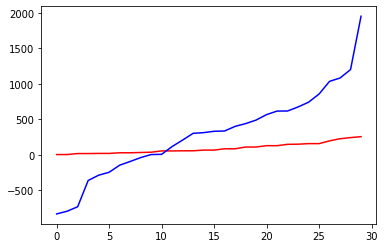

GAN:
[[  -73.  -835. -1117.  -105.   266.  1066.   185.  -421.   520.   -14.
    565.  -259.   151.   304.  -166.   718.  -921.   644.   264.   366.
    811.  1531.  -231.   803.   229.   809.   148.  1245.   946.  2287.]]
1999 1.0 1.0
30
30


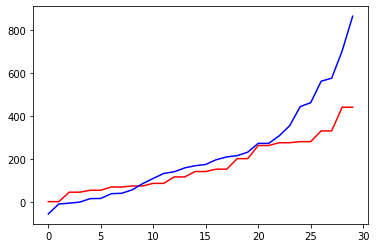

GAN:
[[ -35.  102.   60.   65.    8. -203.  -51.  103.  132.   67.  175.  108.
   -30.   49.   49.  166.  317.  201.  -13.  128.  180.  143.  475.  124.
   255.  313.  599.  444.  501.  644.]]
2999 1.0 1.0
30
30


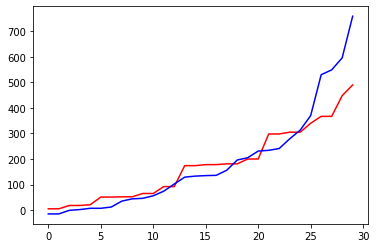

GAN:
[[116. -49.  55.  58. -64. -67. -27.  45. 121. 123.  54. 106.  67.  81.
   96. 113. 219. 225. 159.  70. 162. 263. 318. 203. 324. 221. 490. 446.
  470. 569.]]
3999 1.0 1.0
30
30


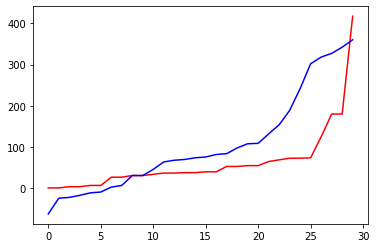

GAN:
[[ 27.  33.  67.  17.  60.  68.  43.  59. -16.  65.  35. 102. 136.  38.
  113. 108.  83.  60. 185. 133.  92. 128. 183. 209. 239. 309. 222. 385.
  407. 414.]]
4999 1.0 1.0
30
30


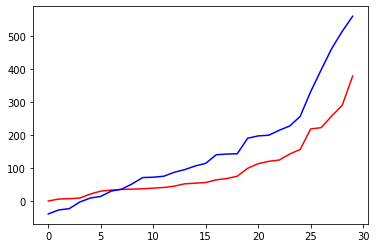

GAN:
[[ 56. -46.  -3.  30.  18. -33. -11.  35.  94.  56.  81.  36.  35.  68.
   34.  94. 140. 163.  60.  55. 102. 232. 226. 149. 181. 188. 413. 354.
  325. 493.]]
5999 1.0 1.0
30
30


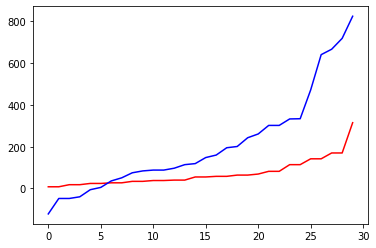

GAN:
[[ -3. -22.  -4.   4.  52. -20.   0.  37.  32.  27.  -7.  82. 105.  29.
    7.  94.  77.  85. 115. 117.  80. 164. 224. 177. 221. 244. 271. 380.
  381. 395.]]
6999 1.0 1.0
30
30


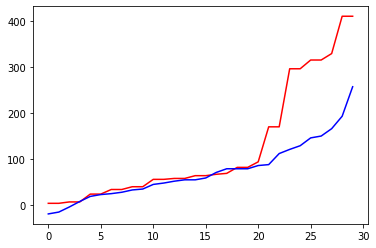

GAN:
[[ 40.   2. -43.  18. -30. -24.  22.  76. 131. 105.  15. 109.  36.  94.
  -12. 113. 164. 129. -40.  98. 118. 188. 226. 221. 168. 243. 409. 370.
  404. 482.]]
7999 1.0 1.0
30
30


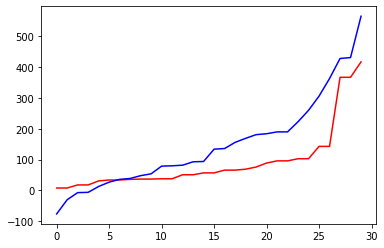

GAN:
[[ 66. -38.   7.  42. -35. -82.  19.  54. 127.  54.  10.  61.  11.  76.
  -53.  57. 188. 132. -12.  17.  71. 206. 270. 144. 153. 130. 434. 354.
  317. 394.]]
8999 1.0 1.0
30
30


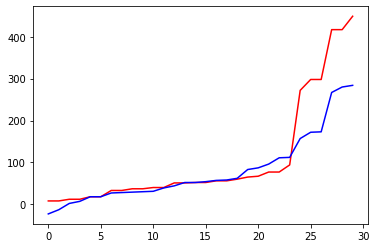

GAN:
[[  59.  -31.   34.   48.  -33. -109.  -28.   23.   67.   77.   87.   89.
    -3.   48.   37.   59.  163.  105.   37.   -5.   52.  130.  239.   76.
   125.   86.  311.  219.  233.  325.]]
9999 1.0 1.0
30
30


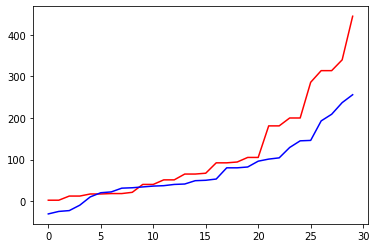

GAN:
[[ -31.   -2.   23.   66.   17. -109.   12.   57.   92.   72.  107.   42.
   -13.   52.  -13.   75.  225.  142.   -2.   86.   73.  191.  286.  115.
   193.  176.  335.  315.  286.  399.]]


In [17]:

latent_dim =30
# create the discriminator

#try changing activations n such on models
discriminator = define_discriminator()
# create the generator
generator = define_generator(latent_dim)
# create the gan
gan_model = define_gan(generator, discriminator)
# train model
created_decks, created_gans, new_cards, new_deck_list = train(generator, discriminator, gan_model, latent_dim, choice, deck_list)


In [18]:
#print(created_gans)
final_decks = []
for decks in created_gans:
    #print(decks)
    deck = []
    for card in decks[0]:
        if abs(card) <= len(new_cards):
            deck.append(abs(card))
        else:
            break
    #print(len(deck))
    if(len(deck) == 30):
        final_decks.append(deck)
                      
print(final_decks)

for decks in final_decks:
    print('DECK:')
    #convert float list to int list
    decks = [int(a) for a in decks]
    print(decks)
    print(len(new_cards))
    readable = vector_to_deck(decks, new_cards)
    for card in readable:
        print(card['name'], ',  ' ,card['playerClass'])


[[27.0, 33.0, 67.0, 17.0, 60.0, 68.0, 43.0, 59.0, 16.0, 65.0, 35.0, 102.0, 136.0, 38.0, 113.0, 108.0, 83.0, 60.0, 185.0, 133.0, 92.0, 128.0, 183.0, 209.0, 239.0, 309.0, 222.0, 385.0, 407.0, 414.0], [56.0, 46.0, 3.0, 30.0, 18.0, 33.0, 11.0, 35.0, 94.0, 56.0, 81.0, 36.0, 35.0, 68.0, 34.0, 94.0, 140.0, 163.0, 60.0, 55.0, 102.0, 232.0, 226.0, 149.0, 181.0, 188.0, 413.0, 354.0, 325.0, 493.0], [3.0, 22.0, 4.0, 4.0, 52.0, 20.0, 0.0, 37.0, 32.0, 27.0, 7.0, 82.0, 105.0, 29.0, 7.0, 94.0, 77.0, 85.0, 115.0, 117.0, 80.0, 164.0, 224.0, 177.0, 221.0, 244.0, 271.0, 380.0, 381.0, 395.0], [40.0, 2.0, 43.0, 18.0, 30.0, 24.0, 22.0, 76.0, 131.0, 105.0, 15.0, 109.0, 36.0, 94.0, 12.0, 113.0, 164.0, 129.0, 40.0, 98.0, 118.0, 188.0, 226.0, 221.0, 168.0, 243.0, 409.0, 370.0, 404.0, 482.0], [66.0, 38.0, 7.0, 42.0, 35.0, 82.0, 19.0, 54.0, 127.0, 54.0, 10.0, 61.0, 11.0, 76.0, 53.0, 57.0, 188.0, 132.0, 12.0, 17.0, 71.0, 206.0, 270.0, 144.0, 153.0, 130.0, 434.0, 354.0, 317.0, 394.0], [59.0, 31.0, 34.0, 48.0, 33.0, 

In [19]:
#final_decks = [[49.0, 19.0, 87.0, 59.0, 15.0, 45.0, 55.0, 86.0, 28.0, 82.0, 102.0, 10.0, 122.0, 63.0, 38.0, 6.0, 94.0, 6.0, 246.0, 112.0, 145.0, 202.0, 65.0, 166.0, 337.0, 238.0, 314.0, 213.0, 437.0, 459.0], [23.0, 20.0, 11.0, 22.0, 102.0, 90.0, 66.0, 16.0, 53.0, 30.0, 27.0, 69.0, 5.0, 73.0, 63.0, 39.0, 33.0, 109.0, 19.0, 84.0, 37.0, 30.0, 78.0, 93.0, 37.0, 71.0, 75.0, 183.0, 285.0, 401.0], [13.0, 6.0, 7.0, 11.0, 53.0, 0.0, 37.0, 35.0, 9.0, 43.0, 68.0, 0.0, 72.0, 26.0, 45.0, 41.0, 68.0, 58.0, 84.0, 73.0, 52.0, 12.0, 71.0, 98.0, 96.0, 100.0, 115.0, 134.0, 269.0, 281.0], [6.0, 12.0, 2.0, 1.0, 32.0, 49.0, 74.0, 1.0, 61.0, 26.0, 27.0, 55.0, 6.0, 68.0, 43.0, 49.0, 38.0, 86.0, 28.0, 53.0, 40.0, 43.0, 69.0, 51.0, 7.0, 52.0, 51.0, 160.0, 235.0, 287.0]]
final_decks = [[43.0, 6.0, 16.0, 22.0, 25.0, 76.0, 18.0, 34.0, 95.0, 46.0, 15.0, 2.0, 120.0, 112.0, 108.0, 114.0, 95.0, 138.0, 63.0, 135.0, 130.0, 90.0, 208.0, 143.0, 266.0, 205.0, 250.0, 255.0, 230.0, 326.0], [43.0, 63.0, 18.0, 16.0, 3.0, 8.0, 42.0, 12.0, 25.0, 72.0, 124.0, 60.0, 77.0, 37.0, 34.0, 72.0, 87.0, 76.0, 121.0, 89.0, 131.0, 90.0, 155.0, 87.0, 162.0, 212.0, 269.0, 244.0, 300.0, 407.0], [34.0, 41.0, 8.0, 46.0, 28.0, 0.0, 25.0, 7.0, 77.0, 106.0, 123.0, 40.0, 117.0, 51.0, 6.0, 57.0, 55.0, 42.0, 52.0, 98.0, 127.0, 78.0, 150.0, 105.0, 170.0, 146.0, 229.0, 232.0, 219.0, 291.0], [17.0, 21.0, 8.0, 31.0, 6.0, 32.0, 14.0, 3.0, 14.0, 51.0, 36.0, 25.0, 40.0, 0.0, 43.0, 38.0, 23.0, 28.0, 51.0, 48.0, 87.0, 49.0, 100.0, 64.0, 79.0, 84.0, 149.0, 143.0, 184.0, 223.0]]
new_cards, new_deck_list = limit_card_range(copy.deepcopy(cards), copy.deepcopy(deck_list), [choice, 'Neutral'])

duplicates = []
for decks in final_decks:
    print('DECK:')
    #convert float list to int list
    decks = [int(a) for a in decks]
    readable = vector_to_deck(decks, new_cards)
    for card in readable:
        if(readable.count(card) > 2): #need to test
            final_deck.remove(decks)
        if(card['rarity'] == 'Lengendary'):
            if(card in duplicates):
                final_deck.remove(decks)
            else:
                duplicates.append(card)
        print(card['name'], ',  ' ,card['playerClass'])

['Toxic Reinforcements', 'Toxic Reinforcements', 'Wolpertinger', 'Wolpertinger', 'Explosive Trap', 'Explosive Trap', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Dragonbane', "Rinling's Rifle", 'Leper Gnome', 'Leper Gnome', 'Tour Guide', 'Tour Guide', 'Kobold Sandtrooper', 'Kobold Sandtrooper', 'Knife Vendor', 'Knife Vendor']
Toxic Reinforcements 517
Toxic Reinforcements 17
Toxic Reinforcements 517
Toxic Reinforcements 17
Wolpertinger 202
Wolpertinger 22
Wolpertinger 202
Wolpertinger 22
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase

Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Snake Trap 988
Snake Trap 42
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Petting Zoo 87
Petting Zoo 57
Unleash the Hounds 1043
Unleash the Hounds 65
Dragonbane 563
Dragonbane 69
Rinling's Rifle 116
Rinling's Rifle 76
Dinotamer Brann 757
Dinotamer Brann 100
Blazing Battlemage 498
Blazing Battlemage 114
Guardian Augmerchant 330
Guardian Augmerchant 121
Intrepid Initiate 187
Intrepid Initiate 125
Tour Guide 198
Tour Guide 143
Bonechewer Brawler 349
Bonechewer Brawler 157
Wriggling Horror 55
Wriggling Horror 219
Zephrys the Great 686
Zephrys the Great 223
Inconspicuous Rider 76
Inconspicuous Rider 258
Voracious Reader 241
Voracious Reader 290
Lorekeeper Polkelt 270
Lorekeeper Polkelt 379
['Carrion Studies', 'Carrion Studies', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Resizing Pouch', 'Resizing Pouch', 

Intrepid Initiate 125
Intrepid Initiate 187
Intrepid Initiate 125
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Pen Flinger 192
Pen Flinger 133
Pen Flinger 192
Pen Flinger 133
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Voracious Reader 241
Voracious Reader 290
Knife Vendor 110
Knife Vendor 327
['Adorable Infestation', 'Adorable Infestation', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Mystery Winner', 'Mystery Winner', 'Wolpertinger', 'Wolpertinger', 'Corrosive Breath', 'Corrosive Breath', 'Imprisoned Felmaw', 'Imprisoned Felmaw', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Primordial Explorer', 'Primordial Explorer', 'Saddlemaster', 'Saddlemaster', 'Stormhammer', 'Stormhammer', 'Dragonbane', "Rinling's Rifle", 'Rotnest Drake', 'Rotnest Drake', 'Veranus', 'Circus Amalgam', 'Circus Amalgam', 'Cobalt Spellkin', 'Cobalt Spellkin', 'Moonfang']
Adorable 

Nine Lives 828
Nine Lives 56
Nine Lives 828
Nine Lives 56
Saddlemaster 92
Saddlemaster 61
Saddlemaster 92
Saddlemaster 61
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
Trampling Rhino 137
Trampling Rhino 86
Trampling Rhino 137
Trampling Rhino 86
Moonfang 133
Moonfang 380
['Unseal the Vault', 'Wolpertinger', 'Wolpertinger', 'Explosive Trap', 'Explosive Trap', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Desert Spear', 'Desert Spear', 'Diving Gryphon', 'Diving Gryphon', 'Unleash the Hounds', 'Unleash the Hounds', 'Zixor, Apex Predator', "Rinling's Rifle", "Teacher's Pet", 'Swarm of Locusts', 'Swarm of Locusts', 'Veranus', "Jewel of N'Zoth", "Jewel of N'Zoth", 'Questing Explorer', 'Questing Explorer', 'Inconspicuous Rider', "Sky Gen'ral Kragg", 'Faceless Corruptor', 'Claw Machine', 'Khartut Defender', 'Khartut Defender', 'Silas Darkmo

Armor Vendor 0
Armor Vendor 112
Armor Vendor 0
Armor Vendor 112
Novice Engineer 1209
Novice Engineer 195
Novice Engineer 1209
Novice Engineer 195
Prize Vendor 41
Prize Vendor 199
Bone Wraith 712
Bone Wraith 298
Bone Wraith 712
Bone Wraith 298
Faceless Corruptor 592
Faceless Corruptor 367
Faceless Corruptor 592
Faceless Corruptor 367
['Arcane Shot', 'Arcane Shot', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Tracking', 'Tracking', 'Trueaim Crescent', 'Trueaim Crescent', 'Bola Shot', 'Bola Shot', 'Professor Slate', "Shan'do Wildclaw", 'Krolusk Barkstripper', 'Krolusk Barkstripper', "Rinling's Rifle", "Teacher's Pet", "Teacher's Pet", 'Scarlet Webweaver', 'Scarlet Webweaver', 'Vereesa Windrunner', 'Guardian Animals', 'Guardian Animals', 'Bloodmage Thalnos', 'Escaped Manasaber', 'Escaped Manasaber', 'Lake Thresher', 'Lake Thresher', 'Moonfang']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarv

Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Snake Trap 988
Snake Trap 42
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Petting Zoo 87
Petting Zoo 57
Petting Zoo 87
Petting Zoo 57
Unleash the Hounds 1043
Unleash the Hounds 65
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandtrooper 180
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Corrosive Breath', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Primordial Explorer', 'Primordial Explorer', 'Stormhammer', 'Stormhammer', 'Dragonbane', 'Rotnest Drake', 'Rotnest Drake', 'Blazing Battlemage', 'Blazing Battlemage', 'Faerie Dragon', 'Faerie Dragon', 'Frozen Shadoweaver', 'Frozen Shadoweaver', 'Scalerider', 'Scalerider', 'Circus Amalgam', 'Circus Amalgam', 'Circus Medic', 'C

Deadly Shot 1004
Deadly Shot 50
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Petting Zoo 87
Petting Zoo 57
Petting Zoo 87
Petting Zoo 57
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Rinling's Rifle 116
Rinling's Rifle 76
Maxima Blastenheimer 144
Maxima Blastenheimer 88
Darkmoon Tonk 148
Darkmoon Tonk 96
Darkmoon Tonk 148
Darkmoon Tonk 96
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Corrosive Breath', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Ace Hunter Kreen', 'Primordial Explorer', 'Primordial Explorer', 'Blazing Battlemage', 'Blazing Battlemage', 'Dragon Breeder', 'Dragon Breeder', 'Faerie Dragon', 'Faerie Dragon', 'Frozen Shadoweaver', 'Frozen Shadoweaver', 'Scalerider', 'Scalerider', 'Circus Amalgam', 'Circus Amalgam', 'Circus Medic', 'Circus Medic', 'Evasive Feywing', 'Evasive Feywing', 'Wing Commander',

Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Misdirection 980
Misdirection 35
Pack Tactics 368
Pack Tactics 37
Pressure Plate 674
Pressure Plate 39
Deadly Shot 1004
Deadly Shot 50
Deadly Shot 1004
Deadly Shot 50
Nine Lives 828
Nine Lives 56
Nine Lives 828
Nine Lives 56
Petting Zoo 87
Petting Zoo 57
Petting Zoo 87
Petting Zoo 57
Marked Shot 842
Marked Shot 73
Marked Shot 842
Marked Shot 73
Rinling's Rifle 116
Rinling's Rifle 76
Explosive Shot 1084
Explosive Shot 80
Maxima Blastenheimer 144
Maxima Blastenheimer 88
Darkmoon Tonk 148
Darkmoon Tonk 96
Jewel of N'Zoth 160
Jewel of N'Zoth 103
Khartut Defender 745
Khartut Defender 417
Safeguard 873
Safeguard 425
Wrapped Golem 756
Wrapped Golem 457
Scrapyard Colossus 459
Scrapyard Colossus 489
Yogg-Saron, Master of Fate 169
Yogg-Saron, Master of Fate 492
['Carrion Studies', 'Carrion Studies', 'Helboar', 'Helboar', 'Mystery Winner', 'Mystery Winner', "Don't Feed the Animals", "Don't Feed the Animals", 'Flare', 'Flare', 'Pack Tactics', 'P

Fresh Scent 32
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Shan'do Wildclaw 239
Shan'do Wildclaw 63
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Trampling Rhino 137
Trampling Rhino 86
Trampling Rhino 137
Trampling Rhino 86
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Vulpera Scoundrel 707
Vulpera Scoundrel 291
Vulpera Scoundrel 707
Vulpera Scoundrel 291
['Adorable Infestation', 'Demon Companion', 'Dwarven Sharpshooter', 'Mystery Winner', 'Wolpertinger', 'Freezing Trap', 'Imprisoned Felmaw', 'Open the Cages', 'Pack Tactics', 'Phase Stalker', "Scavenger's Ingenuity", 'Snake Trap', 'Animal Companion', 'Eaglehorn Bow', 'Kill Command', 'Petting Zoo', 'Unleash the Hounds', 'Dragon

Inconspicuous Rider 258
Inconspicuous Rider 76
Inconspicuous Rider 258
Knife Vendor 110
Knife Vendor 327
Knife Vendor 110
Knife Vendor 327
['Carrion Studies', 'Dwarven Sharpshooter', 'Wolpertinger', 'Explosive Trap', 'Flare', 'Freezing Trap', 'Phase Stalker', 'Pressure Plate', "Scavenger's Ingenuity", 'Animal Companion', 'Deadly Shot', 'Diving Gryphon', "Hunter's Pack", 'Primordial Explorer', 'Zixor, Apex Predator', 'Marked Shot', "Rinling's Rifle", 'Trampling Rhino', 'Unleash the Beast', 'Dinotamer Brann', "Jewel of N'Zoth", 'Nagrand Slam', 'Zephrys the Great', 'Khartut Defender', 'Keymaster Alabaster', 'Siamat', 'Alexstrasza', 'Dragonqueen Alexstrasza', "C'Thun, the Shattered", 'Yogg-Saron, Master of Fate']
Carrion Studies 178
Carrion Studies 4
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Wolpertinger 202
Wolpertinger 22
Explosive Trap 964
Explosive Trap 27
Flare 966
Flare 30
Freezing Trap 967
Freezing Trap 31
Phase Stalker 529
Phase Stalker 38
Pressure Plate 674
Pressure Plate 39

Jewel of N'Zoth 160
Jewel of N'Zoth 103
Blatant Decoy 743
Blatant Decoy 405
Blatant Decoy 743
Blatant Decoy 405
Claw Machine 140
Claw Machine 409
Claw Machine 140
Claw Machine 409
Khartut Defender 745
Khartut Defender 417
Khartut Defender 745
Khartut Defender 417
['Adorable Infestation', 'Adorable Infestation', 'Clear the Way', 'Clear the Way', 'Unseal the Vault', 'Wolpertinger', 'Wolpertinger', 'Desert Spear', 'Desert Spear', 'Diving Gryphon', 'Diving Gryphon', 'Unleash the Hounds', 'Unleash the Hounds', 'Swarm of Locusts', 'Swarm of Locusts', 'Veranus', 'Hench-Clan Hogsteed', 'Hench-Clan Hogsteed', 'Licensed Adventurer', 'Licensed Adventurer', 'Questing Explorer', 'Questing Explorer', 'Wriggling Horror', 'Wriggling Horror', "Sky Gen'ral Kragg", 'Derailed Coaster', 'Derailed Coaster', 'Faceless Corruptor', 'Faceless Corruptor', "Shu'ma"]
Adorable Infestation 174
Adorable Infestation 1
Adorable Infestation 174
Adorable Infestation 1
Clear the Way 500
Clear the Way 5
Clear the Way 500
C

Blazing Battlemage 114
Guardian Augmerchant 330
Guardian Augmerchant 121
Intrepid Initiate 187
Intrepid Initiate 125
Secretkeeper 937
Secretkeeper 137
Tour Guide 198
Tour Guide 143
Wriggling Horror 55
Wriggling Horror 219
Zephrys the Great 686
Zephrys the Great 223
Inconspicuous Rider 76
Inconspicuous Rider 258
Voracious Reader 241
Voracious Reader 290
Lorekeeper Polkelt 270
Lorekeeper Polkelt 379
['Demon Companion', 'Toxic Reinforcements', 'Unseal the Vault', 'Explosive Trap', 'Freezing Trap', 'Pack Tactics', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Snake Trap', 'Snipe', 'Deadly Shot', "Hunter's Pack", 'Kill Command', 'Petting Zoo', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Blood Herald', 'Oblivitron', 'Swarm of Locusts', 'Unleash the Beast', 'Darkmoon Tonk', 'Dinotamer Brann', 'Bonechewer Brawler', 'Bug Collector', 'Educated Elekk', "Sky Gen'ral Kragg", 'Ogremancer', 'Yogg-Saron, Master of Fate']
Demon Companion 179
Demon Companion 7
Tox

Swarm of Locusts 750
Swarm of Locusts 92
Veranus 615
Veranus 94
Animated Broomstick 175
Animated Broomstick 110
Animated Broomstick 175
Animated Broomstick 110
Bug Collector 659
Bug Collector 158
Bug Collector 659
Bug Collector 158
Parade Leader 40
Parade Leader 197
Parade Leader 40
Parade Leader 197
Darkmoon Dirigible 61
Darkmoon Dirigible 235
Darkmoon Dirigible 61
Darkmoon Dirigible 235
Derailed Coaster 122
Derailed Coaster 365
Derailed Coaster 122
Derailed Coaster 365
Lake Thresher 269
Lake Thresher 378
Claw Machine 140
Claw Machine 409
Claw Machine 140
Claw Machine 409
['Arcane Shot', 'Arcane Shot', 'Carrion Studies', 'Carrion Studies', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Misdirection', 'Misdirection', 'Pack Tactics', 'Pressure Plate', 'Pressure Plate', 'Snipe', 'Snipe', 'Deadly Shot', 'Deadly Shot', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Nine Lives', 'Nine Lives', 'Petting Zoo', 'Petting Zoo', "Rinling's Rifle", 'Maxima Blaste

Claw Machine 140
Claw Machine 409
['Carrion Studies', 'Carrion Studies', 'Mystery Winner', 'Mystery Winner', 'Tracking', 'Tracking', 'Explosive Trap', 'Freezing Trap', 'Open the Cages', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', 'Snake Trap', 'Petting Zoo', 'Petting Zoo', 'Ursatron', 'Ursatron', "Rinling's Rifle", 'Darkmoon Tonk', 'Darkmoon Tonk', "Jewel of N'Zoth", "Jewel of N'Zoth", 'Animated Broomstick', 'Animated Broomstick', 'Inconspicuous Rider', 'Vectus', 'Cairne Bloodhoof', 'Khartut Defender', 'Khartut Defender']
Carrion Studies 178
Carrion Studies 4
Carrion Studies 178
Carrion Studies 4
Mystery Winner 5
Mystery Winner 10
Mystery Winner 5
Mystery Winner 10
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Open the Cages 39
Open the Cages 36
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Snake Tr

Petting Zoo 87
Petting Zoo 57
Dragonbane 563
Dragonbane 69
Rinling's Rifle 116
Rinling's Rifle 76
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
Lorekeeper Polkelt 270
Lorekeeper Polkelt 379
['Adorable Infestation', 'Adorable Infestation', 'Demon Companion', 'Wolpertinger', 'Freezing Trap', 'Open the Cages', 'Open the Cages', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Snake Trap', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Petting Zoo', 'Petting Zoo', 'Dragonbane', "Rinling's Rifle", 'Trampling Rhino', 'Intrepid Initiate', 'Intrepid Initiate', 'Secretkeeper', 'Secretkeeper', 'Tour Guide', 'Tour Guide', 'Inconspicuous Rider', 'Lorekeeper Polkelt']
Adorable Infestation 174
Adorable Infestation 1
Adorable Infestation 174
Adorable Infestation 1
Demon Companion 179
Demon Companion 7
Wolpertinger 202
Wolpertinger 22

Petting Zoo 87
Petting Zoo 57
Ursatron 831
Ursatron 66
Ursatron 831
Ursatron 66
Rinling's Rifle 116
Rinling's Rifle 76
Oblivitron 871
Oblivitron 89
Darkmoon Tonk 148
Darkmoon Tonk 96
Darkmoon Tonk 148
Darkmoon Tonk 96
Jewel of N'Zoth 160
Jewel of N'Zoth 103
Jewel of N'Zoth 160
Jewel of N'Zoth 103
Inconspicuous Rider 76
Inconspicuous Rider 258
Inconspicuous Rider 76
Inconspicuous Rider 258
Vectus 279
Vectus 399
Khartut Defender 745
Khartut Defender 417
Khartut Defender 745
Khartut Defender 417
['Adorable Infestation', 'Adorable Infestation', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Mystery Winner', 'Mystery Winner', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Open the Cages', 'Open the Cages', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', 'Snake Trap', 'Snake Trap', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Petting Zoo', 'Petting Zoo', 'Hyena Alpha', 'Hyena Alpha', "Rinling's Rifle", 'Tour Guide', 'Tour Guide', 'Inc

Petting Zoo 87
Petting Zoo 57
Marked Shot 842
Marked Shot 73
Marked Shot 842
Marked Shot 73
Rinling's Rifle 116
Rinling's Rifle 76
Maxima Blastenheimer 144
Maxima Blastenheimer 88
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Darkmoon Tonk 148
Darkmoon Tonk 96
Darkmoon Tonk 148
Darkmoon Tonk 96
Jewel of N'Zoth 160
Jewel of N'Zoth 103
Colossus of the Moon 766
Colossus of the Moon 483
['Mystery Winner', 'Mystery Winner', "Don't Feed the Animals", "Don't Feed the Animals", 'Freezing Trap', 'Freezing Trap', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Snake Trap', 'Snake Trap', 'Diving Gryphon', 'Diving Gryphon', 'Petting Zoo', 'Petting Zoo', "Rinling's Rifle", 'Hunting Party', 'Hunting Party', 'Trampling Rhino', 'Trampling Rhino', 'Tundra Rhino', 'Scarlet Webweaver', 'Scarlet Webweaver', 'Inconspicuous Rider', 'Inconspicuous Rider', 'Circus Medic', 'Circus Medic', 'Fleethoof Pearltusk', 'Fleethoof Pearltusk', "Y'Shaarj, the

Wolpertinger 202
Wolpertinger 22
Wolpertinger 202
Wolpertinger 22
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Snake Trap 988
Snake Trap 42
Snake Trap 988
Snake Trap 42
Desert Spear 691
Desert Spear 51
Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Petting Zoo 87
Petting Zoo 57
Petting Zoo 87
Petting Zoo 57
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Hyena Alpha 717
Hyena Alpha 71
Hyena Alpha 717
Hyena Alpha 71
Rinling's Rifle 116
Rinling's Rifle 76
Swarm of Locusts 750
Swarm of Locusts 92
Swarm of Locusts 750
Swarm of Locusts 92
Inconspicuous Rider 76
Inconspicuous Rider 258
Inconspicuous Rider 76
Inconspicuous Rider 258
Shu'ma 625
Shu'ma 448
['Mystery Winner', 'Mystery 

Open the Cages 36
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Snake Trap 988
Snake Trap 42
Snipe 989
Snipe 43
Snipe 989
Snipe 43
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Petting Zoo 87
Petting Zoo 57
Petting Zoo 87
Petting Zoo 57
Hyena Alpha 717
Hyena Alpha 71
Hyena Alpha 717
Hyena Alpha 71
Marked Shot 842
Marked Shot 73
Marked Shot 842
Marked Shot 73
Rinling's Rifle 116
Rinling's Rifle 76
Unleash the Beast 875
Unleash the Beast 93
Unleash the Beast 875
Unleash the Beast 93
Secretkeeper 937
Secretkeeper 137
Secretkeeper 937
Secretkeeper 137
Inconspicuous Rider 76
Inconspicuous Rider 258
Inconspicuous Rider 76
Inconspicuous Rider 258
Yogg-Saron, Master of Fate 169
Yogg-Saron, Master of Fate 492
['Demon Companion', 'Demon Companion', 'Tracking', 'Tracking', 'Corrosive Breath', 'Corros

Plagued Protodrake 298
Plagued Protodrake 465
Plagued Protodrake 298
Plagued Protodrake 465
N'Zoth, God of the Deep 167
N'Zoth, God of the Deep 488
Scrapyard Colossus 459
Scrapyard Colossus 489
Scrapyard Colossus 459
Scrapyard Colossus 489
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Wolpertinger', 'Wolpertinger', 'Freezing Trap', 'Freezing Trap', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Open the Cages', 'Open the Cages', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Petting Zoo', 'Petting Zoo', 'Dragonbane', 'Intrepid Initiate', 'Intrepid Initiate', 'Tour Guide', 'Tour Guide', 'Voracious Reader', 'Voracious Reader', 'Lorekeeper Polkelt']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Wolpertinger 202
Wolpertinger 22
Wolpertinger 202
Wolpertinger 22
Freezing Trap 967
Freezing Trap 31
Freezing Tra

Trampling Rhino 137
Trampling Rhino 86
Trampling Rhino 137
Trampling Rhino 86
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Inconspicuous Rider 76
Inconspicuous Rider 258
Inconspicuous Rider 76
Inconspicuous Rider 258
['Clear the Way', 'Clear the Way', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Freezing Trap', 'Fresh Scent', 'Fresh Scent', 'Open the Cages', 'Pack Tactics', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Snake Trap', 'Ace Hunter Kreen', 'Desert Spear', 'Desert Spear', 'Diving Gryphon', 'Diving Gryphon', 'Petting Zoo', 'Petting Zoo', "Shan'do Wildclaw", 'Zixor, Apex Predator', 'Trampling Rhino', 'Trampling Rhino', 'Parade Leader', 'Parade Leader', 'Inconspicuous Rider', 'Inconspicuous Rider', 'Hippogryph', 'Hippogryph']
Clear the Way 500
Clear the Way 5
Clear the Way 500
Clear the Way 5
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Freezing Trap 967
Freezing Trap 31
Fresh Scent 466


Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Snake Trap 988
Snake Trap 42
Snake Trap 988
Snake Trap 42
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Petting Zoo 87
Petting Zoo 57
Petting Zoo 87
Petting Zoo 57
Dragonbane 563
Dragonbane 69
Hyena Alpha 717
Hyena Alpha 71
Hyena Alpha 717
Hyena Alpha 71
Rinling's Rifle 116
Rinling's Rifle 76
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Inconspicuous Rider 76
Inconspicuous Rider 258
Inconspicuous Rider 76
Inconspicuous Rider 258
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
['Carrion Studies', 'Carrion Studies', 'Demon Companion', 'Demon Companion', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Animal Companion', 'Animal Companion', 'Diving Gryphon', 'Diving Gryphon', 'Nine Lives', 'Nine Lives', "Mok'Nathal Lion", "Mok'Nathal Lion", 'Darkmoon Tonk', 'Darkmoon Tonk', "Jewe

Dragonbane 69
Blood Herald 264
Blood Herald 79
Blood Herald 264
Blood Herald 79
Swarm of Locusts 750
Swarm of Locusts 92
Swarm of Locusts 750
Swarm of Locusts 92
Unleash the Beast 875
Unleash the Beast 93
Veranus 615
Veranus 94
Animated Broomstick 175
Animated Broomstick 110
Animated Broomstick 175
Animated Broomstick 110
Knife Juggler 969
Knife Juggler 178
Knife Juggler 969
Knife Juggler 178
Flesheating Ghoul 1012
Flesheating Ghoul 247
Cult Master 1052
Cult Master 305
Cult Master 1052
Cult Master 305
Mad Summoner 870
Mad Summoner 420
['Adorable Infestation', 'Adorable Infestation', 'Carrion Studies', 'Carrion Studies', 'Demon Companion', 'Demon Companion', 'Toxic Reinforcements', 'Toxic Reinforcements', 'Tracking', 'Explosive Trap', 'Freezing Trap', 'Pack Tactics', 'Pressure Plate', 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', "Hunter's Pack", "Hunter's Pack", 'Kill Command', 'Kill Command', 'Petting Zoo', 'Petting Zoo', 'Unleash the Hounds', 'Unleash the 

Cobalt Spellkin 362
Lorekeeper Polkelt 270
Lorekeeper Polkelt 379
Silas Darkmoon 152
Silas Darkmoon 450
['Adorable Infestation', 'Demon Companion', 'Dwarven Sharpshooter', 'Toxic Reinforcements', 'Trueaim Crescent', 'Wolpertinger', 'Freezing Trap', 'Imprisoned Felmaw', 'Pack Tactics', 'Phase Stalker', 'Pressure Plate', "Scavenger's Ingenuity", 'Ace Hunter Kreen', 'Animal Companion', 'Desert Spear', 'Eaglehorn Bow', 'Kill Command', 'Unleash the Hounds', 'Dragonbane', 'Dinotamer Brann', 'Blazing Battlemage', 'Guardian Augmerchant', 'Intrepid Initiate', 'Tour Guide', 'Acidic Swamp Ooze', 'Bonechewer Brawler', 'Zephrys the Great', 'Frozen Shadoweaver', 'Voracious Reader', 'Lorekeeper Polkelt']
Adorable Infestation 174
Adorable Infestation 1
Demon Companion 179
Demon Companion 7
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Toxic Reinforcements 517
Toxic Reinforcements 17
Trueaim Crescent 199
Trueaim Crescent 20
Wolpertinger 202
Wolpertinger 22
Freezing Trap 967
Freezing Trap 31
Imprisone

Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Ace Hunter Kreen 218
Ace Hunter Kreen 45
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Professor Slate 234
Professor Slate 59
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Marked Shot 842
Marked Shot 73
Marked Shot 842
Marked Shot 73
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Wild Bloodstinger 751
Wild Bloodstinger 95
Wild Bloodstinger 751
Wild Bloodstinger 95
Cobalt Spellkin 588
Cobalt Spellkin 362
['Adorable Infestation', 'Adorable Infestation', 'Demon Companion', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Toxic Reinforcements', 'Tracking', 'Wolpertinger', 'Wolpertinger', 'Explosive Trap', 'Freezing Trap', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Pack Tactics',

Wolpertinger 22
Freezing Trap 967
Freezing Trap 31
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Phase Stalker 529
Phase Stalker 38
Pressure Plate 674
Pressure Plate 39
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Snake Trap 988
Snake Trap 42
Ace Hunter Kreen 218
Ace Hunter Kreen 45
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Dragonbane 563
Dragonbane 69
Dinotamer Brann 757
Dinotamer Brann 100
Blazing Battlemage 498
Blazing Battlemage 114
Guardian Augmerchant 330
Guardian Augmerchant 121
Intrepid Initiate 187
Intrepid Initiate 125
Tour Guide 198
Tour Guide 143
Bonechewer Brawler 349
Bonechewer Brawler 157
Cult Neophyte 206
Cult Neophyte 162
Transfer Student 215
Transfer Student 214
Zephrys the Great 686
Zephrys the Great 223
Frozen Shadoweaver 386
Frozen Shadoweaver 249
Voracious Reader 241
Voracious Reader 290
Lorekeeper Polkelt 270
Lorekeeper Polkelt 379
['Demon Compan

Cult Master 1052
Cult Master 305
Maiev Shadowsong 410
Maiev Shadowsong 329
Vectus 279
Vectus 399
Cairne Bloodhoof 1102
Cairne Bloodhoof 407
['Carrion Studies', 'Carrion Studies', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Corrosive Breath', 'Corrosive Breath', 'Diving Gryphon', 'Diving Gryphon', "Hunter's Pack", "Hunter's Pack", 'Primordial Explorer', 'Primordial Explorer', 'Professor Slate', 'Zixor, Apex Predator', 'Dragonbane', 'Krolusk Barkstripper', 'Krolusk Barkstripper', 'Rotnest Drake', 'Rotnest Drake', 'Wild Bloodstinger', 'Wild Bloodstinger', 'Vereesa Windrunner', 'Wandmaker', 'Wandmaker', 'Cobalt Spellkin', 'Cobalt Spellkin', 'Harrison Jones', "Headmaster Kel'Thuzad"]
Carrion Studies 178
Carrion Studies 4
Carrion Studies 178
Carrion Studies 4
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Rapid Fire 781
Rapid Fire 12
Rapid Fire 781
Rapid Fire 12
Corrosive Breath 521
Corrosive Breath 24
Corrosiv

Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
['Adorable Infestation', 'Adorable Infestation', 'Demon Companion', 'Demon Companion', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Wolpertinger', 'Wolpertinger', 'Freezing Trap', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Intrepid Initiate', 'Intrepid Initiate', 'Tour Guide', 'Tour Guide', 'Voracious Reader', 'Voracious Reader']
Adorable Infestation 174
Adorable Infestation 1
Adorable Infestation 174
Adorable Infestation 1
Demon Com

Freezing Trap 967
Freezing Trap 31
Fresh Scent 466
Fresh Scent 32
Fresh Scent 466
Fresh Scent 32
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Pressure Plate 674
Pressure Plate 39
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Shan'do Wildclaw 239
Shan'do Wildclaw 63
Intrepid Initiate 187
Intrepid Initiate 125
Intrepid Initiate 187
Intrepid Initiate 125
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Jungle Panther 1020
Jungle Panther 264
Jungle Panther 1020
Jungle Panther 264
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
Burrowing Scorpid 403
Burrowing Scorpid 299
Burrowing Scorpid 403
Burrowing Scorpid 299
['Arcane Shot', 'Arcane Shot', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Tracking', 'Tracking', 'Animal Companion', 'Animal Companion', 'Deadly Shot', '

Teacher's Pet 276
Teacher's Pet 85
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
Siamat 754
Siamat 449
['Adorable Infestation', 'Adorable Infestation', 'Demon Companion', 'Demon Companion', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Wolpertinger', 'Wolpertinger', 'Freezing Trap', 'Freezing Trap', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', 'Pressure Plate', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Dragonbane', 'Intrepid Initiate', 'Intrepid Initiate', 'Tour Guide', 'Tour Guide', 'Voracious Reader', 'Voracious Reader', 'Lorekeeper Polkelt']
Adorable Infestation 174
Adorable Infestation 1
Adorable Infestation 174
Adorable Infestation 1
Demon Companion 179
Demon Companion 7
Demon Companion 179
Demon Companion 7
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarve

Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Demon Companion 179
Demon Companion 7
Demon Companion 179
Demon Companion 7
Rapid Fire 781
Rapid Fire 12
Rapid Fire 781
Rapid Fire 12
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Corrosive Breath 521
Corrosive Breath 24
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Stormhammer 559
Stormhammer 64
Stormhammer 559
Stormhammer 64
Dragonbane 563
Dragonbane 69
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Veranus 615
Veranus 94
Vereesa Windrunner 886
Vereesa Windrunner 98
Faerie Dragon 965
Faerie Dragon 170
Faerie Dragon 965
Faerie Dragon 170
Wandmaker 217
Wandmaker 217
Wandmaker 217
Wandmaker 217
Crimson Hothead 245
Crimson Hothead 304
Crimson Hothead 245
Crimson Hothead 304
Wretched Tutor 262
Wretched Tutor 350
Cobalt Spellkin 588
Cobalt Spellkin 362
Coba

Houndmaster 70
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Tracking', 'Unseal the Vault', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Ramkahen Wildtamer', 'Ramkahen Wildtamer', "Shan'do Wildclaw", 'Scrap Shot', 'Scrap Shot', 'Beastmaster Leoroxx', 'King Krush', 'Sphere of Sapience', 'Tour Guide', 'Tour Guide', 'Cult Neophyte', 'Licensed Adventurer', 'Licensed Adventurer', 'Loot Hoarder', 'Loot Hoarder', 'Questing Explorer', 'Questing Explorer', 'Lorekeeper Polkelt']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Unseal the Vault 654
Unseal the Vault 21
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Expl

Krolusk Barkstripper 72
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
Guardian Animals 297
Guardian Animals 102
Guardian Animals 297
Guardian Animals 102
Nagrand Slam 458
Nagrand Slam 105
Educated Elekk 223
Educated Elekk 242
Educated Elekk 223
Educated Elekk 242
Teron Gorefiend 396
Teron Gorefiend 286
['Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Imprisoned Felmaw', "Scavenger's Ingenuity", 'Ace Hunter Kreen', 'Desert Spear', 'Diving Gryphon', 'Primordial Explorer', 'Ramkahen Wildtamer', "Shan'do Wildclaw", 'Stormhammer', 'Zixor, Apex Predator', 'Scrap Shot', 'Rotnest Drake', 'Dinotamer Brann', 'Nagrand Slam', 'Blazing Battlemage', 'Worgen Infiltrator', 'Sneaky Delinquent', 'Transfer Student', 'Zephrys the Great', 'Frozen Shadoweaver', 'Scalerider', 'Bone Wraith', 'Evasive Feywing', 'Maiev Shadowsong', "Big Ol' Whel

Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Dragonbane 563
Dragonbane 69
Hyena Alpha 717
Hyena Alpha 71
Hyena Alpha 717
Hyena Alpha 71
Intrepid Initiate 187
Intrepid Initiate 125
Intrepid Initiate 187
Intrepid Initiate 125
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
['Adorable Infestation', 'Adorable Infestation', 'Demon Companion', 'Demon Companion', 'Unseal the Vault', 'Wolpertinger', 'Wolpertinger', 'Ace Hunter Kreen', 'Desert Spear', 'Desert Spear', 'Diving Gryphon', 'Diving Gryphon', 'Unleash the Hounds', 'Unleash the Hounds', 'Zixor, Apex Predator', "Teacher's Pet", "Teacher's Pet", 'Swarm of Locusts', 'Swarm of Locusts', 'Veranus', 'Hench-Clan Hogsteed', 'Hench-Clan Hogsteed', 'Licensed Adventurer', 'Licensed Adventurer', 'Questing Explorer', 'Questing Explorer', "Sky Gen'ral Kragg", 'Faceless Corruptor', 'Vectus', "Shu'ma"]
Ador

Corrosive Breath 24
Corrosive Breath 521
Corrosive Breath 24
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Stormhammer 559
Stormhammer 64
Stormhammer 559
Stormhammer 64
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Hunting Party 862
Hunting Party 81
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
King Krush 1137
King Krush 104
Faerie Dragon 965
Faerie Dragon 170
Archmage Vargoth 833
Archmage Vargoth 295
Frizz Kindleroost 568
Frizz Kindleroost 320
Big Ol' Whelp 585
Big Ol' 

Vectus 399
['Arcane Shot', 'Demon Companion', 'Dwarven Sharpshooter', 'Rapid Fire', 'Tracking', 'Corrosive Breath', 'Freezing Trap', 'Phase Stalker', 'Animal Companion', "Hunter's Pack", 'Primordial Explorer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Krolusk Barkstripper', 'Marked Shot', 'Rotnest Drake', "Teacher's Pet", 'Swarm of Locusts', 'Unleash the Beast', 'Veranus', 'Vereesa Windrunner', 'Dinotamer Brann', 'Sphere of Sapience', 'Bloodmage Thalnos', 'Doomsayer', 'Bone Wraith', 'Harrison Jones', 'Siamat', 'Dragonqueen Alexstrasza']
Arcane Shot 1164
Arcane Shot 2
Demon Companion 179
Demon Companion 7
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Rapid Fire 781
Rapid Fire 12
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Freezing Trap 967
Freezing Trap 31
Phase Stalker 529
Phase Stalker 38
Animal Companion 1219
Animal Companion 46
Hunter's Pack 699
Hunter's Pack 54
Primordial Explorer 553
Primordial Explorer 58
Unleash the Hounds 1043
Unleash

Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Stormhammer 559
Stormhammer 64
Unleash the Hounds 1043
Unleash the Hounds 65
Marked Shot 842
Marked Shot 73
Unleash the Beast 875
Unleash the Beast 93
Dinotamer Brann 757
Dinotamer Brann 100
Nagrand Slam 458
Nagrand Slam 105
Blazing Battlemage 498
Blazing Battlemage 114
Guardian Augmerchant 330
Guardian Augmerchant 121
Faerie Dragon 965
Faerie Dragon 170
Hench-Clan Hogsteed 794
Hench-Clan Hogsteed 174
Zephrys the Great 686
Zephrys the Great 223
Frozen Shadoweaver 386
Frozen Shadoweaver 249
Scalerider 555
Scalerider 278
Evasive Feywing 565
Evasive Feywing 315
B

Zixor, Apex Predator 401
Zixor, Apex Predator 67
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
Serpent Egg 679
Serpent Egg 205
Serpent Egg 679
Serpent Egg 205
Sunfury Protector 992
Sunfury Protector 210
Sunfury Protector 992
Sunfury Protector 210
Teron Gorefiend 396
Teron Gorefiend 286
Vectus 279
Vectus 399
['Demon Companion', 'Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Imprisoned Felmaw', 'Ace Hunter Kreen', 'Animal Companion', 'Desert Spear', 'Primordial Explorer', 'Stormhammer', 'Unleash the Hounds', 'Dragonbane', 'Krolusk Barkstripper', 'Rotnest Drake', "Teacher's Pet", 'Veranus', 'Dinotamer Brann', 'Guardian Animals', 'Nagrand Slam', 'Blazing Battlemage', 'Bonechewer Brawler', 'Faerie Dragon', 'Zephrys the Great', 'Scalerider', 'Evasive Feywing', "Big Ol' Whelp", 'Lake Thresher', 'Lorekeeper Polkelt', 'Evasive Wyrm', 'Dragonqueen Alexstrasza']
Demon Companion 179
Demo

Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Toxic Reinforcements 517
Toxic Reinforcements 17
Toxic Reinforcements 517
Toxic Reinforcements 17
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Voracious Reader 241

Vectus 279
Vectus 399
['Demon Companion', 'Demon Companion', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Overwhelm', 'Overwhelm', 'Rapid Fire', 'Rapid Fire', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Ace Hunter Kreen', 'Animal Companion', 'Animal Companion', 'Professor Slate', 'Ramkahen Wildtamer', 'Ramkahen Wildtamer', 'Unleash the Hounds', 'Unleash the Hounds', 'Dragonbane', 'Krolusk Barkstripper', 'Krolusk Barkstripper', "Teacher's Pet", "Teacher's Pet", 'Beastmaster Leoroxx', 'Guardian Animals', 'Guardian Animals', 'King Krush', 'Transfer Student', 'Transfer Student', 'Lorekeeper Polkelt']
Demon Companion 179
Demon Companion 7
Demon Companion 179
Demon Companion 7
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Overwhelm 190
Overwhelm 11
Overwhelm 190
Overwhelm 11
Rapid Fire 781
Rapid Fire 12
Rapid Fire 781
Rapid Fire 12
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Ace Hunter Kreen 218
Ac

Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Ace Hunter Kreen 218
Ace Hunter Kreen 45
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Shan'do Wildclaw 239
Shan'do Wildclaw 63
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Scarlet Webweaver 749
Scarlet Webweaver 91
Wild Bloodstinger 751
Wild Bloodstinger 95
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
Guardian Animals 297
Guardian Animals 102
Guardian Animals 297
Guardian Animals 102
King Krush 1137
King Krush 104
['Carrion Studies', 'Carrion Studies', 'Dwarven Sharpshooter', 'Dwarv

Tour Guide 143
Manafeeder Panthara 209
Manafeeder Panthara 188
Manafeeder Panthara 209
Manafeeder Panthara 188
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
['Adorable Infestation', 'Adorable Infestation', 'Demon Companion', 'Demon Companion', 'Overwhelm', 'Overwhelm', 'Wolpertinger', 'Wolpertinger', 'Animal Companion', 'Animal Companion', 'Bloated Python', 'Bloated Python', 'Kill Command', 'Kill Command', 'Zixor, Apex Predator', 'Houndmaster', 'Houndmaster', "Mok'Nathal Lion", "Mok'Nathal Lion", "Teacher's Pet", "Teacher's Pet", 'Tundra Rhino', 'Savannah Highmane', 'Savannah Highmane', 'Manafeeder Panthara', 'Manafeeder Panthara', 'Burrowing Scorpid', 'Burrowing Scorpid', 'Lake Thresher', 'Lake Thresher']
Adorable Infestation 174
Adorable Infestation 1
Adorable Infestation 174
Adorable Infestation 1
Demon Companion 179
Demon Companion 7
Demon Companion 179
Demon Companion 7
Overwhelm 190
Overwhelm 11
Overwhelm 190
Overwhelm 11
Wolpertinger 202
Wol

Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
Vectus 279
Vectus 399
['Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Imprisoned Felmaw', "Scavenger's Ingenuity", 'Animal Companion', 'Desert Spear', 'Diving Gryphon', 'Kill Command', 'Primordial Explorer', 'Stormhammer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', 'Veranus', 'Dinotamer Brann', 'Nagrand Slam', 'Blazing Battlemage', 'Guardian Augmerchant', 'Acidic Swamp Ooze', 'Bonechewer Brawler', 'Faerie Dragon', 'Transfer Student', 'Zephrys the Great', 'Scalerider', 'Bone Wraith', 'Evasive Feywi

Krolusk Barkstripper 72
Krolusk Barkstripper 253
Krolusk Barkstripper 72
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Teacher's Pet 276
Teacher's Pet 85
Teacher's Pet 276
Teacher's Pet 85
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Serpent Egg 679
Serpent Egg 205
Serpent Egg 679
Serpent Egg 205
Teron Gorefiend 396
Teron Gorefiend 286
Voracious Reader 241
Voracious Reader 290
Vectus 279
Vectus 399
['Carrion Studies', 'Carrion Studies', 'Demon Companion', 'Demon Companion', 'Dwarven Sharpshooter', 'Helboar', 'Helboar', 'Overwhelm', 'Overwhelm', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Augmented Porcupine', 'Augmented Porcupine', 'Bloated Python', 'Bloated Python', 'Diving Gryphon', 'Diving Gryphon', 'Kill Command', 'Kill Command', 'Nine Lives', "Shan'do Wildclaw", 'Zixor, Apex Predator', "Mok'Nathal Lion", "Mok'Nathal Lion", "Teacher's Pet", "Teacher's Pet", 'Ter

Unseal the Vault 21
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Desert Spear 691
Desert Spear 51
Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Swarm of Locusts 750
Swarm of Locusts 92
Swarm of Locusts 750
Swarm of Locusts 92
Veranus 615
Veranus 94
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
King Krush 1137
King Krush 104
Hench-Clan Hogsteed 794
Hench-Clan Hogsteed 174
Licensed Adventurer 467
Licensed Adventurer 181
Licensed Adventurer 467
Licensed Adventurer 181
Questing Explorer 675
Questing Explorer 200
Questing Explorer 675
Questing Explorer 200
Bone Wraith 712
Bone Wraith 298
Bone Wraith 712
Bone Wraith 298
Cult Master 1052
Cult Master

Zephrys the Great 223
Frozen Shadoweaver 386
Frozen Shadoweaver 249
Scalerider 555
Scalerider 278
Evasive Feywing 565
Evasive Feywing 315
Big Ol' Whelp 585
Big Ol' Whelp 357
Cobalt Spellkin 588
Cobalt Spellkin 362
Faceless Corruptor 592
Faceless Corruptor 367
Evasive Wyrm 609
Evasive Wyrm 412
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Adorable Infestation', 'Adorable Infestation', 'Helboar', 'Helboar', 'Tracking', 'Tracking', 'Freezing Trap', 'Freezing Trap', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Snake Trap', 'Augmented Porcupine', 'Augmented Porcupine', 'Diving Gryphon', 'Diving Gryphon', "Shan'do Wildclaw", 'Zixor, Apex Predator', 'Tundra Rhino', 'Tundra Rhino', 'Scarlet Webweaver', 'Scarlet Webweaver', 'Hench-Clan Hogsteed', 'Hench-Clan Hogsteed', 'Burrowing Scorpid', 'Burrowing Scorpid', 'Lorekeeper Polkelt']
Adorable Infestation 174
Adorable Infestation 1
Adorable Infestation 174
Adorable

Scrap Shot 77
Savannah Highmane 1109
Savannah Highmane 90
Dinotamer Brann 757
Dinotamer Brann 100
Blazing Battlemage 498
Blazing Battlemage 114
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Zephrys the Great 686
Zephrys the Great 223
Teron Gorefiend 396
Teron Gorefiend 286
Bad Luck Albatross 561
Bad Luck Albatross 296
Bone Wraith 712
Bone Wraith 298
Faceless Corruptor 592
Faceless Corruptor 367
Waste Warden 431
Waste Warden 401
Siamat 754
Siamat 449
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Imprisoned Felmaw', "Scavenger's Ingenuity", 'Animal Companion', 'Desert Spear', 'Diving Gryphon', 'Primordial Explorer', 'Stormhammer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', 'Veranus', 'Dinotamer Brann', 'Nagrand Slam', 'Blazing Battlemage', 'Guardian Augmerchant', 'Bonechewer Brawler', 'Faerie Dragon', 'Transfer Student', 'Zephrys the Great', 'Scalerider', 'Evasive Feywing', 'Frizz Kindler

Sky Gen'ral Kragg 483
Sky Gen'ral Kragg 340
Faceless Corruptor 592
Faceless Corruptor 367
Faceless Corruptor 592
Faceless Corruptor 367
Shu'ma 625
Shu'ma 448
Sea Giant 1145
Sea Giant 490
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Toxic Reinforcements', 'Toxic Reinforcements', 'Corrosive Breath', 'Corrosive Breath', 'Explosive Trap', 'Explosive Trap', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Kill Command', 'Kill Command', 'Primordial Explorer', 'Primordial Explorer', 'Stormhammer', 'Stormhammer', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', 'Rotnest Drake', 'Faerie Dragon', 'Faerie Dragon', 'Teron Gorefiend', 'Evasive Feywing', "Big Ol' Whelp"]
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Toxic Reinforcements 517
Toxic Reinforcements 17
Toxic Reinforcements 517
Toxic Reinforcements 17
Corrosive Breath 521
Corrosive Brea

Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Primordial Explorer 553
Primordial Explorer 58
Stormhammer 559
Stormhammer 64
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Dragonbane 563
Dragonbane 69
Rotnest Drake 487
Rotnest Drake 82
Veranus 615
Veranus 94
Dinotamer Brann 757
Dinotamer Brann 100
Nagrand Slam 458
Nagrand Slam 105
Blazing Battlemage 498
Blazing Battlemage 114
Guardian Augmerchant 330
Guardian Augmerchant 121
Bonechewer Brawler 349
Bonechewer Brawler 157
Faerie Dragon 965
Faerie Dragon 170
Zephrys the Great 686
Zephrys the Great 223
Frozen Shadoweaver 386
Frozen Shadoweaver 249
Scalerider 555
Scalerider 278
Bone Wraith 712
Bone Wraith 298
Evasive Feywing 565
Evasive Feywing 315
Maiev Shadowsong 410
Maiev Shadowsong 329
Big Ol' Whelp 585
Big Ol' Whelp 357
Siamat 754
Siamat 449
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['T

Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenging Hyena 986
Scavenging Hyena 41
Animal Companion 1219
Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Stormhammer 559
Stormhammer 64
Unleash the Hounds 1043
Unleash the Hounds 65
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Scrap Shot 77
Hunting Party 862
Hunting Party 81
Rotnest Drake 487
Rotnest Drake 82
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Scarlet Webweaver 749
Scarlet Webweaver 91
Swarm of Locusts 750
Swarm of Locusts 92
Unleash the Beast 875
Unleash the Beast 93
Stonetusk Boar 1187
Stonetusk Boar 142
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Zephrys the Great 686
Zephrys the Great 223
Exotic Mountseller 881
Exotic Mountseller 443
Dragonqueen Alexstrasza 

Evasive Feywing 565
Evasive Feywing 315
Evasive Feywing 565
Evasive Feywing 315
Big Ol' Whelp 585
Big Ol' Whelp 357
Big Ol' Whelp 585
Big Ol' Whelp 357
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Shimmerfly', 'Shimmerfly', 'Explosive Trap', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Snipe', 'Deadly Shot', 'Desert Spear', 'Desert Spear', "Hunter's Pack", "Hunter's Pack", 'Nine Lives', 'Primordial Explorer', 'Primordial Explorer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', 'Rotnest Drake', 'Veranus', 'Nagrand Slam', 'Bone Wraith', 'Bone Wraith', "Big Ol' Whelp", "Big Ol' Whelp", 'Khartut Defender']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Shimmerfly 783
Shimmerfly 15
Shimmerfly 783
Shimmerfly 15
Explosive Trap 964
Explosive Trap 27
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Sc

Acidic Swamp Ooze 149
Faerie Dragon 965
Faerie Dragon 170
Zephrys the Great 686
Zephrys the Great 223
Scalerider 555
Scalerider 278
Bone Wraith 712
Bone Wraith 298
Evasive Feywing 565
Evasive Feywing 315
Big Ol' Whelp 585
Big Ol' Whelp 357
Faceless Corruptor 592
Faceless Corruptor 367
Siamat 754
Siamat 449
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Freezing Trap', 'Imprisoned Felmaw', 'Pack Tactics', 'Phase Stalker', "Scavenger's Ingenuity", 'Deadly Shot', 'Desert Spear', 'Diving Gryphon', 'Kill Command', 'Primordial Explorer', 'Stormhammer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', 'Veranus', 'Dinotamer Brann', 'Nagrand Slam', 'Blazing Battlemage', 'Faerie Dragon', 'Zephrys the Great', 'Evasive Feywing', 'Hippogryph', "Big Ol' Whelp", 'Faceless Corruptor', 'Siamat', 'Dragonqueen Alexstrasza']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Corrosive Brea

Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
['Dwarven Sharpshooter', 'Shimmerfly', 'Corrosive Breath', 'Imprisoned Felmaw', "Scavenger's Ingenuity", 'Animal Companion', 'Augmented Porcupine', 'Deadly Shot', 'Diving Gryphon', "Hunter's Pack", 'Kill Command', 'Primordial Explorer', 'Stormhammer', 'Zixor, Apex Predator', 'Dragonbane', 'Marked Shot', "Mok'Nathal Lion", 'Rotnest Drake', 'Savannah Highmane', 'Unleash the Beast', 'Wild Bloodstinger', 'Dinotamer Brann', 'Nagrand Slam', 'Zephrys the Great', 'Scalerider', 'Frizz Kindleroost', "Big Ol' Whelp", 'Evasive Wyrm', 'Khartut Defender', 'Dragonqueen Alexstrasza']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Shimmerfly 783
Shimmerfly 15
Corrosive Breath 521
Corrosive Breath 24
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Deadly Shot 1004
Deadly Shot 50


Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Snake Trap 988
Snake Trap 42
Animal Companion 1219
Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Deadly Shot 1004
Deadly Shot 50
Desert Spear 691
Desert Spear 51
Hunter's Pack 699
Hunter's Pack 54
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ursatron 831
Ursatron 66
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Dragonbane 563
Dragonbane 69
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Scrap Shot 77
Rotnest Drake 487
Rotnest Drake 82
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Veranus 615
Veranus 94
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
Dinotamer Brann 757
Dinotamer Brann 100
King Krush 1137
King Krush 104
Zephrys the Great 686
Zephrys the Great 223
Brightwing 1001
Brightwing 231
['Arcane Shot', 'Arcane Shot', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Trac

Evasive Feywing 315
Dragonmaw Sky Stalker 432
Dragonmaw Sky Stalker 410
Dragonmaw Sky Stalker 432
Dragonmaw Sky Stalker 410
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Tracking', 'Corrosive Breath', 'Corrosive Breath', 'Freezing Trap', 'Freezing Trap', 'Phase Stalker', 'Phase Stalker', 'Snake Trap', 'Primordial Explorer', 'Primordial Explorer', 'Stormhammer', 'Stormhammer', 'Dragonbane', 'Rotnest Drake', 'Rotnest Drake', 'Blazing Battlemage', 'Blazing Battlemage', 'Faerie Dragon', 'Faerie Dragon', 'Scalerider', 'Scalerider', 'Evasive Feywing', 'Evasive Feywing', 'Frenzied Felwing', 'Frenzied Felwing', "Big Ol' Whelp", "Big Ol' Whelp"]
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Corrosive Breath 521
Corrosive Breath 24
Freezing Trap 967
Freezing Trap 31
Freezing Trap 967
Freezing Trap 31
Phase Stalker 529
Phase Stalker 38
Phas

Scalerider 278
Bone Wraith 712
Bone Wraith 298
Evasive Feywing 565
Evasive Feywing 315
Big Ol' Whelp 585
Big Ol' Whelp 357
Faceless Corruptor 592
Faceless Corruptor 367
Siamat 754
Siamat 449
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Shimmerfly', 'Shimmerfly', 'Tracking', 'Tracking', 'Corrosive Breath', 'Corrosive Breath', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', 'Freezing Trap', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Kill Command', 'Kill Command', 'Primordial Explorer', 'Primordial Explorer', 'Stormhammer', 'Stormhammer', 'Dragonbane', 'Rotnest Drake', 'Rotnest Drake', 'Faerie Dragon', 'Faerie Dragon', 'Evasive Feywing']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Shimmerfly 783
Shimmerfly 15
Shimmerfly 783
Shimmerfly 15
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
C

Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Dragonbane 563
Dragonbane 69
Rotnest Drake 487
Rotnest Drake 82
Veranus 615
Veranus 94
Dinotamer Brann 757
Dinotamer Brann 100
Nagrand Slam 458
Nagrand Slam 105
Faerie Dragon 965
Faerie Dragon 170
Zephrys the Great 686
Zephrys the Great 223
Overconfident Orc 394
Overconfident Orc 272
Bone Wraith 712
Bone Wraith 298
Maiev Shadowsong 410
Maiev Shadowsong 329
Big Ol' Whelp 585
Big Ol' Whelp 357
Siamat 754
Siamat 449
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Imprisoned Felmaw', "Scavenger's Ingenuity", 'Animal Companion', 'Desert Spear', 'Diving Gryphon', 'Kill Command', 'Primordial Explorer', 'Stormhammer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', 'Veranus', 'Dinotamer Brann', 'Blazing Battlemage', 'Rocket Augmerchant', 'Acidic Swamp Ooze', 'Faerie Dragon', 'Zephrys the Great', 'Frozen Sha

Faceless Corruptor 367
['Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Explosive Trap', 'Freezing Trap', 'Imprisoned Felmaw', 'Phase Stalker', "Scavenger's Ingenuity", 'Snake Trap', 'Desert Spear', 'Diving Gryphon', 'Kill Command', 'Primordial Explorer', 'Stormhammer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', 'Rotnest Drake', 'Veranus', 'Dinotamer Brann', 'Blazing Battlemage', 'Faerie Dragon', 'Zephrys the Great', 'Overconfident Orc', 'Evasive Feywing', 'Maiev Shadowsong', "Big Ol' Whelp", 'Faceless Corruptor', 'Siamat', 'Dragonqueen Alexstrasza']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Snake Trap 988
Snake Trap 42
Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Ki

Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Corrosive Breath 521
Corrosive Breath 24
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Stormhammer 559
Stormhammer 64
Stormhammer 559
Stormhammer 64
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Blazing Battlemage 498
Blazing Battlemage 114
Blazing Battlemage 498
Blazing Battlemage 114
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boa

Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Hunting Party 862
Hunting Party 81
Hunting Party 862
Hunting Party 81
Scarlet Webweaver 749
Scarlet Webweaver 91
Unleash the Beast 875
Unleash the Beast 93
Unleash the Beast 875
Unleash the Beast 93
Bloodmage Thalnos 953
Bloodmage Thalnos 154
Loot Hoarder 972
Loot Hoarder 182
Loot Hoarder 972
Loot Hoarder 182
Novice Engineer 1209
Novice Engineer 195
Novice Engineer 1209
Novice Engineer 195
Teron Gorefiend 396
Teron Gorefiend 286
Gnomish Inventor 1250
Gnomish Inventor 321
Gnomish Inventor 1250
Gnomish Inventor 321
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Tracking', 'Tracking', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Ramkahen Wildtamer', 'Ramkahen Wildtamer', 'Marked Shot', 'Marked Shot', 'Scrap Shot', 'Scrap Shot', 'Hunting Party', 'Hunting Party', 'Swa

Explosive Trap 27
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Teron Gorefiend 396
Teron Gorefiend 286
['Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Desert Spear', 'Deser

Jepetto Joybuzz 462
Malygos 1139
Malygos 475
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Corrosive Breath', 'Corrosive Breath', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Kill Command', 'Primordial Explorer', 'Primordial Explorer', 'Ramkahen Wildtamer', 'Ramkahen Wildtamer', 'Stormhammer', 'Stormhammer', 'Scrap Shot', 'Scrap Shot', 'Rotnest Drake', 'Rotnest Drake', 'Blazing Battlemage', 'Blazing Battlemage', 'Stonetusk Boar', 'Stonetusk Boar', 'Faerie Dragon', 'Faerie Dragon', 'Scalerider', 'Scalerider', 'Evasive Feywing', 'Evasive Feywing', "Big Ol' Whelp", "Big Ol' Whelp"]
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Corrosive Breath 521
Corrosive Breath 24
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Primo

Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Flare 966
Flare 30
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Misdirection 980
Misdirection 35
Misdirection 980
Misdirection 35
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Nine Lives 828
Nine Lives 56
Nine Lives 828
Nine Lives 56
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
King Krush 1137
King Krush 104
Bloodmage Thalnos 953
Bloodmage Thalnos 154
Loot Hoarder 972
Loot Hoarder 182
Loot Hoarder 972
Loot Hoarder 182
Overconfident Orc 394
Overconfident Orc 272
Overconfident Orc 394
Overconfident Orc 272
Maiev Shadowsong 410
Maiev Shadowsong 329


Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Nine Lives 828
Nine Lives 56
Nine Lives 828
Nine Lives 56
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Marked Shot 842
Marked Shot 73
Marked Shot 842
Marked Shot 73
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Teron Gorefiend 396
Teron Gorefiend 286
['Helboar', 'Helboar', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Flare', 'Flare', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity",

Scalerider 555
Scalerider 278
Evasive Feywing 565
Evasive Feywing 315
Evasive Feywing 565
Evasive Feywing 315
Big Ol' Whelp 585
Big Ol' Whelp 357
Big Ol' Whelp 585
Big Ol' Whelp 357
Skyfin 599
Skyfin 391
Dragonmaw Sky Stalker 432
Dragonmaw Sky Stalker 410
Dragonmaw Sky Stalker 432
Dragonmaw Sky Stalker 410
Khartut Defender 745
Khartut Defender 417
Khartut Defender 745
Khartut Defender 417
['Arcane Shot', 'Arcane Shot', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Toxic Reinforcements', 'Toxic Reinforcements', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Augmented Porcupine', 'Augmented Porcupine', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', "Mok'Nathal Lion", 'Leper Gnome', 'Leper Gnome', 'Kobold Sandtrooper', 'Kobold Sandtrooper', 'Teron Gorefiend']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 

Imprisoned Felmaw 34
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Desert Spear 691
Desert Spear 51
Desert Spear 691
Desert Spear 51
Hunter's Pack 699
Hunter's Pack 54
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Scrap Shot 416
Scrap Shot 77
Argent Squire 914
Argent Squire 111
Argent Squire 914
Argent Squire 111
Beaming Sidekick 638
Beaming Sidekick 113
Beaming Sidekick 638
Beaming Sidekick 113
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Loot Hoarder 972
Loot Hoarder 182
Loot Hoarder 972
Loot Hoarder 182
Stampeding Kodo 1093
Stamped

Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Scrap Shot 77
Leper Gnome 927
Leper Gnome 127
Bloodmage Thalnos 953
Bloodmage Thalnos 154
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Loot Hoarder 972
Loot Hoarder 182
Loot Hoarder 972
Loot Hoarder 182
Teron Gorefiend 396
Teron Gorefiend 286
Maiev Shadowsong 410
Maiev Shadowsong 329
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Tracking', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Desert S

Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Nine Lives 828
Nine Lives 56
Nine Lives 828
Nine Lives 56
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Marked Shot 842
Marked Shot 73
Marked Shot 842
Marked Shot 73
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Teron Gorefiend 396
Teron Gorefiend 286
['Arcane Shot', 'Arcane Shot', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Toxic Reinforcements', 'Toxic Reinforcements', 'Explosive Trap', 'Explosive Trap', 

Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Diving Gryphon 543
Diving Gryphon 52
Diving Gryphon 543
Diving Gryphon 52
Nine Lives 828
Nine Lives 56
Nine Lives 828
Nine Lives 56
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Nagrand Slam 458
Nagrand Slam 105
Nagrand Slam 458
Nagrand Slam 105
Loot Hoarder 972
Loot Hoarder 182
Teron Gorefiend 396
Teron Gorefiend 286
Kael'thas Sunstrider 444
Kael'thas Sunstrider 445
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Tracking', 'Tracking', 'Fresh Scent', 'Fresh Scent', 'Pack Tactics', 'Pack Tactics', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Diving Gryphon', 'Diving Gryphon', 'Ramkahen Wildtamer', 'Ramkahen Wildta

King Krush 104
Maiev Shadowsong 410
Maiev Shadowsong 329
['Helboar', 'Helboar', 'Explosive Trap', 'Freezing Trap', 'Fresh Scent', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Augmented Porcupine', 'Augmented Porcupine', 'Diving Gryphon', 'Diving Gryphon', 'Kill Command', 'Ramkahen Wildtamer', 'Zixor, Apex Predator', "Mok'Nathal Lion", 'Scrap Shot', 'Explosive Shot', 'Tundra Rhino', 'Tundra Rhino', 'Savannah Highmane', 'Savannah Highmane', 'Beastmaster Leoroxx', 'King Krush', 'Nagrand Slam', 'Loot Hoarder', 'Loot Hoarder']
Helboar 331
Helboar 9
Helboar 331
Helboar 9
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Fresh Scent 466
Fresh Scent 32
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Augme

Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
King Krush 1137
King Krush 104
Doomsayer 962
Doomsayer 165
Doomsayer 962
Doomsayer 165
Loot Hoarder 972
Loot Hoarder 182
Loot Hoarder 972
Loot Hoarder 182
Traveling Healer 848
Traveling Healer 344
Traveling Healer 848
Traveling Healer 344
Khartut Defender 745
Khartut Defender 417
Khartut Defender 745
Khartut Defender 417
['Helboar', 'Helboar', 'Tracking', 'Tracking', 'Fresh Scent', 'Fresh Scent', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Animal Companion', 'Animal Companion', 'Augmented Porcupine', 'Augmented Porcupine', 'Diving Gryphon', 'Diving Gryphon', 'Kill Command', 'Kill Command', 'Zixor, Apex Predator', "Mok'Nathal Lion", "Mok'Nathal Lion", 'Scrap Shot', 'Scrap Shot', 'Tundra Rhino', 'Tundra Rhino', 'Savannah Highmane', 'Savannah Highmane', 'Beastmaster Leoroxx', 'Nagrand Slam', 'Escaped Manasaber', 'Escaped Manasaber', 'Octosari']
Helboar 331
Helboar 9
Helboar 331
Helboar 9
Tracking 1189
Tracking 18
Tracking 1189
Tracking

Dinotamer Brann 757
Dinotamer Brann 100
King Krush 1137
King Krush 104
Zephrys the Great 686
Zephrys the Great 223
Bad Luck Albatross 561
Bad Luck Albatross 296
Maiev Shadowsong 410
Maiev Shadowsong 329
Barista Lynchen 855
Barista Lynchen 355
Boompistol Bully 485
Boompistol Bully 358
Faceless Corruptor 592
Faceless Corruptor 367
Khartut Defender 745
Khartut Defender 417
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Dwarven Sharpshooter', 'Helboar', 'Tracking', 'Explosive Trap', 'Freezing Trap', 'Pack Tactics', 'Phase Stalker', 'Snake Trap', 'Snipe', 'Animal Companion', 'Augmented Porcupine', 'Deadly Shot', 'Desert Spear', 'Eaglehorn Bow', 'Kill Command', 'Unleash the Hounds', 'Dragonbane', 'Houndmaster', 'Hyena Alpha', 'Tundra Rhino', 'Savannah Highmane', 'Wild Bloodstinger', 'Beastmaster Leoroxx', 'Dinotamer Brann', 'King Krush', 'Zephrys the Great', 'Maiev Shadowsong', 'Barista Lynchen', 'Boompistol Bully', 'Faceless Corruptor']
Dwarven Sharpshooter 504
Dwarven Sharpshoot

Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
King Krush 1137
King Krush 104
Teron Gorefiend 396
Teron Gorefiend 286
Escaped Manasaber 480
Escaped Manasaber 314
Octosari 758
Octosari 463
['Dwarven Sharpshooter', 'Helboar', 'Corrosive Breath', 'Explosive Trap', 'Freezing Trap', 'Pack Tactics', 'Phase Stalker', "Scavenger's Ingenuity", 'Augmented Porcupine', 'Desert Spear', 'Diving Gryphon', 'Primordial Explorer', 'Ramkahen Wildtamer', 'Stormhammer', 'Unleash the Hounds', 'Zixor, Apex Predator', 'Dragonbane', "Mok'Nathal Lion", 'Scrap Shot', 'Rotnest Drake', 'Unleash the Beast', 'Veranus', 'Dinotamer Brann', 'Nagrand Slam', 'Zephrys the Great', 'Scalerider', 'Maiev Shadowsong', 'Boompistol Bully', 'Evasive Wyrm', 'Dragonqueen Alexstrasza']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Helboar 331
Helboar 9
Corrosive Breath 521
Corrosive Breath 24
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38


Shu'ma 448
['Dwarven Sharpshooter', 'Helboar', 'Corrosive Breath', "Scavenger's Ingenuity", 'Desert Spear', 'Diving Gryphon', 'Primordial Explorer', 'Stormhammer', 'Unleash the Hounds', 'Ursatron', 'Zixor, Apex Predator', 'Dragonbane', 'Scrap Shot', 'Rotnest Drake', 'Veranus', 'Dinotamer Brann', 'Nagrand Slam', 'Blazing Battlemage', 'Faerie Dragon', "Injured Tol'vir", 'Zephrys the Great', 'Bad Luck Albatross', 'Escaped Manasaber', 'Evasive Feywing', 'Frenzied Felwing', "Big Ol' Whelp", 'Boompistol Bully', 'Faceless Corruptor', 'Siamat', 'Dragonqueen Alexstrasza']
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Helboar 331
Helboar 9
Corrosive Breath 521
Corrosive Breath 24
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Primordial Explorer 553
Primordial Explorer 58
Stormhammer 559
Stormhammer 64
Unleash the Hounds 1043
Unleash the Hounds 65
Ursatron 831
Ursatron 66
Zixor, Apex Predator 401
Zixor, Apex Predator 67


Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Corrosive Breath 521
Corrosive Breath 24
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Flare 966
Flare 30
Flare 966
Flare 30
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Deadly Shot 1004
Deadly Shot 50
Deadly Shot 1004
Deadly Shot 50
Eaglehorn Bow 1006
Eaglehorn Bow 53
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Stormhammer 559
Stormhammer 64
Dragonbane 563
Dragonbane 69
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
King Krush 1137
King Krush 104
Faerie Dragon 965
Faerie Dragon 170
Faerie Dragon 965
Faerie Dragon 170
Frenzied Felwing 481
Frenzied Felwing 319
Frenzied Felwing 481
Frenzied Felwing 319
Big 

Desert Spear 691
Desert Spear 51
Diving Gryphon 543
Diving Gryphon 52
Kill Command 1231
Kill Command 55
Primordial Explorer 553
Primordial Explorer 58
Stormhammer 559
Stormhammer 64
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Dragonbane 563
Dragonbane 69
Rotnest Drake 487
Rotnest Drake 82
Veranus 615
Veranus 94
Dinotamer Brann 757
Dinotamer Brann 100
Nagrand Slam 458
Nagrand Slam 105
Blazing Battlemage 498
Blazing Battlemage 114
Faerie Dragon 965
Faerie Dragon 170
Injured Tol'vir 669
Injured Tol'vir 177
Zephrys the Great 686
Zephrys the Great 223
Frozen Shadoweaver 386
Frozen Shadoweaver 249
Bone Wraith 712
Bone Wraith 298
Evasive Feywing 565
Evasive Feywing 315
Frenzied Felwing 481
Frenzied Felwing 319
Maiev Shadowsong 410
Maiev Shadowsong 329
Boompistol Bully 485
Boompistol Bully 358
Faceless Corruptor 592
Faceless Corruptor 367
Siamat 754
Siamat 449
Dragonqueen Alexstrasza 632
Dragonqueen Alexstrasza 474
['Dwarven Sharpshooter', 'Dw

Arcane Shot 1164
Arcane Shot 2
Rapid Fire 781
Rapid Fire 12
Rapid Fire 781
Rapid Fire 12
Toxic Reinforcements 517
Toxic Reinforcements 17
Toxic Reinforcements 517
Toxic Reinforcements 17
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Imprisoned Felmaw 358
Imprisoned Felmaw 34
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Nagrand Slam 458
Nagrand Slam 105
Nagrand Slam 458
Nagrand Slam 105
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Kobold Sandtrooper 670
Kobold Sandtrooper 180
Kobold Sandtrooper 670
Kobold Sandt

Unleash the Beast 875
Unleash the Beast 93
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
King Krush 1137
King Krush 104
Nagrand Slam 458
Nagrand Slam 105
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Tracking', 'Tracking', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Deadly Shot', 'Desert Spear', 'Desert Spear', 'Unleash the Hounds', 'Unleash the Hounds', 'Marked Shot', 'Marked Shot', 'Scrap Shot', 'Scrap Shot', 'Tundra Rhino', 'Savannah Highmane', 'Savannah Highmane', 'Veranus', 'Beastmaster Leoroxx', 'King Krush', 'Nagrand Slam', 'Nagrand Slam', 'Novice Engineer', 'Novice Engineer', 'Cult Master', 'Maiev Shadowsong', "Kael'thas Sunstrider"]
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Rapid Fire 781
Rapid Fire 12
Rapid Fire 781
Rapid Fire 12
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
De

Corrosive Breath 521
Corrosive Breath 24
Corrosive Breath 521
Corrosive Breath 24
Freezing Trap 967
Freezing Trap 31
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Marked Shot 842
Marked Shot 73
Marked Shot 842
Marked Shot 73
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Hunting Party 862
Hunting Party 81
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
King Krush 1137
King Krush 104
Bloodmage Thalnos 953
Bloodmage Thalnos 154
Doomsayer 962
Doomsayer 165
Doomsayer 962
Doomsayer 165
Loot Hoarder 972
Loot Hoarder 182
Loot Hoarder 972
Loot Hoarder 182
Maiev Shadowsong 410
Maiev Shadowsong 329
Ruststeed Raider 428
Ruststeed Raider 388
Ruststeed Raider 428
Ruststeed Raider 388
Khartut Defender 745
Khartut Defender 417
Khartut Defender 745
Khartut Defender 417
['Dwarven Shar

Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
King Krush 1137
King Krush 104
Teron Gorefiend 396
Teron Gorefiend 286
Maiev Shadowsong 410
Maiev Shadowsong 329
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Tracking', 'Corrosive Breath', 'Corrosive Breath', 'Freezing Trap', 'Freezing Trap', 'Phase Stalker', 'Phase Stalker', 'Snake Trap', 'Primordial Explorer', 'Primordial Explorer', 'Stormhammer', 'Stormhammer', 'Dragonbane', 'Rotnest Drake', 'Rotnest Drake', 'Blazing Battlemage', 'Blazing Battlemage', 'Faerie Dragon', 'Faerie Dragon', 'Scalerider', 'Scalerider', 'Evasive Feywing', 'Evasive Feywing', 'Frenzied Felwing', 'Frenzied Felwing', "Big Ol' Whelp", "Big Ol' Whelp"]
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Corrosive Breath 521
Corrosive Breath 24
Co

Phase Stalker 529
Phase Stalker 38
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Snake Trap 988
Snake Trap 42
Snake Trap 988
Snake Trap 42
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Desert Spear 691
Desert Spear 51
Desert Spear 691
Desert Spear 51
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Dragonbane 563
Dragonbane 69
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Burrowing Scorpid 403
Burrowing Scorpid 299
Burrowing Scorpid 403
Burrowing Scorpid 299
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Diving Gryphon', 'Di

Fresh Scent 466
Fresh Scent 32
Fresh Scent 466
Fresh Scent 32
Pack Tactics 368
Pack Tactics 37
Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Augmented Porcupine 378
Augmented Porcupine 47
Augmented Porcupine 378
Augmented Porcupine 47
Desert Spear 691
Desert Spear 51
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Scrap Shot 416
Scrap Shot 77
Scrap Shot 416
Scrap Shot 77
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Ironbeak Owl 1019
Ironbeak Owl 261
['Clear the Way', 'Clear the Way', 'Trackin

Flare 966
Flare 30
Flare 966
Flare 30
Fresh Scent 466
Fresh Scent 32
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Primordial Explorer 553
Primordial Explorer 58
Primordial Explorer 553
Primordial Explorer 58
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Ramkahen Wildtamer 705
Ramkahen Wildtamer 60
Stormhammer 559
Stormhammer 64
Stormhammer 559
Stormhammer 64
Dragonbane 563
Dragonbane 69
Scrap Shot 416
Scrap Shot 77
Rotnest Drake 487
Rotnest Drake 82
Rotnest Drake 487
Rotnest Drake 82
Beastmaster Leoroxx 450
Beastmaster Leoroxx 99
King Krush 1137
King Krush 104
Scalerider 555
Scalerider 278
Scalerider 555
Scalerider 278
Evasive Feywing 565
Evasive Feywing 315
Evasive Feywing 565
Evasive Feywing 315
Twilight Drake 1073
Twilight Drake 346
Big Ol' Whelp 585
Big Ol' Whelp 357
Big Ol' Whelp 585
Big Ol' Whelp 357
Cobalt Spellkin 588
Cobalt Spellkin 362
Cobalt Spellkin 588
Cobalt Spellkin 362
Evasive Wyrm 609
Evasive Wyrm 412
Evasive Wyrm

Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Nine Lives 828
Nine Lives 56
Nine Lives 828
Nine Lives 56
Professor Slate 234
Professor Slate 59
Unleash the Hounds 1043
Unleash the Hounds 65
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Teron Gorefiend 396
Teron Gorefiend 286
Vectus 279
Vectus 399
['Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Explosive Trap', 'Explosive Trap', "Hunter's Mark", "Hunter's Mark", 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Snipe', 'Snipe', 'Deadly Shot', 'Deadly Shot', 'Eaglehorn Bow', 'Eaglehorn Bow', "Hunter's Pack", "Hunter's Pack", 'Dragonbane', 'Marked Shot', 'Marked Shot', 'Multi-Shot', 'Multi-Shot', 'Vereesa Windrunner', 'Crimson Hothead', 'Crimson Hothead', 'Dragonmaw Poacher', 'Dragonmaw Poacher', 'Hoard Pillager', 'Camouflaged Dirigible']
Dwarven

Reckless Rocketeer 1288
Reckless Rocketeer 424
Reckless Rocketeer 1288
Reckless Rocketeer 424
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', "Hunter's Mark", "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Tundra Rhino', 'Stonetusk Boar', 'Stonetusk Boar', 'Acidic Swamp Ooze', 'Acidic Swamp Ooze', 'Bloodfen Raptor', 'Bloodfen Raptor', 'Ironfur Grizzly', 'Ironfur Grizzly', 'Shattered Sun Cleric', 'Shattered Sun Cleric', 'Oasis Snapjaw', 'Oasis Snapjaw']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndm

Boulderfist Ogre 406
['Arcane Shot', 'Arcane Shot', 'Tracking', "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Acidic Swamp Ooze', 'Acidic Swamp Ooze', 'Bloodfen Raptor', 'Bloodfen Raptor', 'Murloc Tidehunter', 'Murloc Tidehunter', 'River Crocolisk', 'River Crocolisk', 'Razorfen Hunter', 'Razorfen Hunter', 'Shattered Sun Cleric', 'Shattered Sun Cleric', 'Chillwind Yeti', 'Oasis Snapjaw', 'Oasis Snapjaw', 'Frostwolf Warlord', 'Frostwolf Warlord', 'Boulderfist Ogre']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Tracking 1189
Tracking 18
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Acidic Swamp Ooze 1193
Acidic

Arcane Shot 1164
Arcane Shot 2
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Elven Archer 1170
Elven Archer 117
Elven Archer 1170
Elven Archer 117
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
Chillwind Yeti 1246
Chillwind Yeti 300
Chillwind Ye

Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Ironforge Rifleman 1229
Ironforge Rifleman 262
Ironforge Rifleman 1229
Ironforge Rifleman 262
Raid Leader 1233
Raid Leader 275
Raid Leader 1233
Raid Leader 275
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Silverback Patriarch 1240
Silverback Patriarch 281
Silverback Patriarch 1240
Silverback Patriarch 281
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
Stormpike Commando 1281
Stormpike Commando 395
Stormpike Commando 1281
Stormpike Commando 395
Core Hound 1290
Core Hound 441
Core Hound 1290
Core Hound 441
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Houndmaster', 'Houndmaster', 'Multi-Sh

Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
Boulderfist Ogre 1284
Boulderfist Ogre 406
Boulderfist Ogre 1284
Boulderfist Ogre 406
['Arcane Shot', 'Arcane Shot', 'Tracking', 'Tracking', 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Tundra Rhino', 'Tundra Rhino', 'Bloodfen Raptor', 'Bloodfen Raptor', 'River Crocolisk', 'River Crocolisk', 'Ironfur Grizzly', 'Ironfur Grizzly', 'Razorfen Hunter', 'Razorfen Hunter', 'Shattered Sun Cleric', 'Shattered Sun Cleric', 'Wolfrider', 'Wolfrider', 'Chillwind Yeti', 'Chillwind Yeti', 'Oasis Snapjaw', 'Oasis Snapjaw']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257


Bluegill Warrior 1196
Bluegill Warrior 156
Bluegill Warrior 1196
Bluegill Warrior 156
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
Reckless Rocketeer 1288
Reckless Rocketeer 424
Reckless Rocketeer 1288
Reckless Rocketeer 424
['Explosive Trap', 'Explosive Trap', "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Explosive Shot', 'Savannah Highmane', 'Savannah Highmane', "Gladiator's Longbow", 'King Krush', 'Bloodfen Raptor', 'Bloodfen Raptor', 'Dire Wolf Alpha', 'Dire Wolf Alpha', 'Oasis Snapjaw', 'Oasis Snapjaw', 'Stampeding Kodo

Multi-Shot 75
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
["Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Houndmaster', 'Houndmaster', 'Tundra Rhino', 'Tundra Rhino', 'Stonetusk Boar', 'Stonetusk Boar', 'Acidic Swamp Ooze', 'Acidic Swamp Ooze', 'Bloodfen Raptor', 'Bloodfen Raptor', 'Murloc Tidehunter', 'Murloc Tidehunter', 'River Crocolisk', 'Razorfen Hunter', 'Razorfen Hunter', 'Chillwind Yeti', 'Chillwind Yeti', 'Oasis Snapjaw', 'Oasis Snapjaw',

Timber Wolf 1188
Timber Wolf 16
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Voodoo Doctor 1191
Voodoo Doctor 145
Voodoo Doctor 1191
Voodoo Doctor 145
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bluegill Warrior 1196
Bluegill Warrior 156
Bluegill Warrior 1196
Bluegill Warrior 156
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Ironfur Grizzly 1230
Ironfur Grizzly 263
Ironfur Grizzly 1230
Ironfur Grizzly 263
Wolfrider 1244
Wolfrider 292
Wolfrider

Chillwind Yeti 300
Oasis Snapjaw 1258
Oasis Snapjaw 331
Frostwolf Warlord 1276
Frostwolf Warlord 372
Frostwolf Warlord 1276
Frostwolf Warlord 372
Boulderfist Ogre 1284
Boulderfist Ogre 406
Boulderfist Ogre 1284
Boulderfist Ogre 406
Stormwind Champion 1294
Stormwind Champion 451
['Arcane Shot', 'Arcane Shot', "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Acidic Swamp Ooze', 'Acidic Swamp Ooze', 'Bloodfen Raptor', 'Bloodfen Raptor', 'Bluegill Warrior', 'Bluegill Warrior', 'River Crocolisk', 'River Crocolisk', 'Ironfur Grizzly', 'Ironfur Grizzly', 'Razorfen Hunter', 'Razorfen Hunter', 'Shattered Sun Cleric', 'Shattered Sun Cleric', 'Wolfrider', 'Wolfrider', 'Chillwind Yeti', 'Chillwind Yeti', 'Boulderfist Ogre', 'Boulderfist Ogre']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Comp

Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Flare 966
Flare 30
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Misdirection 980
Misdirection 35
Misdirection 980
Misdirection 35
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Gladiator's Longbow 1121
Gladiator's Longbow 97
Abusive Sergeant 912
Abusive Sergeant 108
Abusive Sergeant 912
Abusive Sergeant 108
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Stonetusk Boar 1187
Stonetusk Boar 142
Arcane Golem 999
Arcane Golem 225
Arcane Golem 999
Arcane Golem 225
Ironbeak Owl 1019
Ironbeak Owl 261
Ironbeak Owl 1019
Ironbeak Owl 261
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
['Timber W

Bluegill Warrior 156
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
Reckless Rocketeer 1288
Reckless Rocketeer 424
Reckless Rocketeer 1288
Reckless Rocketeer 424
['Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Flare', 'Flare', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Savannah Highmane', 'Savannah Highmane', 'Stonetusk Boar', 'Stonetusk Boar', 'River Crocolisk', 'River Crocolisk', 'Ironbeak Owl', 'Stampeding Kodo', 'Stampeding Kodo']
Timber Wolf 1188
Timber Wolf 16
Timber Wolf

['Timber Wolf', 'Timber Wolf', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Deadly Shot', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Tundra Rhino', 'Savannah Highmane', 'Bloodfen Raptor', 'Bloodfen Raptor', 'Dire Wolf Alpha', 'Dire Wolf Alpha']
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Deadly Shot 1004
Deadly Sh

Oasis Snapjaw 1258
Oasis Snapjaw 331
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Explosive Trap', 'Explosive Trap', 'Freezing Trap', "Hunter's Mark", "Hunter's Mark", 'Misdirection', 'Scavenging Hyena', 'Scavenging Hyena', 'Snake Trap', 'Snipe', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Deadly Shot', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Explosive Shot', 'Starving Buzzard', 'Starving Buzzard', 'Savannah Highmane', "Gladiator's Longbow", 'Ysera']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Freezing Trap 967
Freezing Trap 31
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Misdirection 980
Misdirection 35
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Snake Trap 988
Snake Trap 4

Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Stonetusk Boar 1187
Stonetusk Boar 142
Novice Engineer 1209
Novice Engineer 195
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Ironfur Grizzly 1230
Ironfur Grizzly 263
Chillwind Yeti 1246
Chillwind Yeti 300
Chillwind Yeti 1246
Chillwind Yeti 300
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Core Hound 1290
Core Hound 441
Core Hound 1290
Core Hound 441
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Comman

Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Deadly Shot 1004
Deadly Shot 50
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Multi-Shot 1257
Multi-Shot 75
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Knife Juggler 969
Knife Juggler 178
Knife Juggler 969
Knife Juggler 178
Master Swordsmith 978
Master Swordsmith 189
Pint-Sized Summoner 983
Pint-Sized Summoner 198
Flesheating Ghoul 1012
Flesheating Ghoul 247
Ironbeak Owl 1019
Ironbeak Owl 261
Questing Adventurer 1030
Questing Adventurer 273
Mogu'shan Warden 1064
Mogu'shan Warden 330
Faceless Manipulator 1085
Faceless Manipulator 369
Gruul 1130
Gruul 460
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', '

Hunter's Mark 33
Misdirection 980
Misdirection 35
Misdirection 980
Misdirection 35
Snipe 989
Snipe 43
Snipe 989
Snipe 43
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Shieldbearer 939
Shieldbearer 138
Shieldbearer 939
Shieldbearer 138
Ancient Watcher 948
Ancient Watcher 151
Ancient Watcher 948
Ancient Watcher 151
Sunfury Protector 992
Sunfury Protector 210
Arcane Golem 999
Arcane Golem 225
Ironbeak Owl 1019
Ironbeak Owl 261
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', "Hunter's Mark", "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Ki

Priestess of Elune 1108
Priestess of Elune 423
Priestess of Elune 1108
Priestess of Elune 423
['Timber Wolf', 'Timber Wolf', 'Explosive Trap', 'Explosive Trap', 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Tundra Rhino', 'Abusive Sergeant', 'Abusive Sergeant', 'Elven Archer', 'Elven Archer', 'Stonetusk Boar', 'Stonetusk Boar', 'Voodoo Doctor', 'Voodoo Doctor', 'Arcane Golem', 'Arcane Golem', 'Ironbeak Owl', 'Ironbeak Owl', 'Wolfrider', 'Wolfrider']
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndma

Unleash the Hounds 65
Multi-Shot 1257
Multi-Shot 75
Explosive Shot 1084
Explosive Shot 80
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Gladiator's Longbow 1121
Gladiator's Longbow 97
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Ironbeak Owl 1019
Ironbeak Owl 261
Faceless Manipulator 1085
Faceless Manipulator 369
Stampeding Kodo 1093
Stampeding Kodo 393
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Tracking', 'Explosive Trap', 'Explosive Trap', "Hunter's Mark", "Hunter's Mark", 'Snipe', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Kill Command', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Savannah Highmane', "Gladiator's Longbow", 'Young Dragonhawk', 'Bloodfen Raptor', 'River Crocolisk', 'Emperor Cobra', 'Ironfur Grizzly', '

Misdirection 980
Misdirection 35
Misdirection 980
Misdirection 35
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
['Timber Wolf', "Hunter's Mark", 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Kill Command', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Tun

Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
['Timber Wolf', 'Timber Wolf', 'Explosive Trap', 'Snake Trap', 'Snake Trap', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Deadly Shot', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Explosive Shot', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Leper Gnome', 'L

Nat Pagle 193
River Crocolisk 1210
River Crocolisk 202
River Crocolisk 1210
River Crocolisk 202
Ironfur Grizzly 1230
Ironfur Grizzly 263
Ironfur Grizzly 1230
Ironfur Grizzly 263
Raid Leader 1233
Raid Leader 275
Raid Leader 1233
Raid Leader 275
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Darkscale Healer 1275
Darkscale Healer 364
Darkscale Healer 1275
Darkscale Healer 364
Lord of the Arena 1287
Lord of the Arena 419
Lord of the Arena 1287
Lord of the Arena 419
Core Hound 1290
Core Hound 441
Core Hound 1290
Core Hound 441
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Scavenging Hyena', 'Scavenging Hyena', 'Snake Trap', 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Stonetusk Boar', 'Stonetusk Boar', 'Young Dragonhawk', 'Young Dragonhawk', 'Dire Wol

River Crocolisk 202
Ironfur Grizzly 1230
Ironfur Grizzly 263
Ironfur Grizzly 1230
Ironfur Grizzly 263
Silverback Patriarch 1240
Silverback Patriarch 281
Silverback Patriarch 1240
Silverback Patriarch 281
Oasis Snapjaw 1258
Oasis Snapjaw 331
Oasis Snapjaw 1258
Oasis Snapjaw 331
['Arcane Shot', 'Arcane Shot', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Flare', 'Freezing Trap', 'Freezing Trap', "Hunter's Mark", "Hunter's Mark", 'Misdirection', 'Misdirection', 'Snipe', 'Snipe', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Deadly Shot', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Multi-Shot', 'Multi-Shot', 'Explosive Shot', 'King Krush', 'Mana Wraith', 'Mana Wraith', 'Wild Pyromancer', 'Venture Co. Mercenary', 'Venture Co. Mercenary']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Flare 966
Flare 30
Freezing Trap 967
Freezing Trap 31

Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Bloodfen Raptor 1195
Bloodfen Raptor 153
Bluegill Warrior 1196
Bluegill Warrior 156
Bluegill Warrior 1196
Bluegill Warrior 156
Ironbeak Owl 1019
Ironbeak Owl 261
Ironbeak Owl 1019
Ironbeak Owl 261
King Mukla 1021
King Mukla 266
['Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', "Hunter's Mark", "Hunter's Mark", 'Misdirection', 'Misdirection', 'Snake Trap', 'Snake Trap', 'Snipe', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Deadly Shot', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Goldshire Footman', 'Shieldbearer', 'Voodoo Doctor', 'Dire Wolf Alpha', 'Dire Wolf Alpha', 'Novice Engineer', 'Novice Engineer', 'Earthen Ring Farseer', 'Earthen Ri

Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Angry Chicken 913
Angry Chicken 109
Angry Chicken 913
Angry Chicken 

Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Explosive Shot 1084
Explosive Shot 80
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Stonetusk Boar 1187
Stonetusk Boar 142
Knife Juggler 969
Knife Juggler 178
Knife Juggler 969
Knife Juggler 178
Ironfur Grizzly 1230
Ironfur Grizzly 263
Ironfur Grizzly 1230
Ironfur Grizzly 263
['Timber Wolf', 'Timber Wolf', 'Flare', 'Flare', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Savanna

Shattered Sun Cleric 280
Ancient Brewmaster 1046
Ancient Brewmaster 293
Cult Master 1052
Cult Master 305
Defender of Argus 1054
Defender of Argus 307
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Fen Creeper 1086
Fen Creeper 370
Gurubashi Berserker 1278
Gurubashi Berserker 373
Argent Commander 1098
Argent Commander 404
Boulderfist Ogre 1284
Boulderfist Ogre 406
Boulderfist Ogre 1284
Boulderfist Ogre 406
Frost Elemental 1103
Frost Elemental 413
Frost Elemental 1103
Frost Elemental 413
['Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Explosive Trap', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Savannah Highmane', 'Savannah Highmane', 'Stonetusk Boar', 'Stonetusk Boar', 'Ironbeak Owl', 'Jungle Panther', 'Jungle Panther', 'Oasis Snapjaw', 'Oasis Snap

Oasis Snapjaw 331
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
['Bestial Wrath', 'Timber Wolf', "Hunter's Mark", 'Misdirection', 'Snake Trap', 'Animal Companion', 'Eaglehorn Bow', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Explosive Shot', 'Starving Buzzard', 'Tundra Rhino', 'Tundra Rhino', 'Savannah Highmane', 'Savannah Highmane', 'King Krush', 'Stonetusk Boar', 'Stonetusk Boar', 'Young Dragonhawk', 'Bloodfen Raptor', 'Dire Wolf Alpha', 'Knife Juggler', 'River Crocolisk', 'Emperor Cobra', 'Ironfur Grizzly', 'Ironfur Grizzly', 'Defender of Argus', 'Oasis Snapjaw', 'Stranglethorn Tiger']
Bestial Wrath 915
Bestial Wrath 3
Timber Wolf 1188
Timber Wolf 16
Hunter's Mark 1205
Hunter's Mark 33
Misdirection 980
Misdirection 35
Snake Trap 988
Snake Trap 42
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the H

Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Gladiator's Longbow 1121
Gladiator's Longbow 97
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Dire Wolf Alpha 961
Dire Wolf Alpha 164
River Crocolisk 1210
River Crocolisk 202
Ironbeak Owl 1019
Ironbeak Owl 261
Ironfur Grizzly 1230
Ironfur Grizzly 263
Stampeding Kodo 1093
Stampeding Kodo 393
The Beast 1112
The Beast 430
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', "Hunter's Mark", 'Misdirection', 'Misdirection', 'Scavenging Hyena', 'Scavenging Hyena', 'Snake Trap', 'Animal Companion', 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Savannah Highma

Darkscale Healer 1275
Darkscale Healer 364
Faceless Manipulator 1085
Faceless Manipulator 369
Frostwolf Warlord 1276
Frostwolf Warlord 372
['Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Flare', 'Flare', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Savannah Highmane', 'Savannah Highmane', 'Stonetusk Boar', 'Stonetusk Boar', 'Ironbeak Owl', 'Ironbeak Owl', 'Stampeding Kodo', 'Stampeding Kodo']
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 27
Flare 966
Flare 30
Flare 966
Flare 30
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Scavenging Hyena 986
Scavenging Hyena 41
Sca

Stonetusk Boar 1187
Stonetusk Boar 142
Dire Wolf Alpha 961
Dire Wolf Alpha 164
River Crocolisk 1210
River Crocolisk 202
Ironbeak Owl 1019
Ironbeak Owl 261
Stampeding Kodo 1093
Stampeding Kodo 393
Stampeding Kodo 1093
Stampeding Kodo 393
['Timber Wolf', 'Timber Wolf', 'Animal Companion', 'Animal Companion', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Tundra Rhino', 'Stonetusk Boar', 'Stonetusk Boar', 'Bloodfen Raptor', 'Bloodfen Raptor', 'Dire Wolf Alpha', 'Dire Wolf Alpha', 'Frostwolf Grunt', 'Frostwolf Grunt', 'Ironfur Grizzly', 'Ironfur Grizzly', 'Raid Leader', 'Raid Leader', 'Booty Bay Bodyguard', 'Booty Bay Bodyguard', 'Core Hound', 'Core Hound', 'Stormwind Champion', 'Stormwind Champion']
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 125

River Crocolisk 202
Ironbeak Owl 1019
Ironbeak Owl 261
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Stampeding Kodo 1093
Stampeding Kodo 393
Stampeding Kodo 1093
Stampeding Kodo 393
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
Sea Giant 1145
Sea Giant 490
['Bestial Wrath', 'Timber Wolf', 'Timber Wolf', 'Explosive Trap', 'Scavenging Hyena', 'Scavenging Hyena', 'Snake Trap', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Multi-Shot', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Savannah Highmane', "Gladiator's Longbow", 'King Krush', 'Stonetusk Boar', 'Stonetusk Boar', 'Dire Wolf Alpha', 'Dire Wolf Alpha', 'Ironfur Grizzly', 'Ironfur Grizzly', 'Jungle Panther', 'Malygos']
Bestial Wrath 915
Bestial Wrath 3
Timber Wolf 1188
Timber Wolf 16
Timbe

Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Flare 966
Flare 30
Flare 966
Flare 30
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Deadly Shot 1004
Deadly Shot 50
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Dire Wolf Alpha 961
Dire Wolf Alpha 164
River Crocolisk 1210
River Crocolisk 202
Ironbeak Owl 1019
Iro

Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Savannah Highmane 1109
Savannah Highmane 90
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Ironfur Grizzly 1230
Ironfur Grizzly 263
Ironfur Grizzly 1230
Ironfur Grizzly 263
Jungle Panther 1020
Jungle Panther 264
Jungle Panther 1020
Jungle Panther 264
['Timber Wolf', 'Timber Wolf', 'Explosive Trap', 'Explosive Trap', 'Flare', 'Flare', 'Freezing Trap', 'Freezing Trap', "Hunter's Mark", "Hunter's Mark", 'Misdirection', 'Misdirection', 'Scavenging Hyena', 'Scavenging Hyena', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Deadly Shot', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'St

Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Multi-Shot 1257
Multi-Shot 75
Multi-Shot 1257
Multi-Shot 75
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Young Dragonhawk 944
Young Dragonhawk 147
Bloodfen Raptor 1195
Bloodfen Raptor 153
Ironfur Grizzly 1230
Ironfur Grizzly 263
Ironfur Grizzly 1230
Ironfur Grizzly 263
Silverback Patriarch 1240
Silverback Patriarch 281
Silverback Patriarch 1240
Silverback Patriarch 281
Stampeding Kodo 1093
Stampeding Kodo 393
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
Core Hound 1290
Core Hound 441
['Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Snake Trap', 'Snake Trap

Stonetusk Boar 1187
Stonetusk Boar 142
Emperor Cobra 1008
Emperor Cobra 243
Emperor Cobra 1008
Emperor Cobra 243
Ironbeak Owl 1019
Ironbeak Owl 261
Ironbeak Owl 1019
Ironbeak Owl 261
Stampeding Kodo 1093
Stampeding Kodo 393
Stampeding Kodo 1093
Stampeding Kodo 393
['Bestial Wrath', 'Timber Wolf', 'Timber Wolf', 'Scavenging Hyena', 'Scavenging Hyena', 'Snake Trap', 'Snake Trap', 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Tundra Rhino', 'Stonetusk Boar', 'Stonetusk Boar', 'Dire Wolf Alpha', 'Dire Wolf Alpha', 'Knife Juggler', 'Knife Juggler', 'Jungle Panther', 'Jungle Panther', 'Stranglethorn Tiger', 'Stranglethorn Tiger', 'The Beast']
Bestial Wrath 915
Bestial Wrath 3
Timber Wolf 1188
Timber Wolf 16
Timber Wolf 1188
Timber Wolf 16
Scavenging Hyena 986
Scavenging Hyena 41
Scavenging Hyena 986
Scavenging Hyena 41
Snake Trap 988
Sna

Unleash the Hounds 65
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
King Krush 1137
King Krush 104
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Mad Bomber 974
Mad Bomber 184
['Arcane Shot', 'Arcane Shot', 'Bestial Wrath', 'Freezing Trap', "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Tundra Rhino', 'Tundra Rhino', 'Argent Squire', 'Acidic Swamp Ooze', 'Bloodfen Raptor', 'Ironfur Grizzly', 'Ironfur Grizzly', 'Shattered Sun Cleric', 'Wolfrider', 'Wolfrider', "Sen'jin Shieldmasta", 'Stormpike Commando', 'Lord of the Arena', 'Core Hound', 'Stormwind Champion']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Bestial Wrath 915
Bestial Wrath 3
Freezing Trap 967
Freezing Trap 31
Hunter's Mark 1205
Hunter's Mark 33
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Ani

Pack Tactics 368
Pack Tactics 37
Phase Stalker 529
Phase Stalker 38
Phase Stalker 529
Phase Stalker 38
Pressure Plate 674
Pressure Plate 39
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Scavenger's Ingenuity 370
Scavenger's Ingenuity 40
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Dragonbane 563
Dragonbane 69
Intrepid Initiate 187
Intrepid Initiate 125
Tour Guide 198
Tour Guide 143
Tour Guide 198
Tour Guide 143
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Wriggling Horror 55
Wriggling Horror 219
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
['Adorable Infestation', 'Toxic Reinforcements', 'Toxic Reinforcements', 'Wolpertinger', 'Wolpertinger', 'Explosive Trap', 'Explosive Trap', 'Imprisoned Felmaw', 'Imprisoned Felmaw', 'Pack T

Dire Wolf Alpha 961
Dire Wolf Alpha 164
Frostwolf Grunt 1202
Frostwolf Grunt 172
Murloc Tidehunter 1208
Murloc Tidehunter 192
Novice Engineer 1209
Novice Engineer 195
Raid Leader 1233
Raid Leader 275
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Stranglethorn Tiger 1095
Stranglethorn Tiger 396
['Adorable Infestation', 'Adorable Infestation', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Toxic Reinforcements', 'Wolpertinger', 'Freezing Trap', 'Freezing Trap', 'Imprisoned Felmaw', 'Pack Tactics', 'Pack Tactics', 'Phase Stalker', 'Phase Stalker', 'Pressure Plate', 'Pressure Plate', "Scavenger's Ingenuity", 'Animal Companion', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Dragonbane', 'Intrepid Initiate', 'Intrepid Initiate', 'Tour Guide', 'Tour Guide', 'Ironbeak Owl', 'Voracious Reader', 'Voracious Reader', 'Lorekeeper Polkelt']
Adorable Infestation 174
Adorable Infestation 1
Adorable Infestation 174
Adorable Infestation 1
Dwarven Sharpshooter 504
Dwarven Sharps

Ace Hunter Kreen 218
Ace Hunter Kreen 45
Bloated Python 219
Bloated Python 48
Bloated Python 219
Bloated Python 48
Nine Lives 828
Nine Lives 56
Nine Lives 828
Nine Lives 56
Zixor, Apex Predator 401
Zixor, Apex Predator 67
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Mok'Nathal Lion 411
Mok'Nathal Lion 74
Serpent Egg 679
Serpent Egg 205
Serpent Egg 679
Serpent Egg 205
Teron Gorefiend 396
Teron Gorefiend 286
Voracious Reader 241
Voracious Reader 290
Voracious Reader 241
Voracious Reader 290
Vectus 279
Vectus 399
['Arcane Shot', 'Arcane Shot', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Rapid Fire', 'Rapid Fire', 'Tracking', 'Tracking', 'Wolpertinger', 'Wolpertinger', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Professor Slate', 'Ramkahen Wildtamer', 'Ramkahen Wildtamer', 'Arcane Fletcher', 'Arcane Fletcher', 'Scrap Shot', 'Scrap Shot', 'Vereesa Windrunner', 'Blazing Battlemage', 'Blazing Battlemage', 'Ethereal Augmerch

Loot Hoarder 182
Teron Gorefiend 396
Teron Gorefiend 286
['Arcane Shot', 'Arcane Shot', 'Dwarven Sharpshooter', 'Dwarven Sharpshooter', 'Toxic Reinforcements', 'Toxic Reinforcements', 'Tracking', 'Tracking', 'Explosive Trap', 'Explosive Trap', 'Phase Stalker', 'Phase Stalker', "Scavenger's Ingenuity", "Scavenger's Ingenuity", 'Snake Trap', 'Augmented Porcupine', 'Augmented Porcupine', 'Eaglehorn Bow', 'Eaglehorn Bow', 'Kill Command', 'Kill Command', 'Dragonbane', "Mok'Nathal Lion", "Mok'Nathal Lion", 'Leper Gnome', 'Leper Gnome', 'Acidic Swamp Ooze', 'Kobold Sandtrooper', 'Kobold Sandtrooper', 'Teron Gorefiend']
Arcane Shot 1164
Arcane Shot 2
Arcane Shot 1164
Arcane Shot 2
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Dwarven Sharpshooter 504
Dwarven Sharpshooter 8
Toxic Reinforcements 517
Toxic Reinforcements 17
Toxic Reinforcements 517
Toxic Reinforcements 17
Tracking 1189
Tracking 18
Tracking 1189
Tracking 18
Explosive Trap 964
Explosive Trap 27
Explosive Trap 964
Explosive Trap 2

Ironfur Grizzly 1230
Ironfur Grizzly 263
Ironfur Grizzly 1230
Ironfur Grizzly 263
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Chillwind Yeti 1246
Chillwind Yeti 300
Chillwind Yeti 1246
Chillwind Yeti 300
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Sen'jin Shieldmasta 1263
Sen'jin Shieldmasta 338
Frostwolf Warlord 1276
Frostwolf Warlord 372
Frostwolf Warlord 1276
Frostwolf Warlord 372
Nightblade 1279
Nightblade 382
Nightblade 1279
Nightblade 382
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Tracking', "Hunter's Mark", "Hunter's Mark", 'Animal Companion', 'Animal Companion', 'Kill Command', 'Kill Command', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Tundra Rhino', 'Stonetusk Boar', 'Stonetusk Boar', 'Bloodfen Raptor', 'Bloodfen Raptor', 'River Crocolisk', 'River Crocolisk', 'Razorfen Hunter', 'Razorfen Hunter', 'Oasis Snapjaw', 'Oasis Snapjaw', 'Core Hou

Explosive Trap 27
Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Snake Trap 988
Snake Trap 42
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Houndmaster 1255
Houndmaster 70
Houndmaster 1255
Houndmaster 70
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Abusive Sergeant 912
Abusive Sergeant 108
Abusive Sergeant 912
Abusive Sergeant 108
Worgen Infiltrator 943
Worgen Infiltrator 146
Worgen Infiltrator 943
Worgen Infiltrator 146
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Dire Wolf Alpha 961
Dire Wolf Alpha 164
Wild Pyromancer 994
Wild Pyromancer 218
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
Cult Master 1052
Cult Master 305
Dark Iron Dwarf 1053
Dark Iron Dwarf 306
Frostwolf Warlord 127

Tracking 1189
Tracking 18
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Elven Archer 1170
Elven Archer 117
Elven Archer 1170
Elven Archer 117
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Stonetusk Boar 1187
Stonetusk Boar 142
Stonetusk Boar 1187
Stonetusk Boar 142
Bluegill Warrior 1196
Bluegill Warrior 156
Bluegill Warrior 1196
Bluegill Warrior 156
Murloc Tidehunter 1208
Murloc Tidehunter 192
Murloc Tidehunter 1208
Murloc Tidehunter 192
Novice Engineer 1209
Novice Engineer 195
Novice Engineer 1209
Novice Engineer 195
Raid Leader 1233
Raid Leader 275
Raid Leader 1233
Raid Leader 275
Razorfen Hunter 1234
Razorfen Hunter 276
Razorfen Hunter 1234
Razorfen Hunter 276
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Shattered Sun Cleric 1238
Shattered Sun Cleric 280
Wolfrider 1244
Wolfrider 292
Wolfrider 1244
Wolfrider 292
Dragonling Mechanic 1248
Dragonling Mechanic 311
Dragonling Mechanic 1248
Dragonling Mechanic 311
Reckless Rocke

Hunter's Mark 1205
Hunter's Mark 33
Hunter's Mark 1205
Hunter's Mark 33
Snake Trap 988
Snake Trap 42
Deadly Shot 1004
Deadly Shot 50
Deadly Shot 1004
Deadly Shot 50
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Explosive Shot 1084
Explosive Shot 80
Explosive Shot 1084
Explosive Shot 80
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Tundra Rhino 1282
Tundra Rhino 87
Tundra Rhino 1282
Tundra Rhino 87
Savannah Highmane 1109
Savannah Highmane 90
Savannah Highmane 1109
Savannah Highmane 90
Gladiator's Longbow 1121
Gladiator's Longbow 97
Arcane Golem 999
Arcane Golem 225
Arcane Golem 999
Arcane Golem 225
Big Game Hunter 1077
Big Game Hunter 356
Faceless Manipulator 1085
Faceless Manipulator 369
Core Hound 1290
Core Hound 441
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Tracking', 'Tracking',

Misdirection 35
Misdirection 980
Misdirection 35
Animal Companion 1219
Animal Companion 46
Animal Companion 1219
Animal Companion 46
Eaglehorn Bow 1006
Eaglehorn Bow 53
Eaglehorn Bow 1006
Eaglehorn Bow 53
Kill Command 1231
Kill Command 55
Kill Command 1231
Kill Command 55
Unleash the Hounds 1043
Unleash the Hounds 65
Unleash the Hounds 1043
Unleash the Hounds 65
Starving Buzzard 1280
Starving Buzzard 83
Starving Buzzard 1280
Starving Buzzard 83
Leper Gnome 927
Leper Gnome 127
Leper Gnome 927
Leper Gnome 127
Acidic Swamp Ooze 1193
Acidic Swamp Ooze 149
Ironbeak Owl 1019
Ironbeak Owl 261
['Arcane Shot', 'Arcane Shot', 'Timber Wolf', 'Timber Wolf', 'Freezing Trap', "Hunter's Mark", "Hunter's Mark", 'Scavenging Hyena', 'Scavenging Hyena', 'Snake Trap', 'Animal Companion', 'Animal Companion', 'Deadly Shot', 'Kill Command', 'Kill Command', 'Unleash the Hounds', 'Houndmaster', 'Houndmaster', 'Multi-Shot', 'Multi-Shot', 'Starving Buzzard', 'Starving Buzzard', 'Tundra Rhino', 'Stonetusk Boar', 

DECK:
Snake Trap ,   Hunter
Clear the Way ,   Hunter
Shimmerfly ,   Hunter
Unseal the Vault ,   Hunter
Corrosive Breath ,   Hunter
Multi-Shot ,   Hunter
Toxic Reinforcements ,   Hunter
Hunter's Mark ,   Hunter
Veranus ,   Hunter
Ace Hunter Kreen ,   Demon Hunter
Resizing Pouch ,   Druid
Adorable Infestation ,   Hunter
Goldshire Footman ,   Neutral
Argent Squire ,   Neutral
Wisp ,   Neutral
Beaming Sidekick ,   Neutral
Veranus ,   Hunter
Secretkeeper ,   Neutral
Shan'do Wildclaw ,   Hunter
Potion Vendor ,   Neutral
Mogu Cultist ,   Neutral
Oblivitron ,   Hunter
Sneaky Delinquent ,   Neutral
Stonetusk Boar ,   Neutral
K'thir Ritualist ,   Neutral
Rustsworn Initiate ,   Neutral
Frozen Shadoweaver ,   Neutral
Harvest Golem ,   Neutral
Blood Knight ,   Neutral
Hippogryph ,   Neutral
DECK:
Snake Trap ,   Hunter
Shan'do Wildclaw ,   Hunter
Toxic Reinforcements ,   Hunter
Shimmerfly ,   Hunter
Arcane Shot ,   Hunter
Demon Companion ,   Demon Hunter
Scavenging Hyena ,   Hunter
Overwhelm ,   Hun

Neutral Card % in new_cards:  0.7849898580121704
Neutral Card % in created_deck:  0.16666666666666666


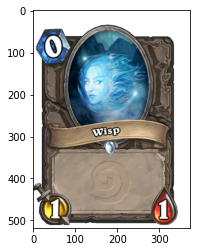

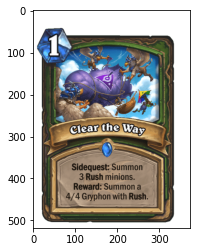

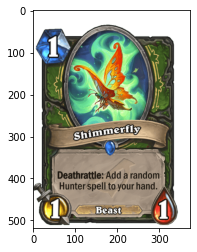

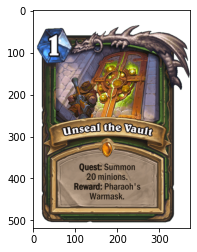

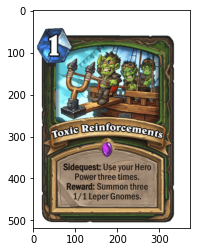

...

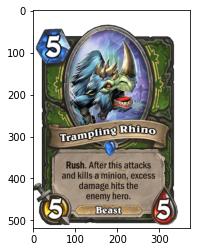

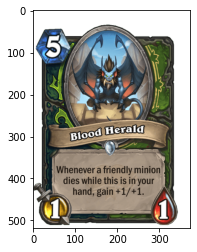

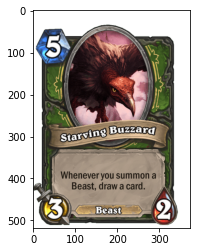

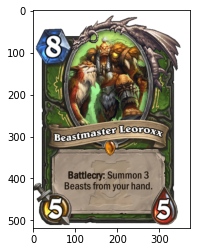

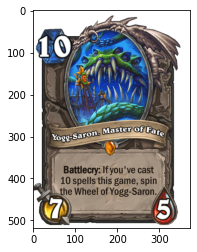

In [20]:
from PIL import Image
import requests
from io import BytesIO

readable_array = []

for final_deck in final_decks:
    show_decks = [int(a) for a in final_deck]
    readable = vector_to_deck(show_decks, new_cards)
    readable = groupby_cost(readable)
    readable_array.append(readable)

print("Neutral Card % in new_cards: ", (len(sort_by_class('Neutral',new_cards))/len(new_cards)))
print("Neutral Card % in created_deck: ", (len(sort_by_class('Neutral',readable))/len(readable)))

for read in readable_array:
    for card in read:
        response = requests.get(card['img'])
        img = Image.open(BytesIO(response.content)) 
        plt.figure()
        plt.imshow(img)
        plt.show()

{0: 1, 1: 13, 2: 5, 3: 6, 4: 2, 5: 0, 6: 3, 7: 0, 8: 0, 9: 0, 10: 0}
{0: 0, 1: 8, 2: 8, 3: 4, 4: 5, 5: 2, 6: 3, 7: 0, 8: 0, 9: 0, 10: 0}
{0: 0, 1: 7, 2: 9, 3: 8, 4: 2, 5: 0, 6: 0, 7: 1, 8: 0, 9: 1, 10: 2}
{0: 0, 1: 10, 2: 10, 3: 5, 4: 0, 5: 3, 6: 0, 7: 0, 8: 1, 9: 0, 10: 1}


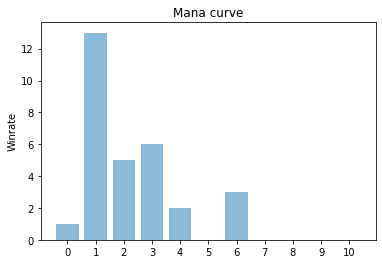

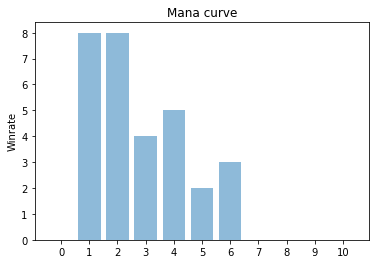

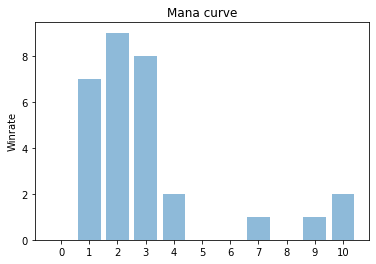

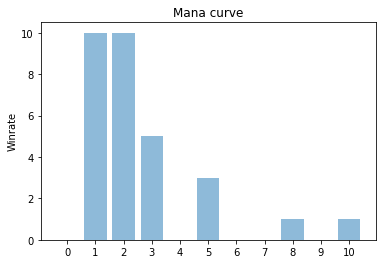

In [87]:
mana_curve_array = []
for deck in readable_array:
    mana_curve = {0:0,1:0,2:0,3:0,4:0,5:0,6:0,7:0,8:0,9:0,10:0}
    for i in range(len(deck)):
        #print(deck[i]['cost'])
        if deck[i]['cost'] in mana_curve:
           # print(mana_curve)
            mana_curve[deck[i]['cost']] += 1
           # to_add = mana_curve[i] +1
        else:
            mana_curve[deck[i]['cost']] = 1
    mana_curve_array.append(mana_curve)
    print(mana_curve)
    
for mana_curve in mana_curve_array:
    performance = []
    for i in range(len(mana_curve)):
        performance.append(mana_curve[i])
        # print(len(deck[i]))
    y_pos = np.arange(len(mana_curve))
    plt.bar(y_pos, performance, align="center", alpha=0.5)
    plt.xticks(y_pos, [0,1,2,3,4,5,6,7,8,9,10])
    plt.ylabel('Winrate')
    plt.title('Mana curve')
    plt.show()

In [21]:
def convert_to_simulator(deck):
    converted_deck = []
    for card in deck:
        converted_deck.append(card['cardId'])
    return converted_deck

def convert_array_to_simulator(decks):
    converted_decks = []
    for deck in decks:
        converted_deck = []
        for card in deck:
            converted_deck.append(card['cardId'])
        converted_decks.append(converted_deck)
    return converted_decks

def get_real_sample(class_):
    print("Sampling a",class_, "deck from dataset")
    deck_list = read_json_decks('data_'+class_+'.json')
    d = random.sample(deck_list,1)
    d = convert_to_simulator(d[0])
    return d, class_

enemy_deck, enemy_class = get_real_sample(random.choice(classes))
print(enemy_deck)

#fireplace_deck = ['YOP_015', 'YOP_013', 'YOP_013', 'BT_233', 'DRG_239', 'BT_722', 'CS2_104', 'DAL_759', 'CS2_104', 'DMF_189', 'ULD_309', 'BT_781', 'DRG_025', 'EX1_084', 'DMF_530', 'YOD_024', 'SCH_521', 'BT_140', 'SCH_317', 'DRG_020', 'DRG_022', 'EX1_507', 'EX1_020', 'YOP_005', 'BT_190', 'DMF_528', 'ULD_707', 'ULD_253', 'SCH_337', 'DAL_059']
fireplace_decks = convert_array_to_simulator(readable_array)
print(len(fireplace_decks))

Sampling a Rogue deck from dataset
['CS2_072', 'CS2_072', 'EX1_144', 'EX1_144', 'DRG_030', 'DRG_030', 'CS2_075', 'CS2_075', 'EX1_124', 'EX1_124', 'EX1_581', 'EX1_129', 'EX1_129', 'DRG_247', 'DRG_247', 'EX1_613', 'DRG_027', 'CS2_076', 'DRG_033', 'DRG_037', 'DAL_417', 'DRG_610', 'DRG_050', 'DRG_050', 'EX1_043', 'EX1_043', 'DRG_242', 'DRG_242', 'DRG_099', 'EX1_563']
4


In [22]:
#save current directory so we can navigate back after imports

import os

os.chdir('/home/hart/Documents/RGUProjects/Honours/')

curr_dir = os.getcwd()


In [23]:
#can't get it to run on separate file so I will leave it here
#need to change functions to accomodate opponents class and concat everything into a chart with percentages

import os
import sys
import importlib

importlib.reload(os)

os.chdir('/home/hart/Documents/RGUProjects/Honours/fireplace/tests')

import full_game
import utils_fireplace

importlib.reload(full_game)
importlib.reload(utils_fireplace)


def run_sim(file, args, num):
    results = []
    for i in range(num):
        script_descriptor = open(file)
        a_script = script_descriptor.read()
        sys.argv = args
        exec(a_script)
        result = open("results.txt", 'r')
        line = result.readline()
        print(line)
        line = line.strip('\n')
        results.append(line)
    print(results)
    return results

def run_sim_with_exec(file, args, num, enemy_class):
    results = []
    print("Running Generated deck against a", enemy_class, "\n", enemy_deck)
    for i in range(num):
        script_descriptor = open(file)
        a_script = script_descriptor.read()
        sys.argv = args
        exec(a_script)        
        result = open("results.txt", 'r')
        line = result.readline()
        print(line)
        line = line.strip('\n')
        results.append(line)
    return results

import time

def sim_evaluation(classes, fireplace_deck, name, choice):
    start_time = time.time()
    results = []
    print(len(fireplace_decks))
    for class_ in classes:
        class_result = []
        for fireplace_deck in fireplace_decks:
            os.chdir(curr_dir)
            enemy_deck, enemy_class = get_real_sample(class_)
            os.chdir(curr_dir+'/fireplace/tests')
            try:
                class_result.append(run_sim_with_exec("full_game.py", [choice, fireplace_deck, name, enemy_deck, enemy_class], 10, enemy_class)) #random.choice(classes)
            except:
                print("Error")
        results.append(class_result)
    print("--- %s seconds ---" % (time.time() - start_time))
    os.chdir(curr_dir)
    return results


#os.chdir('/home/hart/Documents/RGUProjects/Honours/')

#os.chdir('/home/hart/Documents/RGUProjects/Honours/')



In [24]:
import sys
original = sys.stdout 

In [25]:
import logging
import fireplace.logging
fireplace.logging.get_logger("fireplace", logging.CRITICAL)
sys.stdout = open('file', 'w')

final_results = []
try:
    results = sim_evaluation(classes, fireplace_decks, "Jamie", choice);
    for result in results:
        final_results.append(result)
except: 
    print("problem")

[['PlayState.LOST', 'PlayState.WON', 'PlayState.WON', 'PlayState.WON', 'PlayState.WON', 'PlayState.WON', 'PlayState.WON', 'PlayState.WON', 'PlayState.LOST', 'PlayState.LOST'], ['PlayState.WON', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST'], ['PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.WON', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.WON']]
Class Result for  Warrior
Number of Wins: 7
Number of Losses: 3
Winrate: 0.7
Number of Wins: 1
Number of Losses: 9
Winrate: 0.1
Number of Wins: 2
Number of Losses: 8
Winrate: 0.2
Class Result for  Mage
Number of Wins: 4
Number of Losses: 6
Winrate: 0.4
Number of Wins: 5
Number of Losses: 5
Winrate: 0.5
Number of Wins: 3
Number of Losses: 7
Winrate: 0.3
Number of Wins: 7
Number of Losses: 3
Winrate: 0.7
Class Result for  Hunter
Number of Wins: 4
Number of Loss

In [27]:
sys.stdout = original
print(results[0])
i=0
#Try against random decks and try creating random decks
best = []
all_scores = []
for class_result in final_results:
    best_score = 0
    best_result = []
    print("Class Result for ", classes[i])
    for result in class_result:
        win = 0
        loss = 0
        for score in result:
            if score == "PlayState.WON":
                win+=1
            else:
                loss += 1
        print("Number of Wins:", win)
        print("Number of Losses:", loss)
        print("Winrate:", win/(win+loss))
        
        if best_score < (win/(win+loss)):
            best_score = win/(win+loss)
            best_result = fireplace_decks[class_result.index(result)]
                          
    best.append([best_result, best_score, classes[i]])
    i+=1
print(best)

[['PlayState.LOST', 'PlayState.WON', 'PlayState.WON', 'PlayState.WON', 'PlayState.WON', 'PlayState.WON', 'PlayState.WON', 'PlayState.WON', 'PlayState.LOST', 'PlayState.LOST'], ['PlayState.WON', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST'], ['PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.WON', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.LOST', 'PlayState.WON']]
Class Result for  Warrior
Number of Wins: 7
Number of Losses: 3
Winrate: 0.7
Number of Wins: 1
Number of Losses: 9
Winrate: 0.1
Number of Wins: 2
Number of Losses: 8
Winrate: 0.2
Class Result for  Mage
Number of Wins: 4
Number of Losses: 6
Winrate: 0.4
Number of Wins: 5
Number of Losses: 5
Winrate: 0.5
Number of Wins: 3
Number of Losses: 7
Winrate: 0.3
Number of Wins: 7
Number of Losses: 3
Winrate: 0.7
Class Result for  Hunter
Number of Wins: 4
Number of Loss

In [93]:
deck = {}
for class_result in final_results:      
    for i in range(len(class_result)):
        if(i in deck):
            to_add = deck[i]
        else:
            deck[i] = []
            to_add = deck[i]
        #print(class_result[i])
        win = 0
        loss = 0
        curr_deck = []
        for k in range(len(class_result[i])): #every result of deck
            if class_result[i][k] == "PlayState.WON":
                win += 1
            else:
                loss += 1  
        print("Deck", i, ":", win/(win+loss))
        curr_deck = win/(win+loss)
        to_add.append(curr_deck)
        #to_add = deck[i]
        deck[i] = to_add
        
print(deck)

Deck 0 : 0.7
Deck 1 : 0.1
Deck 2 : 0.2
Deck 0 : 0.4
Deck 1 : 0.5
Deck 2 : 0.3
Deck 3 : 0.7
Deck 0 : 0.4
Deck 1 : 0.5
Deck 2 : 0.0
Deck 3 : 0.4
Deck 0 : 0.1
Deck 1 : 0.5
Deck 2 : 0.9
Deck 3 : 0.1
Deck 0 : 1.0
Deck 1 : 0.2
Deck 2 : 0.4
Deck 3 : 0.9
Deck 0 : 0.8
Deck 1 : 0.8
Deck 2 : 0.9
Deck 0 : 0.8
Deck 1 : 0.3
Deck 2 : 0.6
Deck 3 : 0.4
Deck 0 : 0.4
Deck 1 : 0.4
Deck 2 : 0.6
Deck 0 : 0.4
Deck 1 : 0.1
Deck 2 : 0.1
Deck 3 : 0.3
Deck 0 : 0.5
Deck 1 : 0.4
Deck 2 : 1.0
Deck 3 : 0.2
{0: [0.7, 0.4, 0.4, 0.1, 1.0, 0.8, 0.8, 0.4, 0.4, 0.5], 1: [0.1, 0.5, 0.5, 0.5, 0.2, 0.8, 0.3, 0.4, 0.1, 0.4], 2: [0.2, 0.3, 0.0, 0.9, 0.4, 0.9, 0.6, 0.6, 0.1, 1.0], 3: [0.7, 0.4, 0.1, 0.9, 0.4, 0.3, 0.2]}


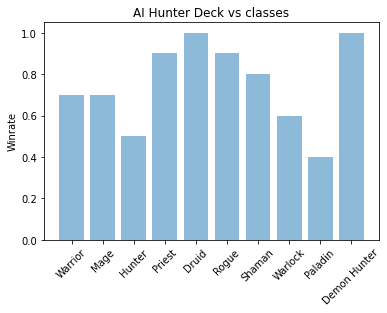

In [28]:
import numpy as np
import matplotlib.pyplot as plt

performance = []
#number of decks of each class
for result in best:
    performance.append(result[1])

y_pos = np.arange(len(best))
plt.bar(y_pos, performance, align="center", alpha=0.5)
plt.xticks(y_pos, classes, rotation = 45)
plt.ylabel('Winrate')
plt.title('AI '+choice+' Deck vs classes')
plt.show()

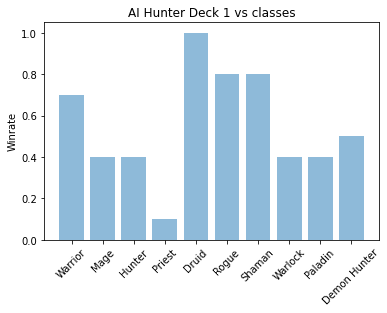

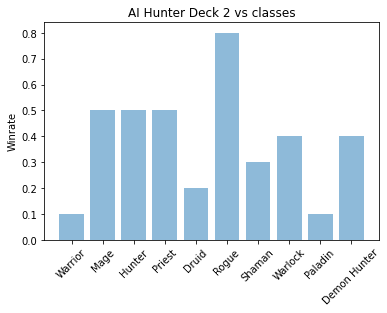

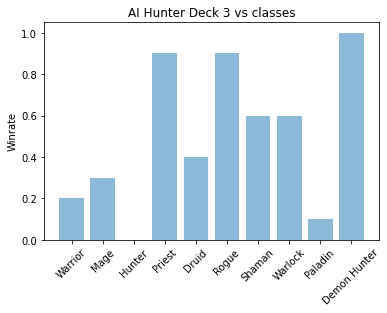

In [68]:
import numpy as np
import matplotlib.pyplot as plt

performance = []
#number of decks of each class
for i in range(len(deck)):
    performance = []
    for result in deck[i]:
        performance.append(result)
   # print(len(deck[i]))
    if(len(deck[i]) == 10):
        y_pos = np.arange(len(deck[i]))
        plt.bar(y_pos, performance, align="center", alpha=0.5)
        plt.xticks(y_pos, classes, rotation = 45)
        plt.ylabel('Winrate')
        plt.title('AI '+choice+' Deck '+ str(i+1) +' vs classes')
        plt.show()
    
    

0.55
0.38
0.5
0.42857142857142855
[0 1 2 3]


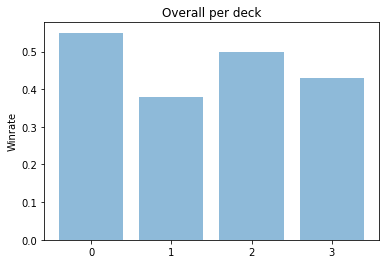

In [129]:

#overall win rate
#random
performance = []
for i in range(len(deck)):
    number = 0
    for result in deck[i]:
        number += result
    print(number/len(deck[i]))
    performance.append(number/len(deck[i]))
    
y_pos = np.arange(len(deck))
print(y_pos)
plt.bar(y_pos, performance, align="center", alpha=0.5)
plt.xticks(y_pos)
plt.ylabel('Winrate')
plt.title('Overall per deck')
plt.show()
    